In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [4]:
import tensorflow as tf
from tensorflow.keras import layers, Model

from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback
import time
from tensorflow.keras.utils import plot_model
import numpy as np
from sklearn.model_selection import KFold
import os
import glob

In [5]:
import os
import tensorflow as tf
import numpy as np
import glob

BASE_PATH = "/kaggle/input/dataset/new_data"

# Define folders for train, validation, and test
TRAIN_IMAGES_DIR = os.path.join(BASE_PATH, "train", "images")
TRAIN_MASKS_DIR = os.path.join(BASE_PATH, "train", "GT_TE")

VAL_IMAGES_DIR = os.path.join(BASE_PATH, "valid", "images")
VAL_MASKS_DIR = os.path.join(BASE_PATH, "valid", "GT_TE")

TEST_IMAGES_DIR = os.path.join(BASE_PATH, "test", "images")
TEST_MASKS_DIR = os.path.join(BASE_PATH, "test", "GT_TE")

# Check if files are loaded correctly
print("Train images:", len(os.listdir(TRAIN_IMAGES_DIR)))
print("Train masks:", len(os.listdir(TRAIN_MASKS_DIR)))
print("Validation images:", len(os.listdir(VAL_IMAGES_DIR)))
print("Validation masks:", len(os.listdir(VAL_MASKS_DIR)))
print("Test images:", len(os.listdir(TEST_IMAGES_DIR)))
print("Test masks:", len(os.listdir(TEST_MASKS_DIR)))

IMG_HEIGHT = 256
IMG_WIDTH = 256


def load_image(image_path, mask_path):
    """Load and preprocess a single image-mask pair"""
    # Load image
    image = tf.io.read_file(image_path)
    image = tf.image.decode_bmp(image, channels=3)  # decode as RGB
    image = tf.image.rgb_to_grayscale(image)        # convert to grayscale
    image = tf.image.resize(image, [IMG_HEIGHT, IMG_WIDTH])
    image = tf.cast(image, tf.float32) / 255.0

    # Load mask
    mask = tf.io.read_file(mask_path)
    mask = tf.image.decode_bmp(mask, channels=3)
    mask = tf.image.rgb_to_grayscale(mask)
    mask = tf.image.resize(mask, [IMG_HEIGHT, IMG_WIDTH])
    mask = tf.cast(mask, tf.float32) / 255.0
    mask = tf.where(mask > 0.5, 1.0, 0.0)  # binarize

    return image, mask


def create_dataset(image_dir, mask_dir, batch_size=8, shuffle=True):
    """Create tf.data dataset for training, validation, or testing"""
    image_paths = sorted(glob.glob(os.path.join(image_dir, "*.bmp")))
    mask_paths = sorted(glob.glob(os.path.join(mask_dir, "*.bmp")))

    print(f"Found {len(image_paths)} images and {len(mask_paths)} masks in {image_dir}")

    dataset = tf.data.Dataset.from_tensor_slices((image_paths, mask_paths))
    dataset = dataset.map(load_image, num_parallel_calls=tf.data.AUTOTUNE)

    if shuffle:
        dataset = dataset.shuffle(buffer_size=100)

    return dataset.batch(batch_size).prefetch(tf.data.AUTOTUNE)



BATCH_SIZE = 16
train_dataset = create_dataset(TRAIN_IMAGES_DIR, TRAIN_MASKS_DIR, batch_size=BATCH_SIZE)
val_dataset = create_dataset(VAL_IMAGES_DIR, VAL_MASKS_DIR, batch_size=BATCH_SIZE, shuffle=False)
test_dataset = create_dataset(TEST_IMAGES_DIR, TEST_MASKS_DIR, batch_size=1, shuffle=False)


Train images: 995
Train masks: 995
Validation images: 25
Validation masks: 25
Test images: 25
Test masks: 25
Found 995 images and 995 masks in /kaggle/input/dataset/new_data/train/images
Found 25 images and 25 masks in /kaggle/input/dataset/new_data/valid/images
Found 25 images and 25 masks in /kaggle/input/dataset/new_data/test/images


In [6]:
# ------------------ IEA Block ------------------
class EAblock(layers.Layer):
    def __init__(self, channels, name=None):
        super(EAblock, self).__init__(name=name)
        self.channels = channels
        self.expand_channels = channels * 4

        # 1x1 Conv before attention
        self.conv1 = layers.Conv2D(channels, kernel_size=1, padding='same', activation=None)
        # Memory unit 1: expand
        self.linear_0 = layers.Conv1D(self.expand_channels, kernel_size=1, use_bias=False)
        # Memory unit 2: compress
        self.linear_1 = layers.Conv1D(channels, kernel_size=1, use_bias=False)
        # 1x1 Conv after attention
        self.conv2 = layers.Conv2D(channels, kernel_size=1, padding='same', activation=None)
        # Normalization
        self.norm = layers.LayerNormalization(axis=-1)
        # Activation
        self.act = layers.Activation('gelu')

    def call(self, x):
        # Save residual
        identity = x

        # 1x1 conv
        x = self.conv1(x)

        # Flatten spatial dimensions: B, H*W, C
        b, h, w, c = tf.shape(x)[0], tf.shape(x)[1], tf.shape(x)[2], tf.shape(x)[3]
        x_flat = tf.reshape(x, [b, h*w, c])  # shape: (B, HW, C)

        # Memory Unit 1: expand channels
        attn = self.linear_0(x_flat)          # (B, HW, 4C)
        attn = tf.nn.softmax(attn, axis=-1)
        attn = attn / (1e-9 + tf.reduce_sum(attn, axis=-1, keepdims=True))

        # Memory Unit 2: compress back
        x_flat = self.linear_1(attn)          # (B, HW, C)

        # Reshape back to (B, H, W, C)
        x = tf.reshape(x_flat, [b, h, w, c])

        # 1x1 conv + normalization
        x = self.conv2(x)
        x = self.norm(x)

        # Add residual + activation
        x = x + identity
        x = self.act(x)

        return x


In [7]:
from tensorflow.keras import layers, models

# ------------------ UNet with EAblock in encoder4-6, decoder1-3 ------------------
def unet_with_iea(input_shape=(256,256,1)):
    inputs = layers.Input(input_shape, name="input_layer")

    # ----- Encoder -----
    c1 = layers.Conv2D(64, 3, activation='relu', padding='same', name="enc_c1a")(inputs)
    c1 = layers.Conv2D(64, 3, activation='relu', padding='same', name="enc_c1b")(c1)
    p1 = layers.MaxPooling2D((2, 2), name="pool1")(c1)

    c2 = layers.Conv2D(128, 3, activation='relu', padding='same', name="enc_c2a")(p1)
    c2 = layers.Conv2D(128, 3, activation='relu', padding='same', name="enc_c2b")(c2)
    p2 = layers.MaxPooling2D((2, 2), name="pool2")(c2)

    c3 = layers.Conv2D(256, 3, activation='relu', padding='same', name="enc_c3a")(p2)
    c3 = layers.Conv2D(256, 3, activation='relu', padding='same', name="enc_c3b")(c3)
    p3 = layers.MaxPooling2D((2, 2), name="pool3")(c3)

    # Encoder 4-6 with EAblock
    c4 = layers.Conv2D(512, 3, activation='relu', padding='same', name="enc_c4a")(p3)
    c4 = layers.Conv2D(512, 3, activation='relu', padding='same', name="enc_c4b")(c4)
    c4 = EAblock(512, name="e_ablock_enc4")(c4)
    p4 = layers.MaxPooling2D((2, 2), name="pool4")(c4)

    c5 = layers.Conv2D(1024, 3, activation='relu', padding='same', name="enc_c5a")(p4)
    c5 = layers.Conv2D(1024, 3, activation='relu', padding='same', name="enc_c5b")(c5)
    c5 = EAblock(1024, name="e_ablock_enc5")(c5)
    p5 = layers.MaxPooling2D((2, 2), name="pool5")(c5)

    c6 = layers.Conv2D(1024, 3, activation='relu', padding='same', name="enc_c6a")(p5)
    c6 = layers.Conv2D(1024, 3, activation='relu', padding='same', name="enc_c6b")(c6)
    c6 = EAblock(1024, name="e_ablock_enc6")(c6)

    # ----- Decoder 1-3 with EAblock -----
    u7 = layers.Conv2DTranspose(1024, 2, strides=(2,2), padding='same', name="up7")(c6)
    u7 = layers.concatenate([u7, c5], axis=3, name="concat7")
    c7 = layers.Conv2D(1024, 3, activation='relu', padding='same', name="dec_c7a")(u7)
    c7 = layers.Conv2D(1024, 3, activation='relu', padding='same', name="dec_c7b")(c7)
    c7 = EAblock(1024, name="e_ablock_enc7")(c7)

    u8 = layers.Conv2DTranspose(512, 2, strides=(2,2), padding='same', name="up8")(c7)
    u8 = layers.concatenate([u8, c4], axis=3, name="concat8")
    c8 = layers.Conv2D(512, 3, activation='relu', padding='same', name="dec_c8a")(u8)
    c8 = layers.Conv2D(512, 3, activation='relu', padding='same', name="dec_c8b")(c8)
    c8 = EAblock(512, name="e_ablock_enc8")(c8)

    u9 = layers.Conv2DTranspose(256, 2, strides=(2,2), padding='same', name="up9")(c8)
    u9 = layers.concatenate([u9, c3], axis=3, name="concat9")
    c9 = layers.Conv2D(256, 3, activation='relu', padding='same', name="dec_c9a")(u9)
    c9 = layers.Conv2D(256, 3, activation='relu', padding='same', name="dec_c9b")(c9)
    c9 = EAblock(256, name="e_ablock_enc9")(c9)

    # ----- Decoder 4-5 -----
    u10 = layers.Conv2DTranspose(128, 2, strides=(2,2), padding='same', name="up10")(c9)
    u10 = layers.concatenate([u10, c2], axis=3, name="concat10")
    c10 = layers.Conv2D(128, 3, activation='relu', padding='same', name="dec_c10a")(u10)
    c10 = layers.Conv2D(128, 3, activation='relu', padding='same', name="dec_c10b")(c10)

    u11 = layers.Conv2DTranspose(64, 2, strides=(2,2), padding='same', name="up11")(c10)
    u11 = layers.concatenate([u11, c1], axis=3, name="concat11")
    c11 = layers.Conv2D(64, 3, activation='relu', padding='same', name="dec_c11a")(u11)
    c11 = layers.Conv2D(64, 3, activation='relu', padding='same', name="dec_c11b")(c11)

    outputs = layers.Conv2D(1, 1, activation='sigmoid', name="output_layer")(c11)

    model = models.Model(inputs=inputs, outputs=outputs, name="UNet_with_IEA")
    return model

# ---------------- Test ----------------
model = unet_with_iea(input_shape=(256,256,1))
model.summary()


Model: "UNet_with_IEA"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ e_ablock_enc4       │ (None, 32, 32,    │  2,623,488 │ enc_c4b[0][0]     │
│ (EAblock)           │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ e_ablock_enc4[0]… │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c5a (Conv2D)    │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c5b (Conv2D)    │ (None, 16, 16,    │  9,438,208 │ enc_c5a[0][0]     │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ e_ablock_enc5       │ (None, 16, 16,    │ 10,489,856 │ enc_c5b[0][0]   

 Total params: 119,788,865 (456.96 MB)

 Trainable params: 119,788,865 (456.96 MB)

 Non-trainable params: 0 (0.00 B)

In [8]:
for i, layer in enumerate(model.layers):
    print(i, layer.name)


0 input_layer
1 enc_c1a
2 enc_c1b
3 pool1
4 enc_c2a
5 enc_c2b
6 pool2
7 enc_c3a
8 enc_c3b
9 pool3
10 enc_c4a
11 enc_c4b
12 e_ablock_enc4
13 pool4
14 enc_c5a
15 enc_c5b
16 e_ablock_enc5
17 pool5
18 enc_c6a
19 enc_c6b
20 e_ablock_enc6
21 up7
22 concat7
23 dec_c7a
24 dec_c7b
25 e_ablock_enc7
26 up8
27 concat8
28 dec_c8a
29 dec_c8b
30 e_ablock_enc8
31 up9
32 concat9
33 dec_c9a
34 dec_c9b
35 e_ablock_enc9
36 up10
37 concat10
38 dec_c10a
39 dec_c10b
40 up11
41 concat11
42 dec_c11a
43 dec_c11b
44 output_layer


In [10]:
def dice_coefficient(y_true, y_pred, smooth=1e-6):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)

def iou_metric(y_true, y_pred, smooth=1e-6):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    union = tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) - intersection
    return (intersection + smooth) / (union + smooth)

def bce_dice_loss(y_true, y_pred):
    bce = tf.keras.losses.BinaryCrossentropy()(y_true, y_pred)
    dice_loss = 1 - dice_coefficient(y_true, y_pred)
    return bce + dice_loss

In [11]:
# -------------------------
# Image loader
# -------------------------
def load_only_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_bmp(img, channels=3)   # decode as RGB
    img = tf.image.resize(img, [256, 256])
    img = tf.image.rgb_to_grayscale(img)         # convert to 1 channel
    img = tf.cast(img, tf.float32) / 255.0
    return img

def load_image(image_path, mask_path):
    img = load_only_image(image_path)
    mask = load_only_image(mask_path)
    return img, mask


In [12]:
# -------------------------
# Attention map visualizer callback
# -------------------------
class AttentionMapLogger(Callback):
    def __init__(self, sample_image, every_n_epochs=5, save_dir="attention_maps"):
        super().__init__()
        self.sample_image = tf.expand_dims(sample_image, axis=0)  # add batch dim
        self.every_n_epochs = every_n_epochs
        self.save_dir = save_dir
        os.makedirs(save_dir, exist_ok=True)

    def save_attention_maps(self, feature_maps, stage_name, epoch):
        # feature_maps: tensor of shape (1, H, W, C)
        fmap = feature_maps[0]  # remove batch
        fmap_mean = tf.reduce_mean(fmap, axis=-1)  # collapse channels -> (H,W)
        fmap_min = tf.reduce_min(fmap_mean)
        fmap_max = tf.reduce_max(fmap_mean)
        fmap_norm = (fmap_mean - fmap_min) / (fmap_max - fmap_min + 1e-6)

        plt.figure(figsize=(5,5))
        plt.imshow(fmap_norm, cmap='jet')
        plt.axis('off')
        plt.title(f"{stage_name} Epoch {epoch}")
        plt.savefig(os.path.join(self.save_dir, f"{stage_name}_epoch{epoch}.png"))
        plt.close()
    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.every_n_epochs != 0:
            return

        # Run the model on the sample image and fetch attention maps
        # Assumes your model returns a list of attention feature maps as second output
        # Or that you have a model subclass which exposes encoder/decoder feature maps
        attention_features = self.model.get_attention_features(self.sample_image)  # custom function

        for i, fmap in enumerate(attention_features):
            stage_name = f"stage_{i+1}"
            self.save_attention_maps(fmap, stage_name, epoch + 1)





In [14]:
import matplotlib.pyplot as plt
import time
from sklearn.model_selection import KFold
import numpy as np
import glob
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint


--- Fold 1 ---
Epoch 1/300


I0000 00:00:1758384187.641872      94 service.cc:148] XLA service 0x7ff628003810 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1758384187.642807      94 service.cc:156]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1758384189.700421      94 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1758384222.593327      94 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


 99/100 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step - accuracy: 0.8691 - dice_coefficient: 0.1788 - iou_metric: 0.0988 - loss: 1.3167

E0000 00:00:1758384262.536696      97 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758384262.793445      97 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 618ms/step - accuracy: 0.8692 - dice_coefficient: 0.1792 - iou_metric: 0.0991 - loss: 1.3151

E0000 00:00:1758384300.176987      95 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758384300.411718      95 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758384301.036073      95 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758384301.294270      95 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


100/100 ━━━━━━━━━━━━━━━━━━━━ 148s 916ms/step - accuracy: 0.8693 - dice_coefficient: 0.1796 - iou_metric: 0.0993 - loss: 1.3134 - val_accuracy: 0.8238 - val_dice_coefficient: 0.4072 - val_iou_metric: 0.2572 - val_loss: 0.8326
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 442ms/step - accuracy: 0.7972 - dice_coefficient: 0.5188 - iou_metric: 0.3548 - loss: 0.7167 - val_accuracy: 0.8376 - val_dice_coefficient: 0.5886 - val_iou_metric: 0.4186 - val_loss: 0.6002
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 45s 444ms/step - accuracy: 0.8326 - dice_coefficient: 0.6502 - iou_metric: 0.4837 - loss: 0.5470 - val_accuracy: 0.8494 - val_dice_coefficient: 0.6069 - val_iou_metric: 0.4386 - val_loss: 0.5573
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 443ms/step - accuracy: 0.8386 - dice_coefficient: 0.6862 - iou_metric: 0.5246 - loss: 0.4872 - val_accuracy: 0.8495 - val_dice_coefficient: 0.6781 - val_iou_metric: 0.5153 - val_loss: 0.4791
Epoch 5/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - accuracy: 

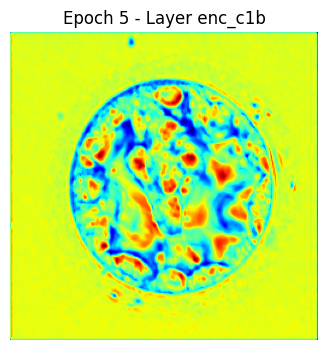

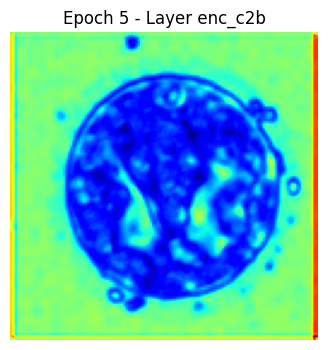

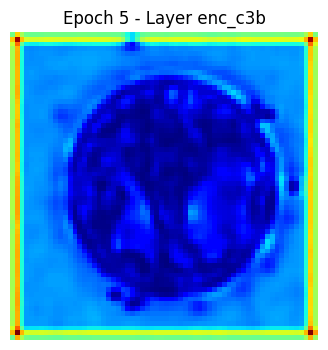

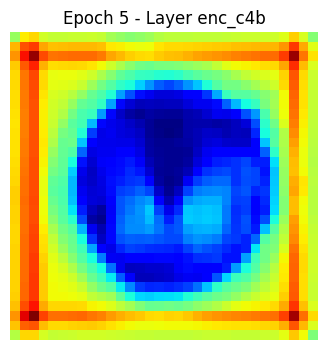

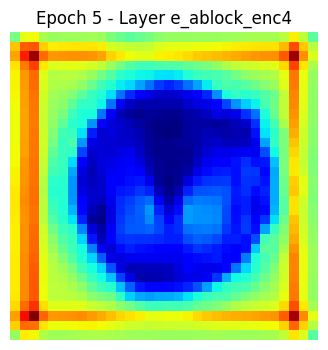

...

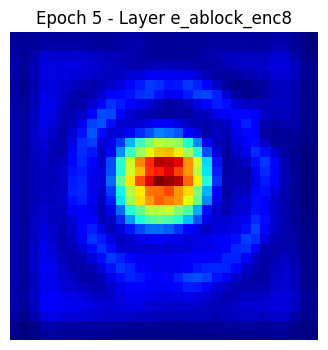

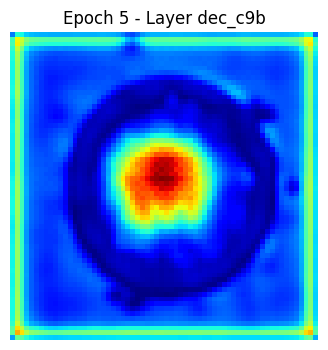

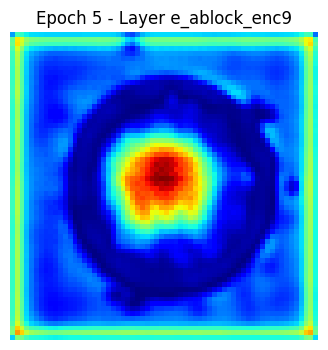

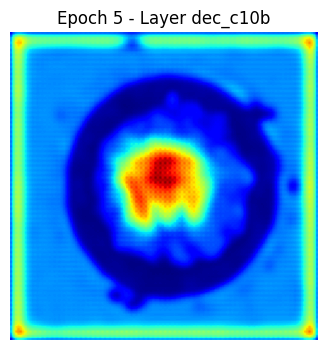

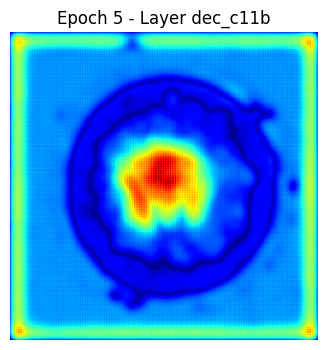

100/100 ━━━━━━━━━━━━━━━━━━━━ 48s 476ms/step - accuracy: 0.8401 - dice_coefficient: 0.7170 - iou_metric: 0.5596 - loss: 0.4479 - val_accuracy: 0.8492 - val_dice_coefficient: 0.6937 - val_iou_metric: 0.5331 - val_loss: 0.4532
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 441ms/step - accuracy: 0.8453 - dice_coefficient: 0.7408 - iou_metric: 0.5891 - loss: 0.4107 - val_accuracy: 0.8579 - val_dice_coefficient: 0.7089 - val_iou_metric: 0.5519 - val_loss: 0.4374
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 441ms/step - accuracy: 0.8468 - dice_coefficient: 0.7510 - iou_metric: 0.6021 - loss: 0.3907 - val_accuracy: 0.8556 - val_dice_coefficient: 0.7159 - val_iou_metric: 0.5602 - val_loss: 0.4261
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 441ms/step - accuracy: 0.8477 - dice_coefficient: 0.7617 - iou_metric: 0.6161 - loss: 0.3755 - val_accuracy: 0.8565 - val_dice_coefficient: 0.7480 - val_iou_metric: 0.6002 - val_loss: 0.3983
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 442ms/step - accuracy: 

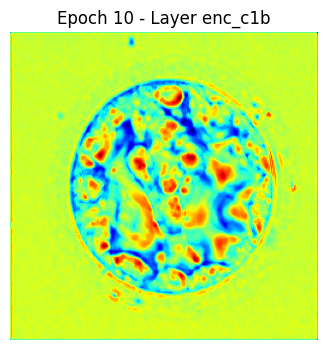

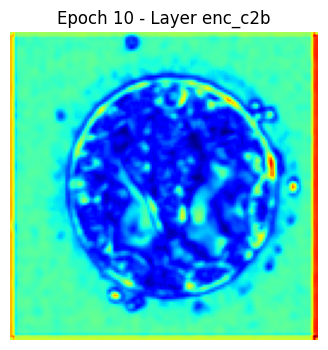

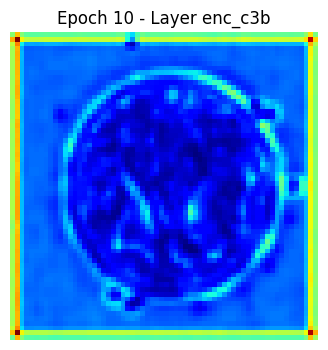

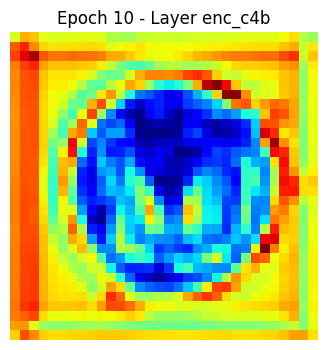

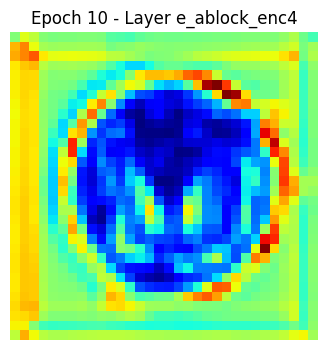

...

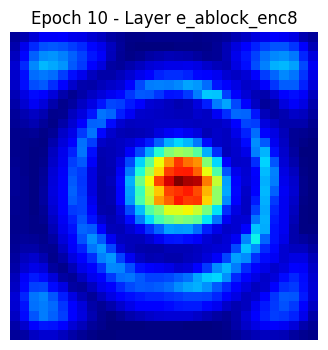

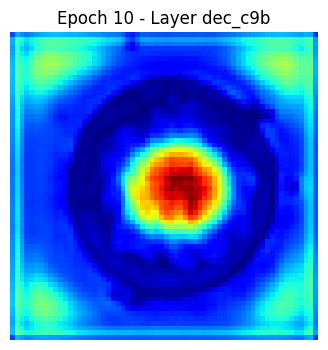

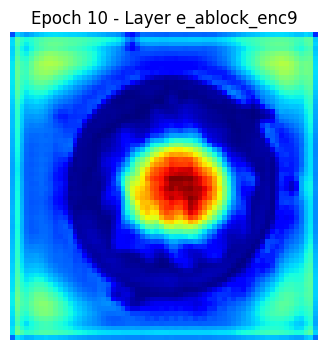

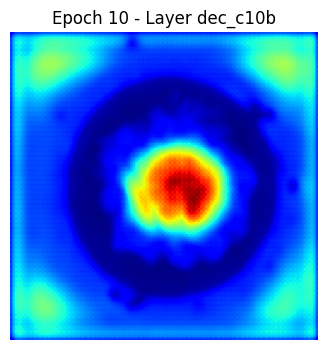

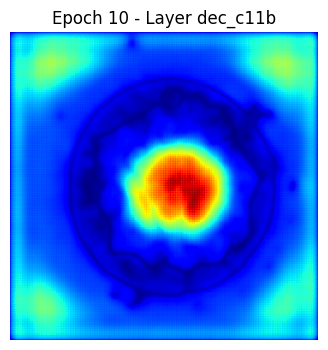

100/100 ━━━━━━━━━━━━━━━━━━━━ 42s 413ms/step - accuracy: 0.8499 - dice_coefficient: 0.7814 - iou_metric: 0.6420 - loss: 0.3471 - val_accuracy: 0.8607 - val_dice_coefficient: 0.7382 - val_iou_metric: 0.5876 - val_loss: 0.3867
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8521 - dice_coefficient: 0.7900 - iou_metric: 0.6535 - loss: 0.3326 - val_accuracy: 0.8616 - val_dice_coefficient: 0.7329 - val_iou_metric: 0.5808 - val_loss: 0.3898
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 441ms/step - accuracy: 0.8526 - dice_coefficient: 0.7882 - iou_metric: 0.6512 - loss: 0.3327 - val_accuracy: 0.8531 - val_dice_coefficient: 0.7651 - val_iou_metric: 0.6223 - val_loss: 0.3753
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 0.8522 - dice_coefficient: 0.7966 - iou_metric: 0.6628 - loss: 0.3233 - val_accuracy: 0.8590 - val_dice_coefficient: 0.7503 - val_iou_metric: 0.6032 - val_loss: 0.3772
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 42s 400ms/step - accura

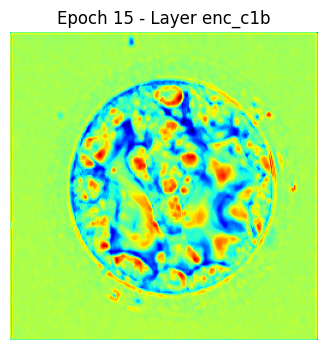

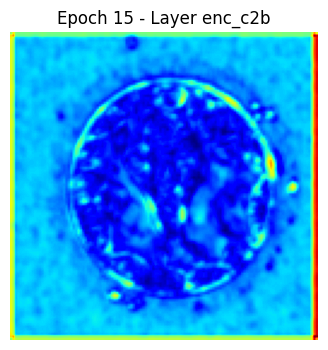

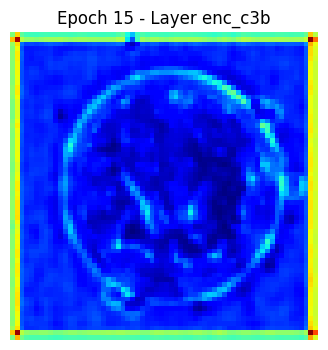

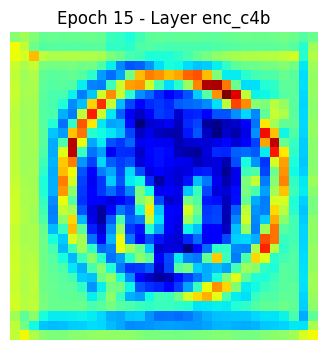

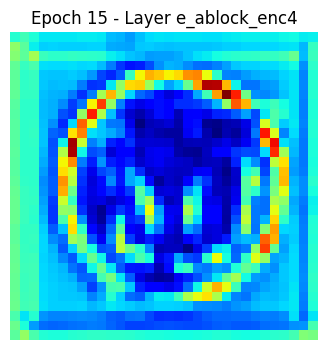

...

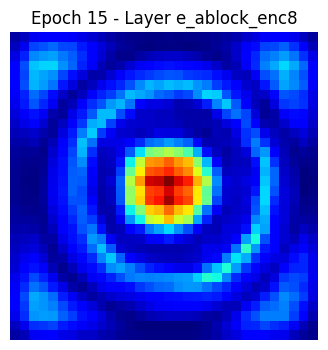

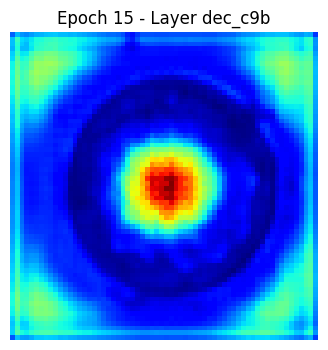

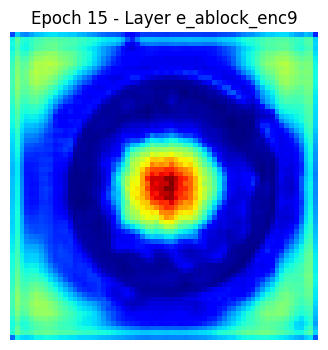

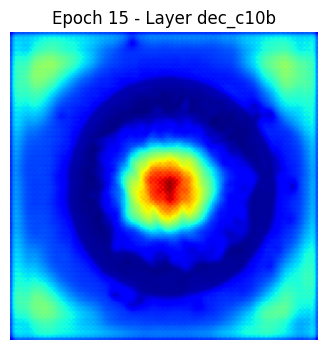

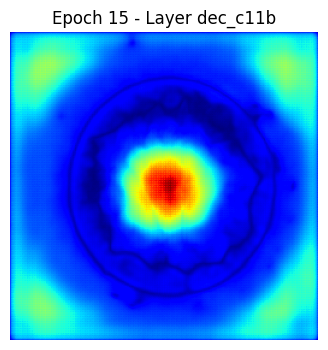

100/100 ━━━━━━━━━━━━━━━━━━━━ 46s 454ms/step - accuracy: 0.8550 - dice_coefficient: 0.8079 - iou_metric: 0.6785 - loss: 0.3039 - val_accuracy: 0.8559 - val_dice_coefficient: 0.7803 - val_iou_metric: 0.6428 - val_loss: 0.3558
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 45s 441ms/step - accuracy: 0.8552 - dice_coefficient: 0.8169 - iou_metric: 0.6913 - loss: 0.2926 - val_accuracy: 0.8571 - val_dice_coefficient: 0.7820 - val_iou_metric: 0.6451 - val_loss: 0.3525
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8565 - dice_coefficient: 0.8208 - iou_metric: 0.6968 - loss: 0.2862 - val_accuracy: 0.8574 - val_dice_coefficient: 0.7783 - val_iou_metric: 0.6402 - val_loss: 0.3550
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 442ms/step - accuracy: 0.8578 - dice_coefficient: 0.8258 - iou_metric: 0.7042 - loss: 0.2756 - val_accuracy: 0.8578 - val_dice_coefficient: 0.7954 - val_iou_metric: 0.6635 - val_loss: 0.3509
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accura

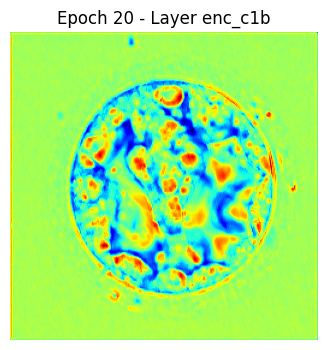

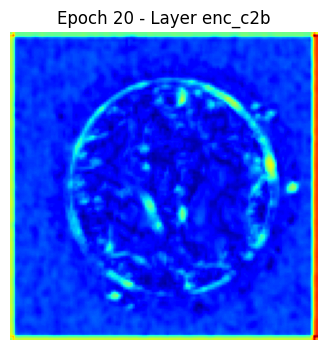

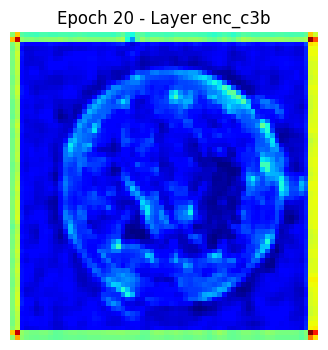

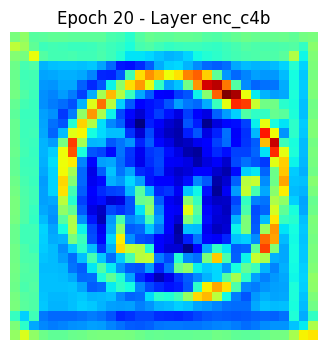

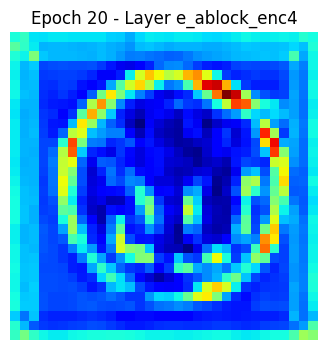

...

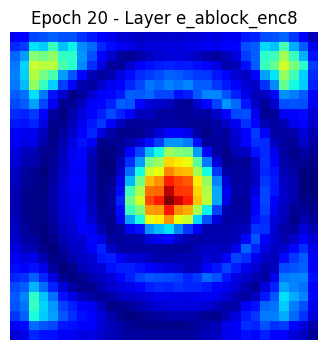

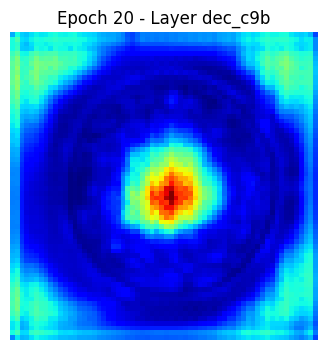

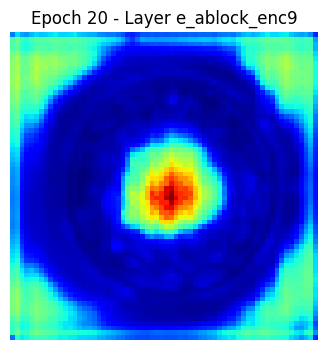

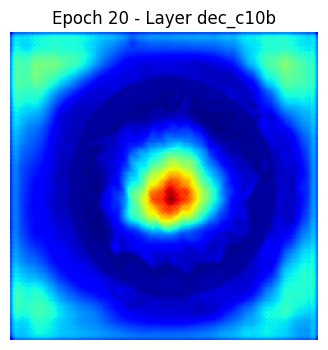

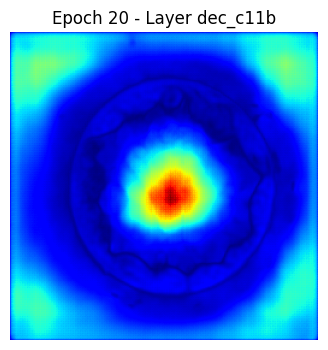

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 414ms/step - accuracy: 0.8591 - dice_coefficient: 0.8355 - iou_metric: 0.7180 - loss: 0.2619 - val_accuracy: 0.8563 - val_dice_coefficient: 0.7413 - val_iou_metric: 0.5910 - val_loss: 0.3851
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8585 - dice_coefficient: 0.8330 - iou_metric: 0.7146 - loss: 0.2651 - val_accuracy: 0.8605 - val_dice_coefficient: 0.7904 - val_iou_metric: 0.6563 - val_loss: 0.3479
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8617 - dice_coefficient: 0.8482 - iou_metric: 0.7375 - loss: 0.2428 - val_accuracy: 0.8517 - val_dice_coefficient: 0.7869 - val_iou_metric: 0.6516 - val_loss: 0.3733
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 442ms/step - accuracy: 0.8596 - dice_coefficient: 0.8476 - iou_metric: 0.7361 - loss: 0.2439 - val_accuracy: 0.8628 - val_dice_coefficient: 0.8038 - val_iou_metric: 0.6756 - val_loss: 0.3344
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accura

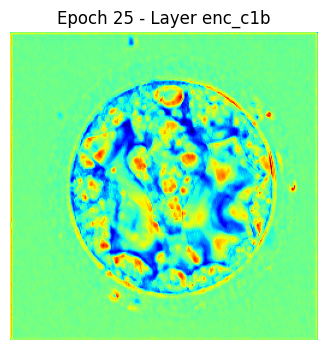

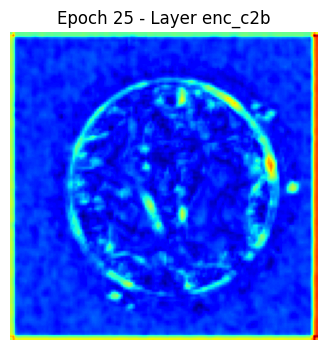

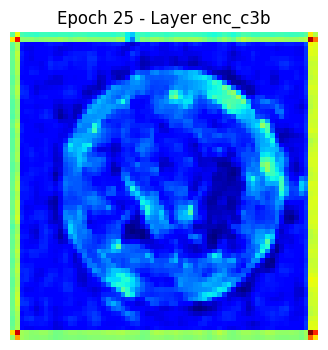

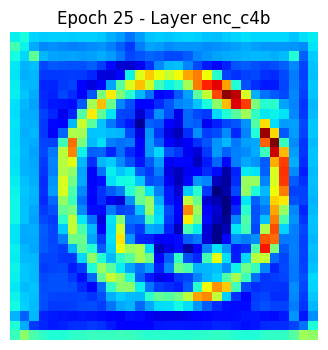

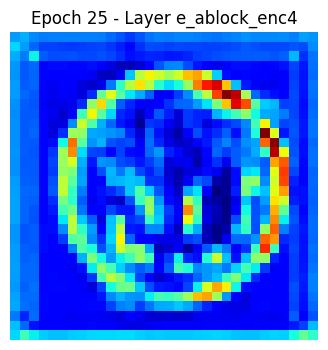

...

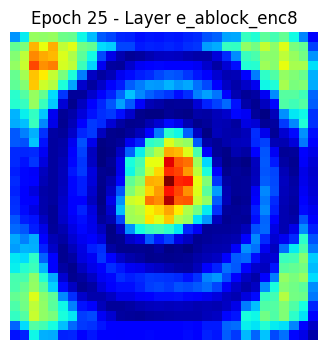

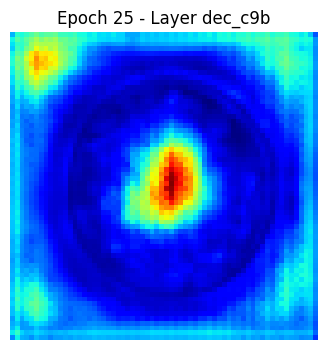

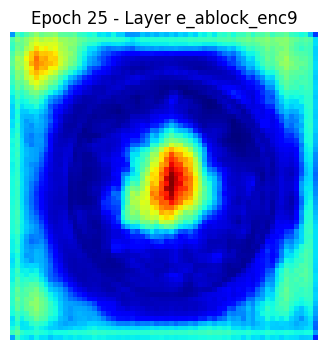

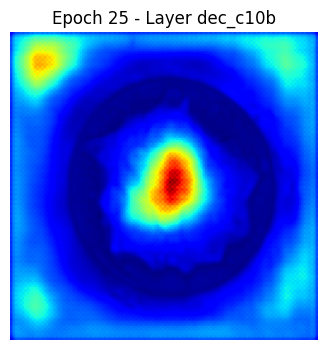

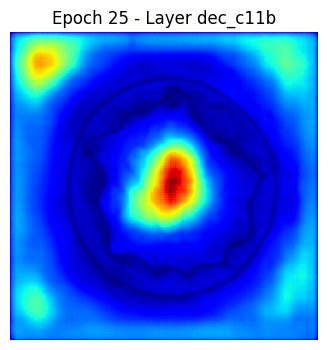

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 413ms/step - accuracy: 0.8631 - dice_coefficient: 0.8651 - iou_metric: 0.7629 - loss: 0.2161 - val_accuracy: 0.8594 - val_dice_coefficient: 0.7747 - val_iou_metric: 0.6349 - val_loss: 0.3683
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8633 - dice_coefficient: 0.8680 - iou_metric: 0.7673 - loss: 0.2105 - val_accuracy: 0.8624 - val_dice_coefficient: 0.7976 - val_iou_metric: 0.6665 - val_loss: 0.3256
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8640 - dice_coefficient: 0.8767 - iou_metric: 0.7810 - loss: 0.1981 - val_accuracy: 0.8577 - val_dice_coefficient: 0.7841 - val_iou_metric: 0.6474 - val_loss: 0.3662
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8642 - dice_coefficient: 0.8793 - iou_metric: 0.7851 - loss: 0.1935 - val_accuracy: 0.8666 - val_dice_coefficient: 0.7855 - val_iou_metric: 0.6501 - val_loss: 0.3561
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accura

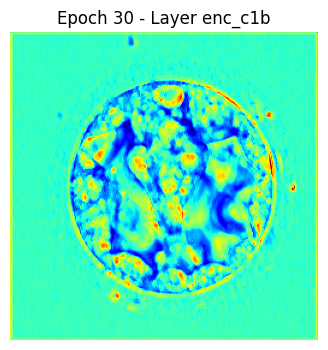

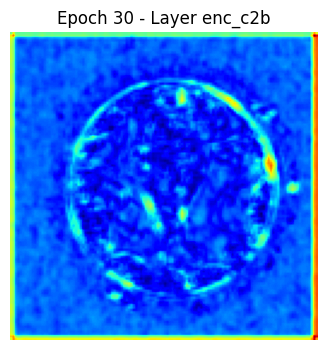

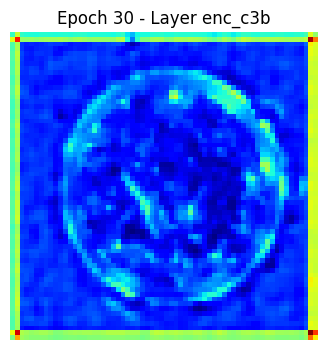

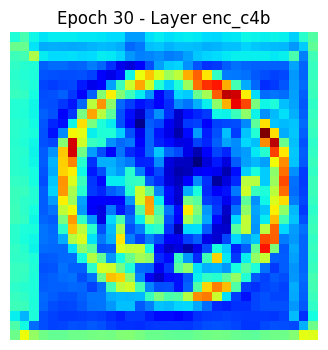

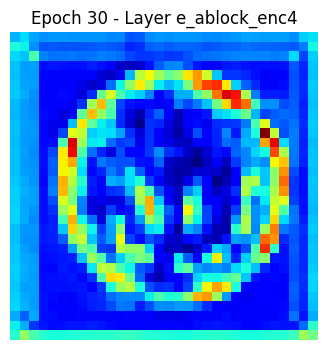

...

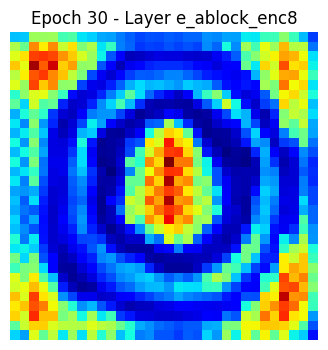

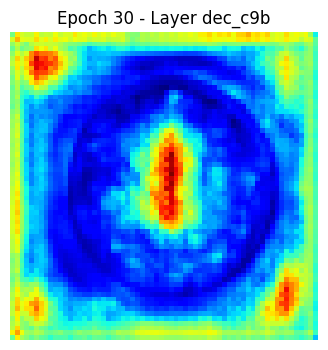

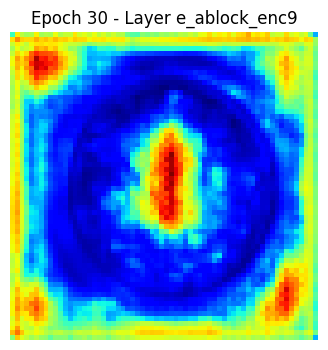

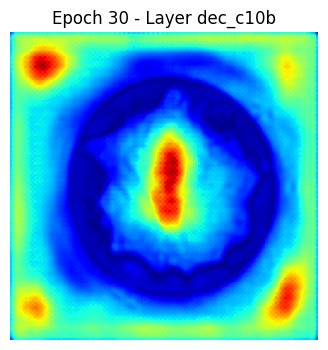

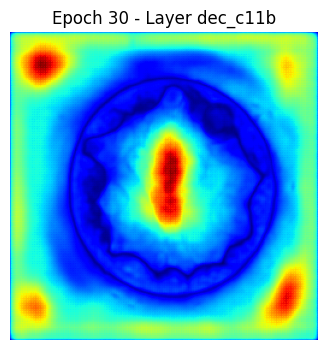

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 413ms/step - accuracy: 0.8654 - dice_coefficient: 0.8891 - iou_metric: 0.8008 - loss: 0.1779 - val_accuracy: 0.8653 - val_dice_coefficient: 0.7979 - val_iou_metric: 0.6669 - val_loss: 0.3421
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8668 - dice_coefficient: 0.8929 - iou_metric: 0.8069 - loss: 0.1713 - val_accuracy: 0.8624 - val_dice_coefficient: 0.7980 - val_iou_metric: 0.6671 - val_loss: 0.3624
Epoch 32/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8670 - dice_coefficient: 0.9007 - iou_metric: 0.8197 - loss: 0.1585 - val_accuracy: 0.8666 - val_dice_coefficient: 0.7979 - val_iou_metric: 0.6671 - val_loss: 0.3585
Epoch 33/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8675 - dice_coefficient: 0.9030 - iou_metric: 0.8235 - loss: 0.1550 - val_accuracy: 0.8671 - val_dice_coefficient: 0.7973 - val_iou_metric: 0.6664 - val_loss: 0.3605


Model: "UNet_with_IEA"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ e_ablock_enc4       │ (None, 32, 32,    │  2,623,488 │ enc_c4b[0][0]     │
│ (EAblock)           │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ e_ablock_enc4[0]… │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c5a (Conv2D)    │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c5b (Conv2D)    │ (None, 16, 16,    │  9,438,208 │ enc_c5a[0][0]     │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ e_ablock_enc5       │ (None, 16, 16,    │ 10,489,856 │ enc_c5b[0][0]   

 Total params: 359,366,597 (1.34 GB)

 Trainable params: 119,788,865 (456.96 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 239,577,732 (913.92 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 1: 1500.68s

--- Fold 2 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 93s 580ms/step - accuracy: 0.8741 - dice_coefficient: 0.1759 - iou_metric: 0.0970 - loss: 1.2935 - val_accuracy: 0.8097 - val_dice_coefficient: 0.4577 - val_iou_metric: 0.2977 - val_loss: 0.7824
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 0.7946 - dice_coefficient: 0.4952 - iou_metric: 0.3304 - loss: 0.7526 - val_accuracy: 0.8266 - val_dice_coefficient: 0.6212 - val_iou_metric: 0.4517 - val_loss: 0.5838
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8219 - dice_coefficient: 0.6072 - iou_metric: 0.4375 - loss: 0.6160 - val_accuracy: 0.8513 - val_dice_coefficient: 0.5898 - val_iou_metric: 0.4202 - val_loss: 0.5972
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 401ms/step - accuracy: 0.8306 - dice_coefficient: 0.6384 - iou_metric: 0.4700 - loss: 0.5645 - val_accuracy: 0.8480

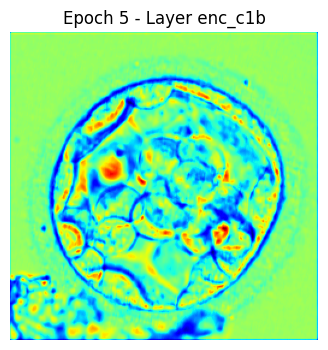

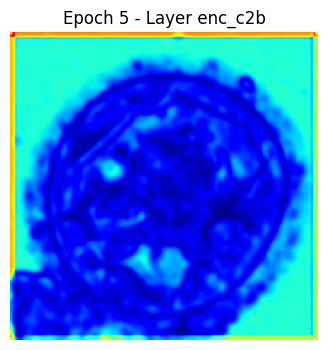

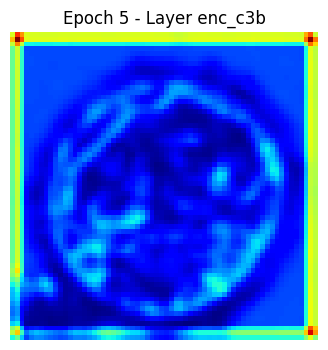

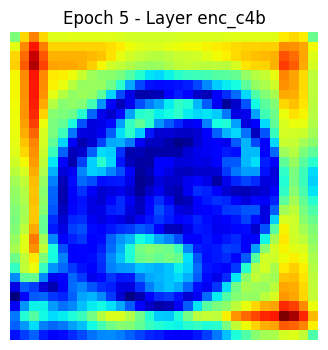

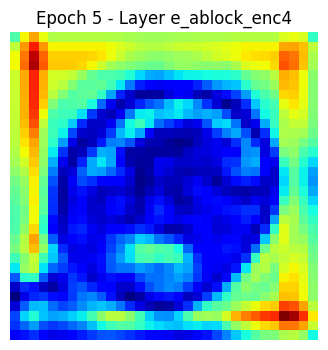

...

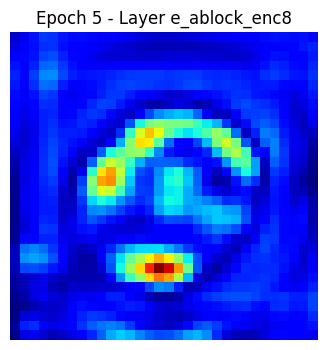

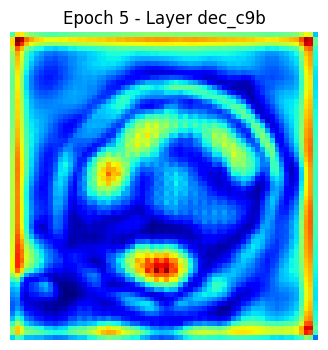

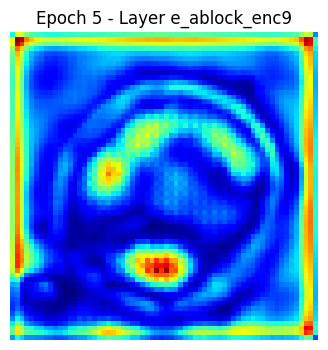

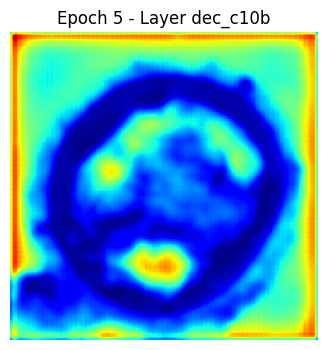

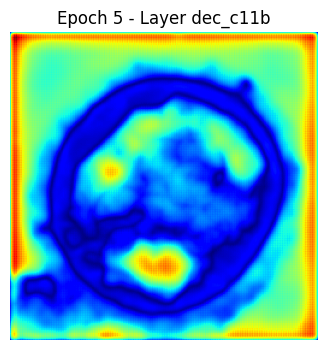

100/100 ━━━━━━━━━━━━━━━━━━━━ 42s 415ms/step - accuracy: 0.8361 - dice_coefficient: 0.6670 - iou_metric: 0.5015 - loss: 0.5246 - val_accuracy: 0.8423 - val_dice_coefficient: 0.6781 - val_iou_metric: 0.5150 - val_loss: 0.4987
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accuracy: 0.8414 - dice_coefficient: 0.7037 - iou_metric: 0.5440 - loss: 0.4682 - val_accuracy: 0.8506 - val_dice_coefficient: 0.7372 - val_iou_metric: 0.5866 - val_loss: 0.4192
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8453 - dice_coefficient: 0.7377 - iou_metric: 0.5852 - loss: 0.4155 - val_accuracy: 0.8588 - val_dice_coefficient: 0.6850 - val_iou_metric: 0.5245 - val_loss: 0.4550
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8484 - dice_coefficient: 0.7526 - iou_metric: 0.6044 - loss: 0.3879 - val_accuracy: 0.8565 - val_dice_coefficient: 0.7349 - val_iou_metric: 0.5840 - val_loss: 0.3976
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 

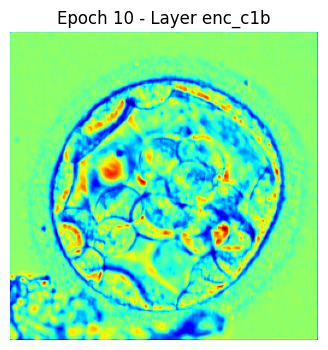

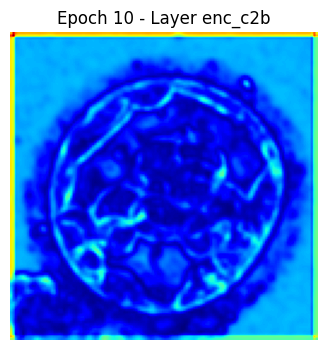

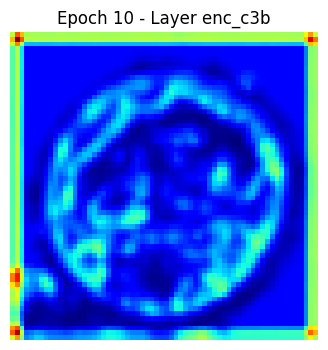

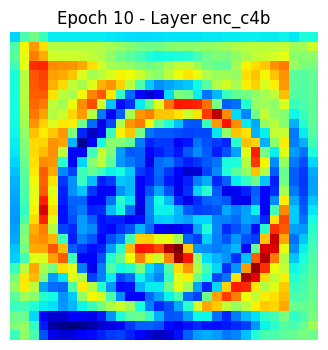

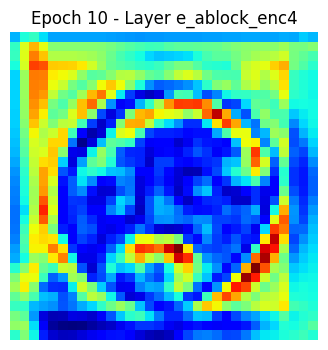

...

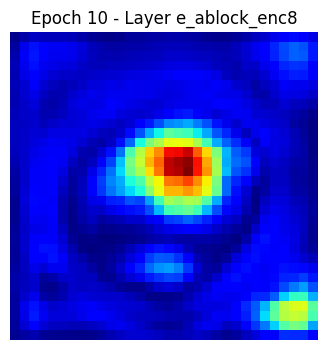

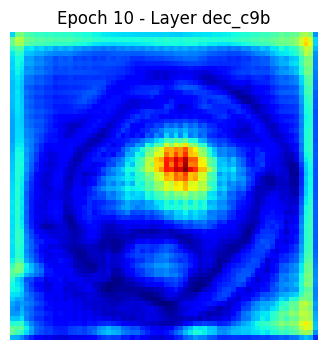

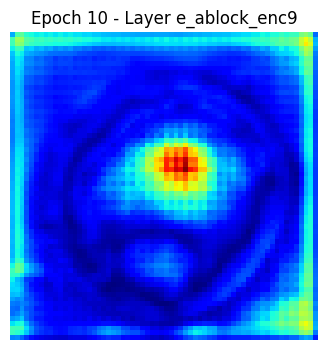

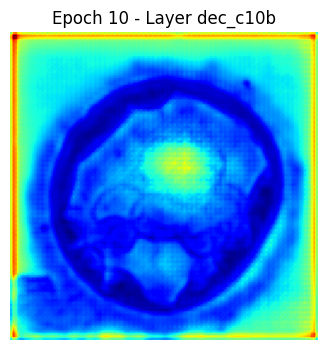

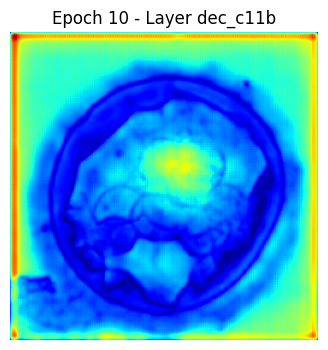

100/100 ━━━━━━━━━━━━━━━━━━━━ 42s 415ms/step - accuracy: 0.8505 - dice_coefficient: 0.7677 - iou_metric: 0.6237 - loss: 0.3672 - val_accuracy: 0.8598 - val_dice_coefficient: 0.7557 - val_iou_metric: 0.6110 - val_loss: 0.3709
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 0.8516 - dice_coefficient: 0.7770 - iou_metric: 0.6361 - loss: 0.3519 - val_accuracy: 0.8623 - val_dice_coefficient: 0.7629 - val_iou_metric: 0.6204 - val_loss: 0.3684
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8529 - dice_coefficient: 0.7817 - iou_metric: 0.6426 - loss: 0.3426 - val_accuracy: 0.8570 - val_dice_coefficient: 0.7621 - val_iou_metric: 0.6191 - val_loss: 0.3579
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 0.8528 - dice_coefficient: 0.7887 - iou_metric: 0.6517 - loss: 0.3337 - val_accuracy: 0.8596 - val_dice_coefficient: 0.7677 - val_iou_metric: 0.6268 - val_loss: 0.3525
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accura

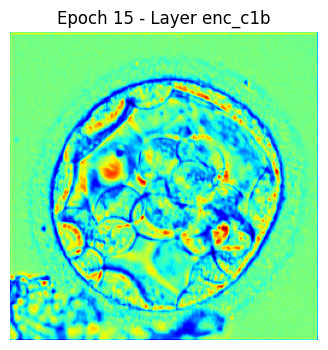

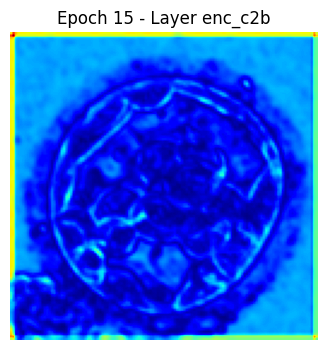

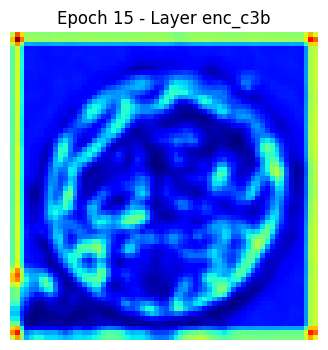

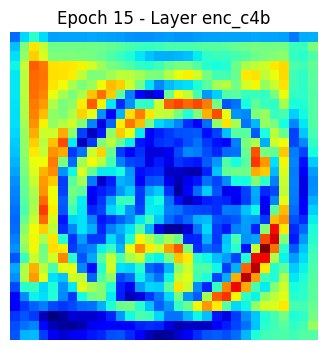

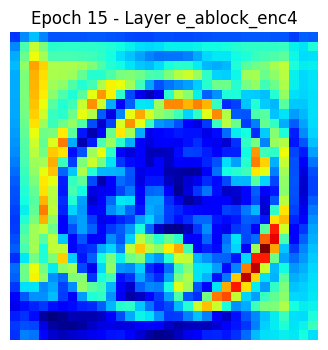

...

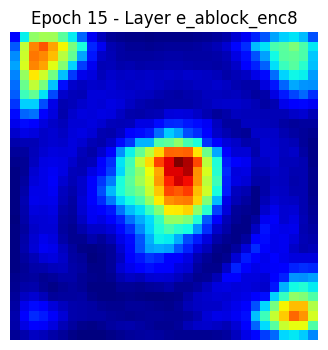

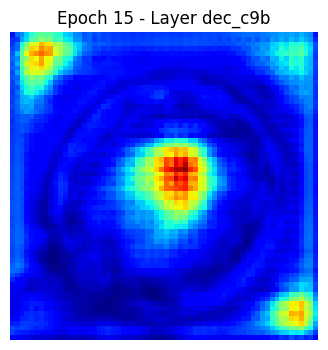

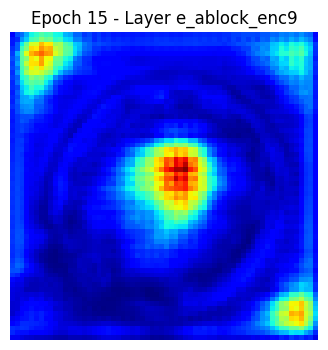

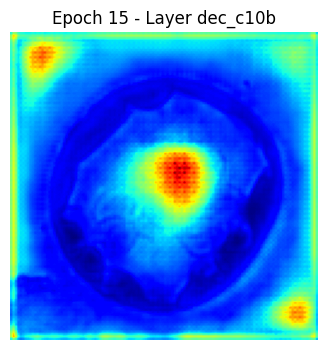

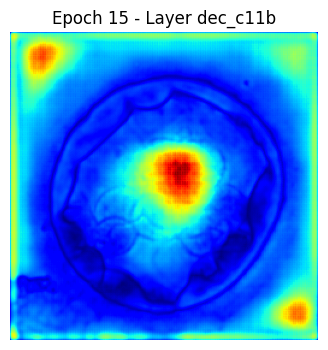

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8552 - dice_coefficient: 0.8019 - iou_metric: 0.6699 - loss: 0.3125 - val_accuracy: 0.8554 - val_dice_coefficient: 0.7843 - val_iou_metric: 0.6487 - val_loss: 0.3391
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8553 - dice_coefficient: 0.8038 - iou_metric: 0.6725 - loss: 0.3110 - val_accuracy: 0.8626 - val_dice_coefficient: 0.7559 - val_iou_metric: 0.6109 - val_loss: 0.3550
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8557 - dice_coefficient: 0.8010 - iou_metric: 0.6688 - loss: 0.3131 - val_accuracy: 0.8565 - val_dice_coefficient: 0.7803 - val_iou_metric: 0.6434 - val_loss: 0.3336
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 0.8567 - dice_coefficient: 0.8143 - iou_metric: 0.6876 - loss: 0.2932 - val_accuracy: 0.8634 - val_dice_coefficient: 0.7905 - val_iou_metric: 0.6579 - val_loss: 0.3255
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accura

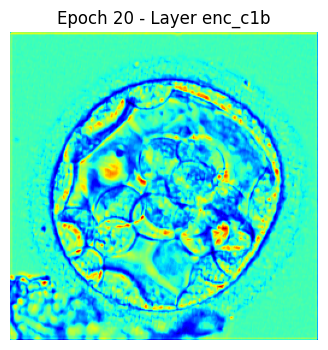

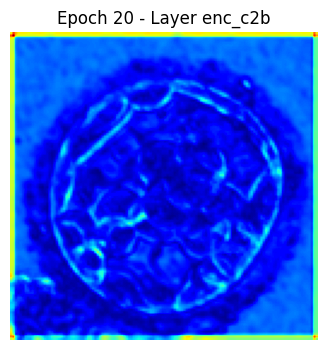

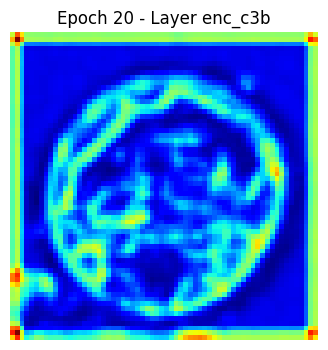

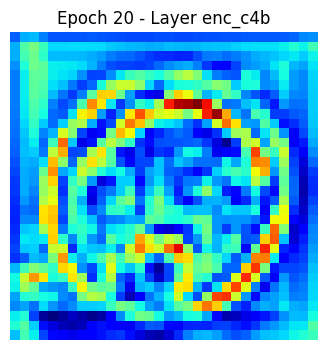

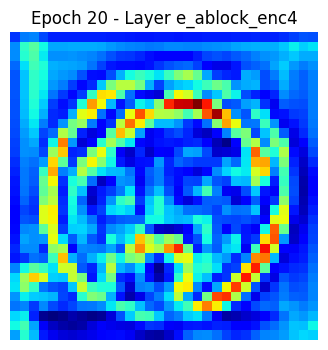

...

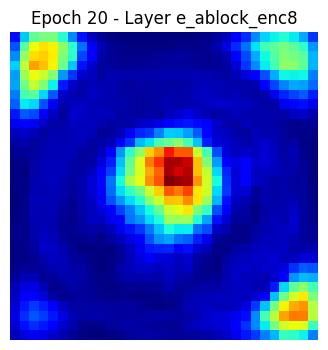

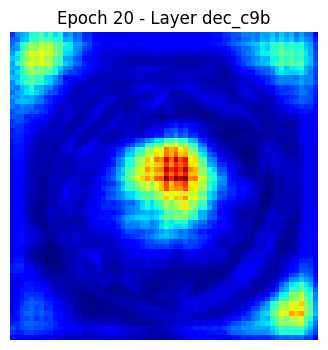

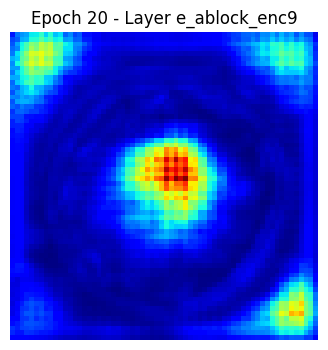

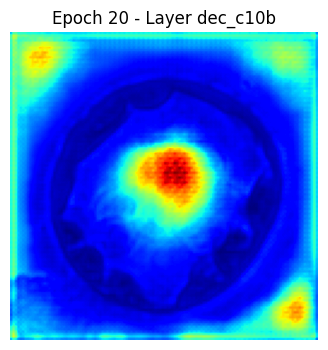

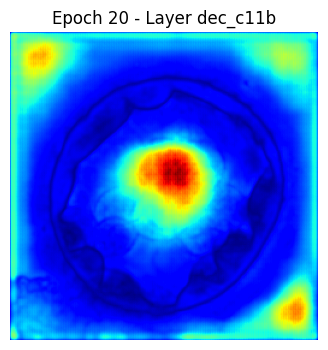

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8583 - dice_coefficient: 0.8275 - iou_metric: 0.7065 - loss: 0.2753 - val_accuracy: 0.8634 - val_dice_coefficient: 0.7956 - val_iou_metric: 0.6649 - val_loss: 0.3232
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 443ms/step - accuracy: 0.8588 - dice_coefficient: 0.8334 - iou_metric: 0.7155 - loss: 0.2684 - val_accuracy: 0.8631 - val_dice_coefficient: 0.8167 - val_iou_metric: 0.6949 - val_loss: 0.3059
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8603 - dice_coefficient: 0.8330 - iou_metric: 0.7146 - loss: 0.2668 - val_accuracy: 0.8607 - val_dice_coefficient: 0.8135 - val_iou_metric: 0.6902 - val_loss: 0.3160
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8598 - dice_coefficient: 0.8414 - iou_metric: 0.7270 - loss: 0.2546 - val_accuracy: 0.8610 - val_dice_coefficient: 0.7832 - val_iou_metric: 0.6473 - val_loss: 0.3228
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accura

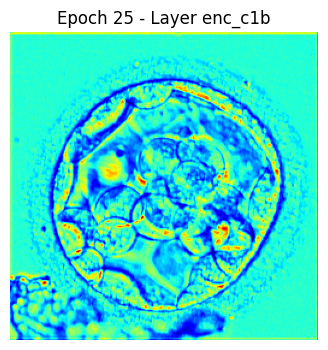

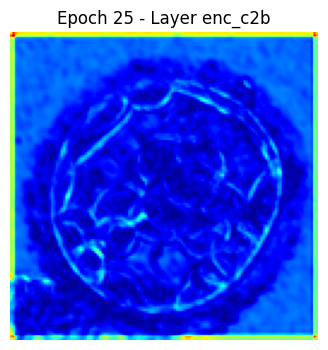

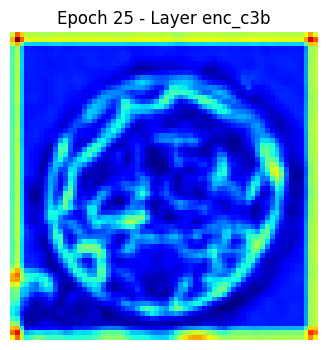

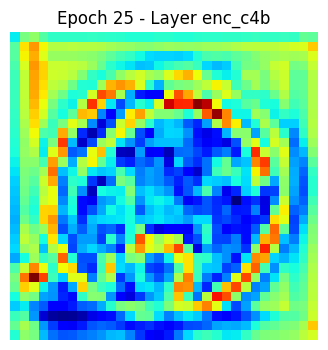

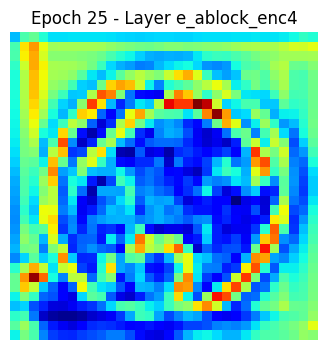

...

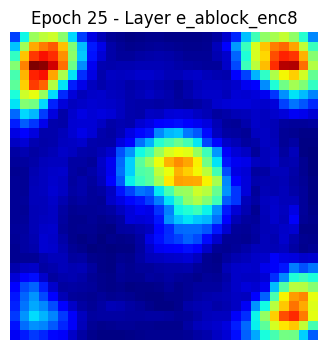

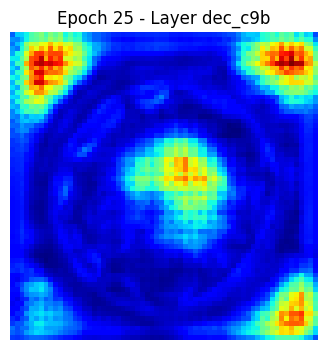

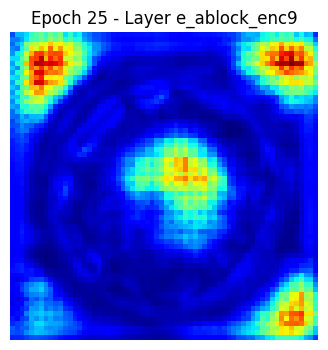

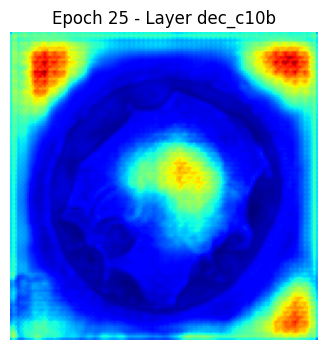

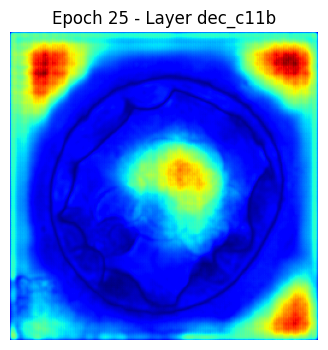

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8613 - dice_coefficient: 0.8537 - iou_metric: 0.7455 - loss: 0.2343 - val_accuracy: 0.8618 - val_dice_coefficient: 0.8083 - val_iou_metric: 0.6824 - val_loss: 0.2988
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8627 - dice_coefficient: 0.8605 - iou_metric: 0.7558 - loss: 0.2241 - val_accuracy: 0.8651 - val_dice_coefficient: 0.8118 - val_iou_metric: 0.6879 - val_loss: 0.3012
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8644 - dice_coefficient: 0.8675 - iou_metric: 0.7669 - loss: 0.2134 - val_accuracy: 0.8648 - val_dice_coefficient: 0.7794 - val_iou_metric: 0.6425 - val_loss: 0.3288
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8643 - dice_coefficient: 0.8641 - iou_metric: 0.7621 - loss: 0.2150 - val_accuracy: 0.8659 - val_dice_coefficient: 0.8107 - val_iou_metric: 0.6864 - val_loss: 0.3038
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accura

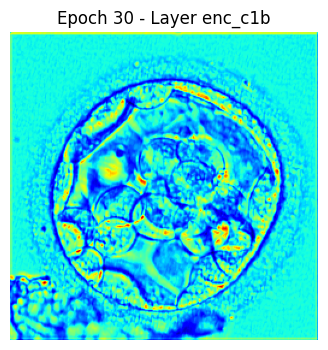

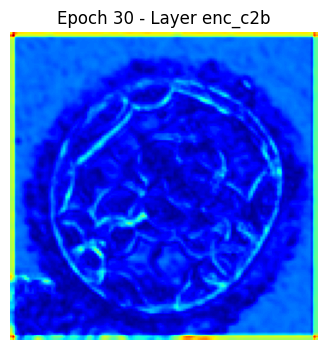

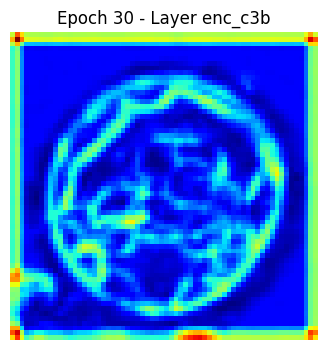

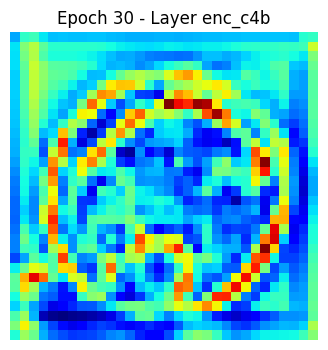

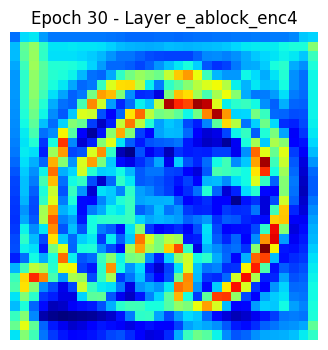

...

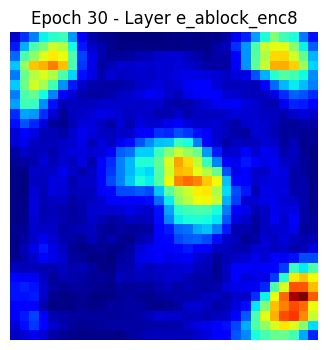

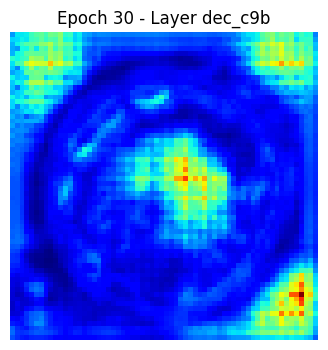

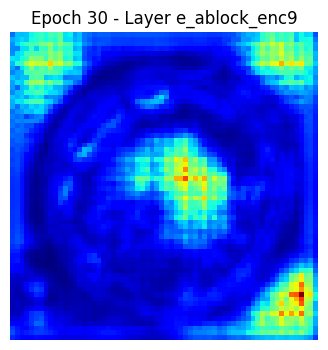

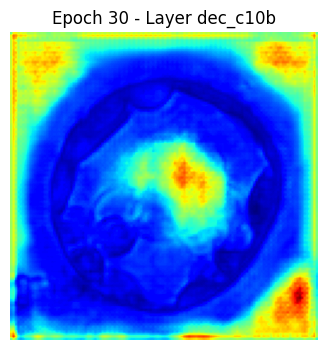

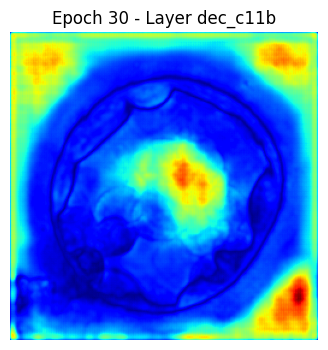

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8662 - dice_coefficient: 0.8788 - iou_metric: 0.7845 - loss: 0.1952 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8096 - val_iou_metric: 0.6847 - val_loss: 0.3056
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8658 - dice_coefficient: 0.8845 - iou_metric: 0.7937 - loss: 0.1870 - val_accuracy: 0.8630 - val_dice_coefficient: 0.7693 - val_iou_metric: 0.6284 - val_loss: 0.3577


Model: "UNet_with_IEA"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ e_ablock_enc4       │ (None, 32, 32,    │  2,623,488 │ enc_c4b[0][0]     │
│ (EAblock)           │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ e_ablock_enc4[0]… │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c5a (Conv2D)    │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c5b (Conv2D)    │ (None, 16, 16,    │  9,438,208 │ enc_c5a[0][0]     │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ e_ablock_enc5       │ (None, 16, 16,    │ 10,489,856 │ enc_c5b[0][0]   

 Total params: 359,366,597 (1.34 GB)

 Trainable params: 119,788,865 (456.96 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 239,577,732 (913.92 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 2: 1310.17s

--- Fold 3 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 93s 572ms/step - accuracy: 0.8199 - dice_coefficient: 0.1720 - iou_metric: 0.0945 - loss: 1.3223 - val_accuracy: 0.8307 - val_dice_coefficient: 0.4621 - val_iou_metric: 0.3012 - val_loss: 0.7358
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 0.8175 - dice_coefficient: 0.5389 - iou_metric: 0.3714 - loss: 0.6868 - val_accuracy: 0.8034 - val_dice_coefficient: 0.5935 - val_iou_metric: 0.4233 - val_loss: 0.6266
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 0.8230 - dice_coefficient: 0.6287 - iou_metric: 0.4593 - loss: 0.5785 - val_accuracy: 0.8320 - val_dice_coefficient: 0.6680 - val_iou_metric: 0.5032 - val_loss: 0.5190
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 0.8331 - dice_coefficient: 0.6854 - iou_metric: 0.5223 - loss: 0.4986 - val_accuracy: 0.8452

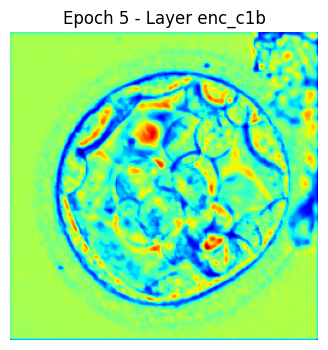

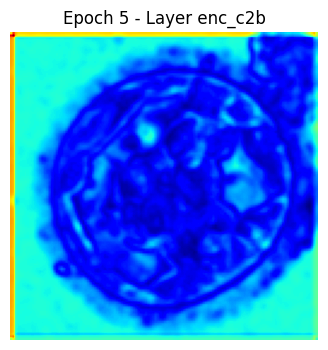

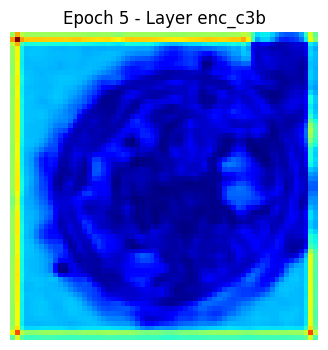

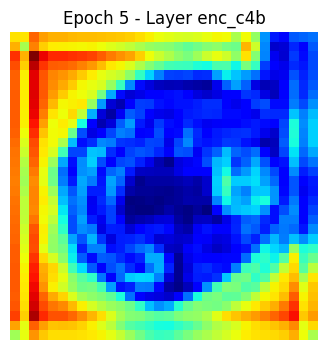

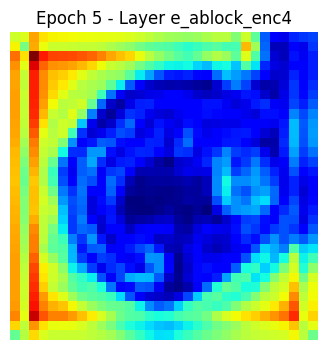

...

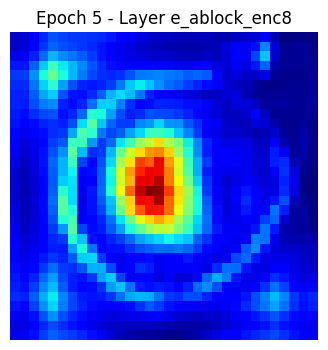

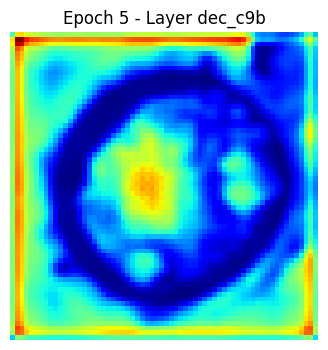

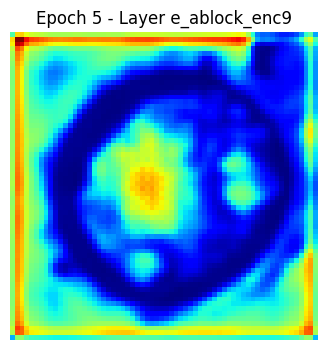

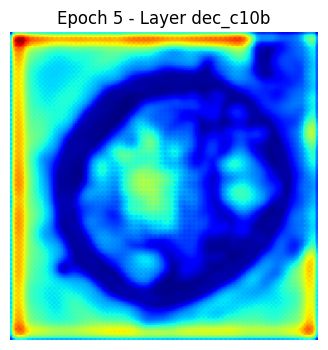

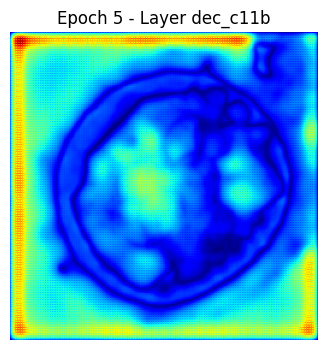

100/100 ━━━━━━━━━━━━━━━━━━━━ 42s 415ms/step - accuracy: 0.8395 - dice_coefficient: 0.7160 - iou_metric: 0.5584 - loss: 0.4484 - val_accuracy: 0.8485 - val_dice_coefficient: 0.7113 - val_iou_metric: 0.5547 - val_loss: 0.4377
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8436 - dice_coefficient: 0.7339 - iou_metric: 0.5804 - loss: 0.4220 - val_accuracy: 0.8589 - val_dice_coefficient: 0.7043 - val_iou_metric: 0.5465 - val_loss: 0.4348
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 0.8464 - dice_coefficient: 0.7491 - iou_metric: 0.5999 - loss: 0.3950 - val_accuracy: 0.8588 - val_dice_coefficient: 0.7217 - val_iou_metric: 0.5676 - val_loss: 0.4111
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 0.8486 - dice_coefficient: 0.7632 - iou_metric: 0.6182 - loss: 0.3749 - val_accuracy: 0.8593 - val_dice_coefficient: 0.7468 - val_iou_metric: 0.5992 - val_loss: 0.3800
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 

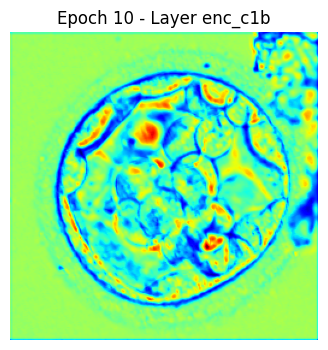

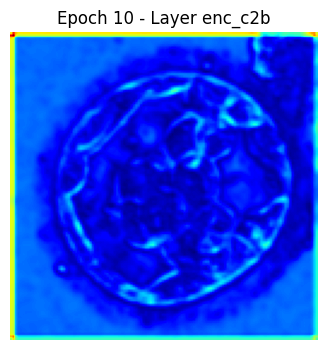

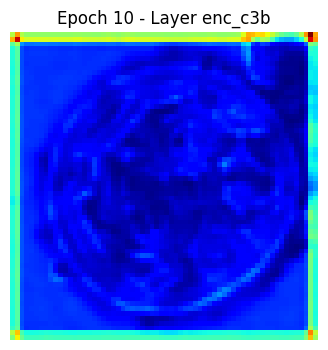

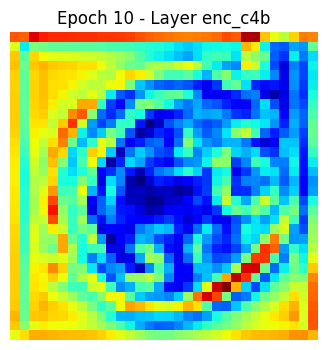

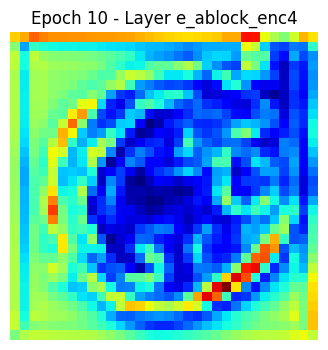

...

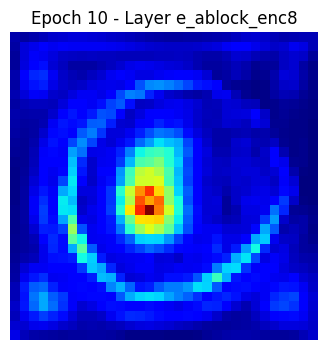

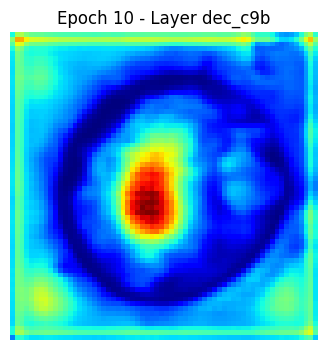

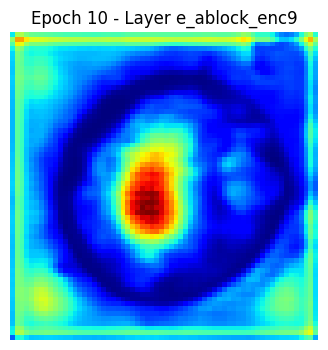

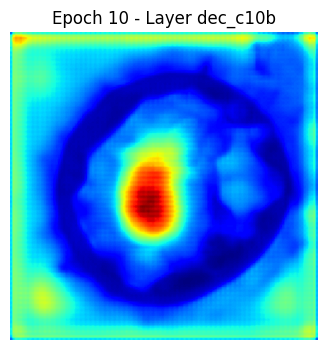

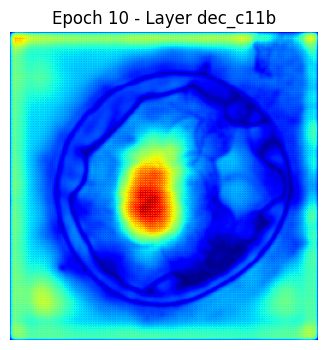

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 411ms/step - accuracy: 0.8502 - dice_coefficient: 0.7780 - iou_metric: 0.6374 - loss: 0.3521 - val_accuracy: 0.8617 - val_dice_coefficient: 0.7366 - val_iou_metric: 0.5858 - val_loss: 0.3825
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8516 - dice_coefficient: 0.7867 - iou_metric: 0.6490 - loss: 0.3389 - val_accuracy: 0.8648 - val_dice_coefficient: 0.7413 - val_iou_metric: 0.5924 - val_loss: 0.3825
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 0.8528 - dice_coefficient: 0.7904 - iou_metric: 0.6544 - loss: 0.3306 - val_accuracy: 0.8569 - val_dice_coefficient: 0.7523 - val_iou_metric: 0.6059 - val_loss: 0.3704
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 0.8529 - dice_coefficient: 0.7987 - iou_metric: 0.6658 - loss: 0.3194 - val_accuracy: 0.8547 - val_dice_coefficient: 0.7591 - val_iou_metric: 0.6148 - val_loss: 0.3637
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accura

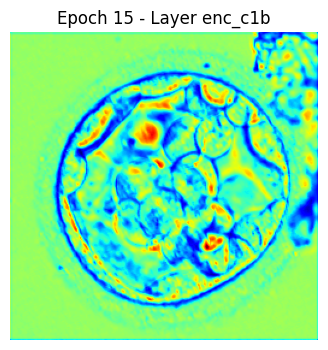

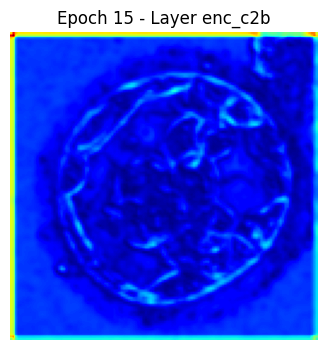

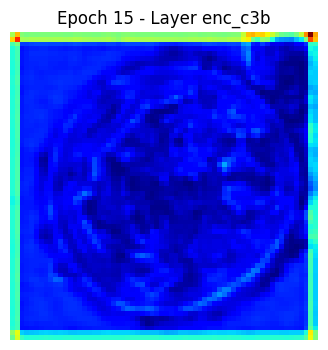

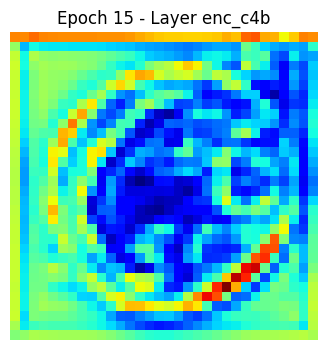

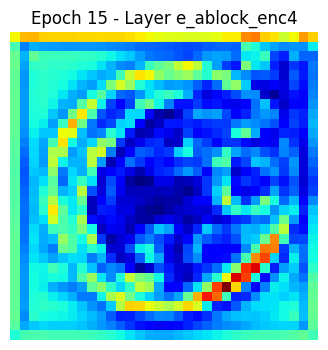

...

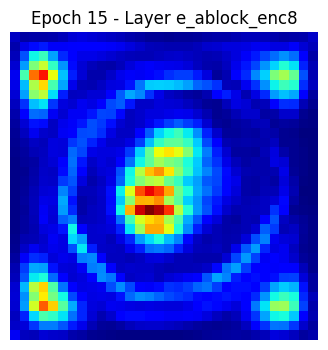

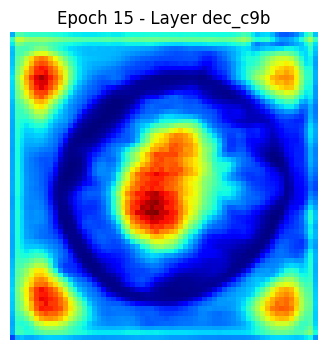

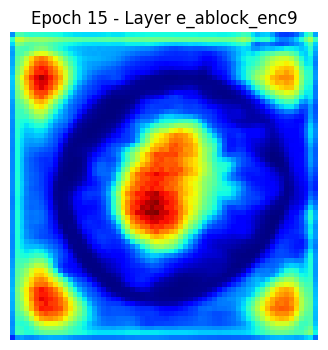

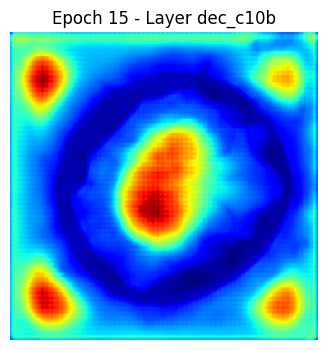

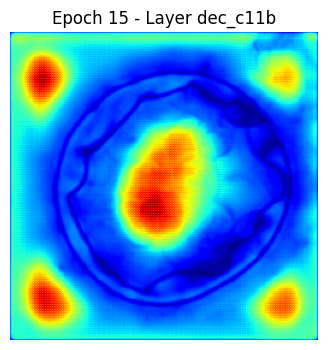

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 414ms/step - accuracy: 0.8539 - dice_coefficient: 0.8023 - iou_metric: 0.6706 - loss: 0.3140 - val_accuracy: 0.8635 - val_dice_coefficient: 0.7832 - val_iou_metric: 0.6473 - val_loss: 0.3384
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 398ms/step - accuracy: 0.8547 - dice_coefficient: 0.8156 - iou_metric: 0.6894 - loss: 0.2957 - val_accuracy: 0.8627 - val_dice_coefficient: 0.7690 - val_iou_metric: 0.6280 - val_loss: 0.3534
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 398ms/step - accuracy: 0.8555 - dice_coefficient: 0.8184 - iou_metric: 0.6931 - loss: 0.2893 - val_accuracy: 0.8631 - val_dice_coefficient: 0.7708 - val_iou_metric: 0.6302 - val_loss: 0.3432
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8566 - dice_coefficient: 0.8222 - iou_metric: 0.6990 - loss: 0.2813 - val_accuracy: 0.8607 - val_dice_coefficient: 0.7818 - val_iou_metric: 0.6450 - val_loss: 0.3355
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accura

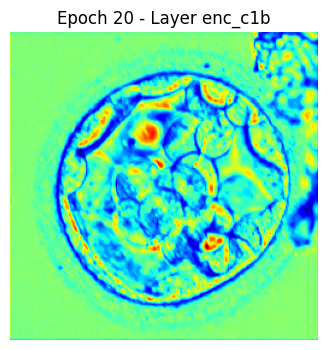

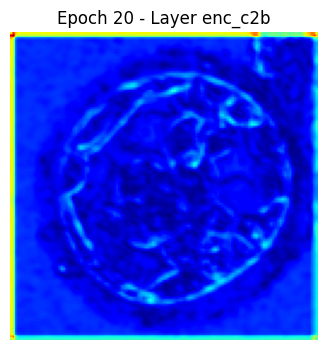

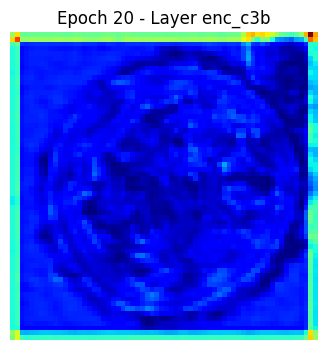

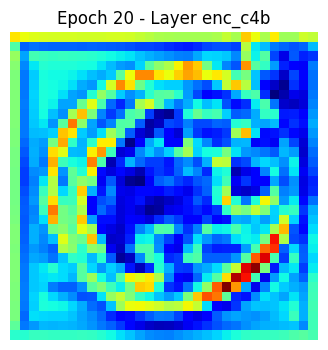

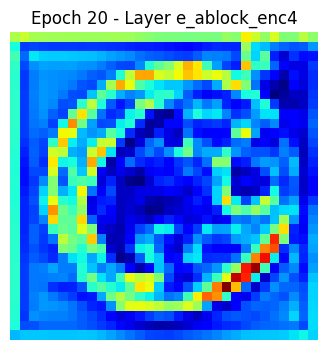

...

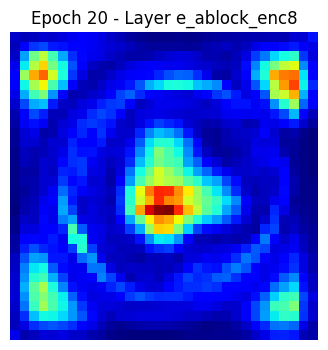

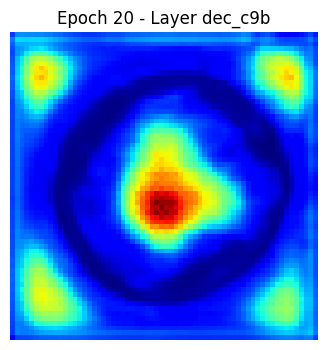

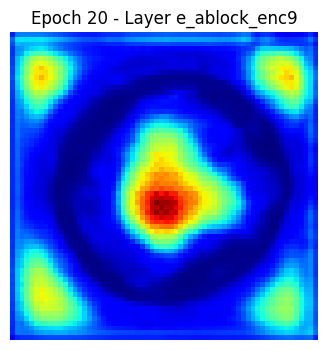

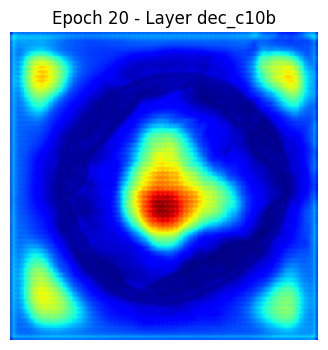

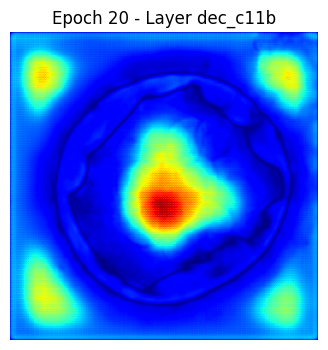

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8592 - dice_coefficient: 0.8336 - iou_metric: 0.7155 - loss: 0.2649 - val_accuracy: 0.8607 - val_dice_coefficient: 0.7748 - val_iou_metric: 0.6354 - val_loss: 0.3384
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 0.8588 - dice_coefficient: 0.8396 - iou_metric: 0.7242 - loss: 0.2577 - val_accuracy: 0.8643 - val_dice_coefficient: 0.7997 - val_iou_metric: 0.6699 - val_loss: 0.3306
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8604 - dice_coefficient: 0.8499 - iou_metric: 0.7397 - loss: 0.2423 - val_accuracy: 0.8638 - val_dice_coefficient: 0.7926 - val_iou_metric: 0.6599 - val_loss: 0.3508
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8599 - dice_coefficient: 0.8535 - iou_metric: 0.7450 - loss: 0.2364 - val_accuracy: 0.8606 - val_dice_coefficient: 0.7878 - val_iou_metric: 0.6534 - val_loss: 0.3372
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accura

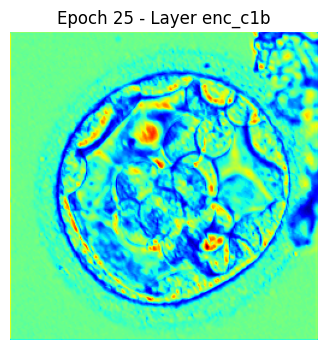

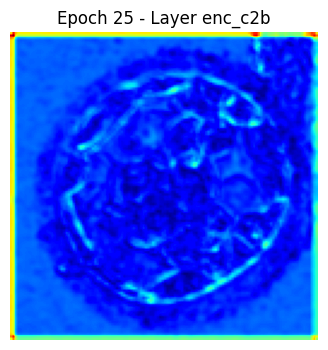

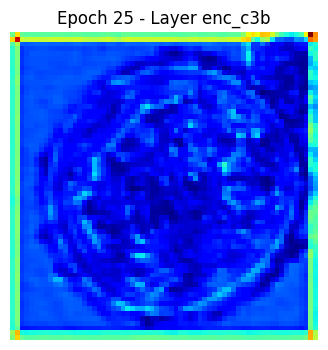

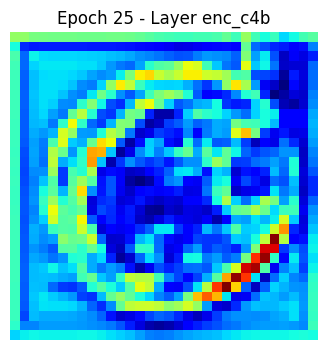

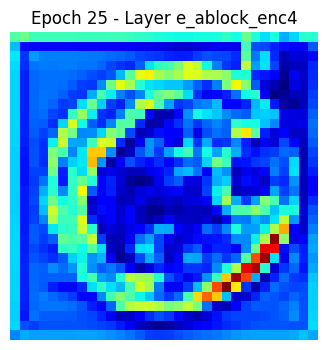

...

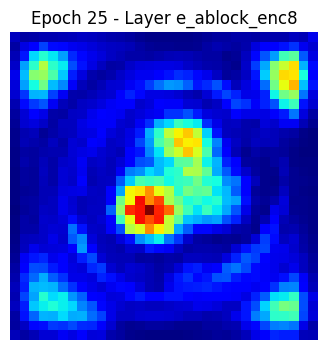

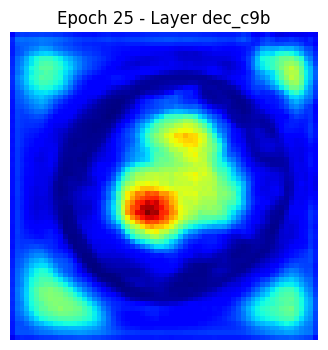

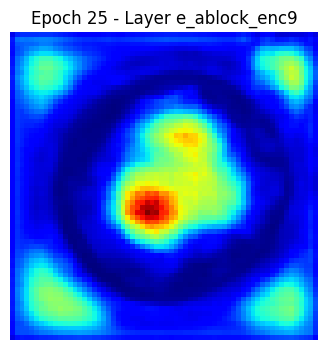

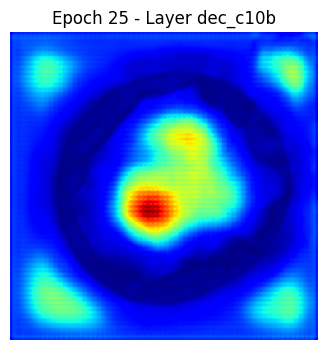

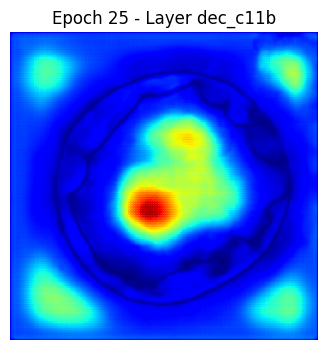

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8612 - dice_coefficient: 0.8505 - iou_metric: 0.7409 - loss: 0.2365 - val_accuracy: 0.8671 - val_dice_coefficient: 0.7912 - val_iou_metric: 0.6582 - val_loss: 0.3548
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8629 - dice_coefficient: 0.8666 - iou_metric: 0.7652 - loss: 0.2152 - val_accuracy: 0.8695 - val_dice_coefficient: 0.7709 - val_iou_metric: 0.6303 - val_loss: 0.3793
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8642 - dice_coefficient: 0.8721 - iou_metric: 0.7737 - loss: 0.2054 - val_accuracy: 0.8665 - val_dice_coefficient: 0.7900 - val_iou_metric: 0.6561 - val_loss: 0.3480
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8643 - dice_coefficient: 0.8771 - iou_metric: 0.7817 - loss: 0.1955 - val_accuracy: 0.8647 - val_dice_coefficient: 0.7942 - val_iou_metric: 0.6620 - val_loss: 0.3457
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accura

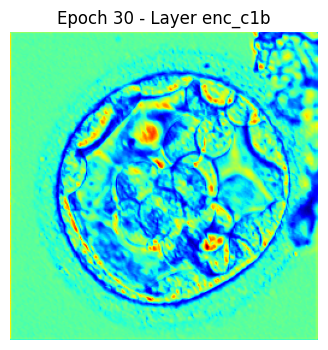

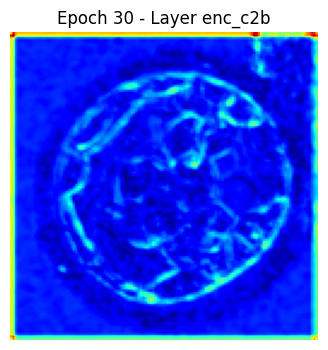

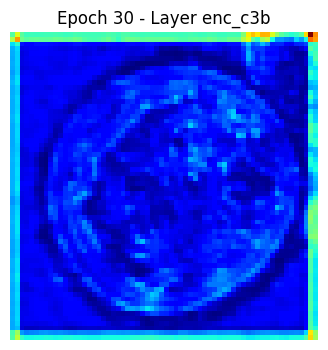

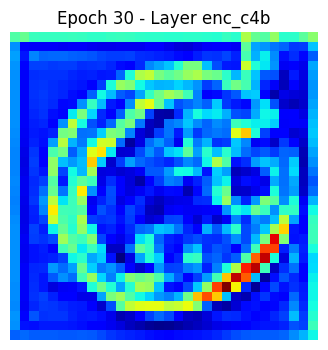

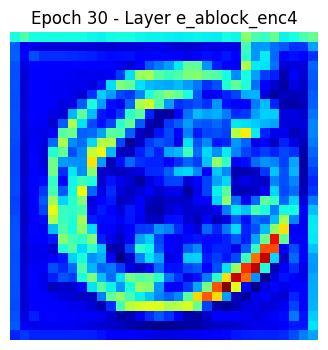

...

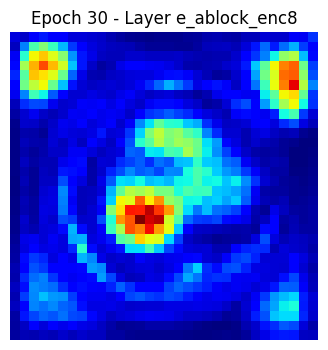

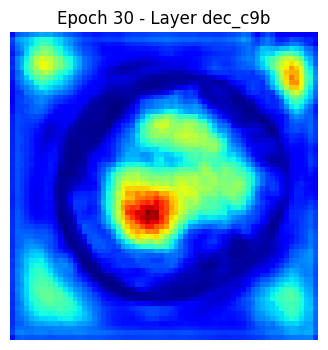

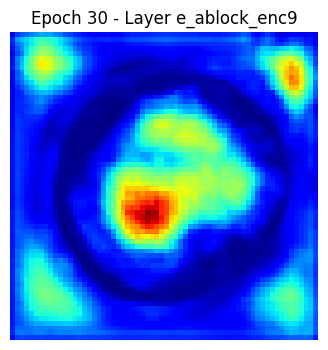

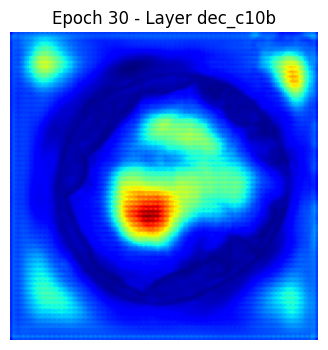

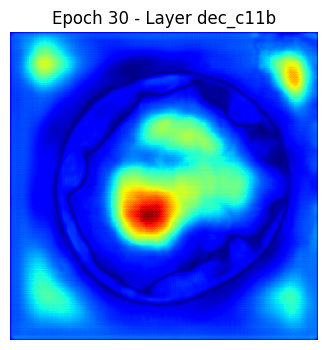

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8654 - dice_coefficient: 0.8831 - iou_metric: 0.7912 - loss: 0.1856 - val_accuracy: 0.8686 - val_dice_coefficient: 0.7766 - val_iou_metric: 0.6378 - val_loss: 0.3847
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8648 - dice_coefficient: 0.8876 - iou_metric: 0.7984 - loss: 0.1805 - val_accuracy: 0.8647 - val_dice_coefficient: 0.7987 - val_iou_metric: 0.6679 - val_loss: 0.3352


Model: "UNet_with_IEA"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ e_ablock_enc4       │ (None, 32, 32,    │  2,623,488 │ enc_c4b[0][0]     │
│ (EAblock)           │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ e_ablock_enc4[0]… │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c5a (Conv2D)    │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c5b (Conv2D)    │ (None, 16, 16,    │  9,438,208 │ enc_c5a[0][0]     │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ e_ablock_enc5       │ (None, 16, 16,    │ 10,489,856 │ enc_c5b[0][0]   

 Total params: 359,366,597 (1.34 GB)

 Trainable params: 119,788,865 (456.96 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 239,577,732 (913.92 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 3: 1304.81s

--- Fold 4 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 90s 564ms/step - accuracy: 0.8124 - dice_coefficient: 0.1744 - iou_metric: 0.0959 - loss: 1.3171 - val_accuracy: 0.8825 - val_dice_coefficient: 0.3962 - val_iou_metric: 0.2480 - val_loss: 0.8225
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 0.8311 - dice_coefficient: 0.4916 - iou_metric: 0.3317 - loss: 0.7373 - val_accuracy: 0.8541 - val_dice_coefficient: 0.5662 - val_iou_metric: 0.3982 - val_loss: 0.6207
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 0.8327 - dice_coefficient: 0.6341 - iou_metric: 0.4656 - loss: 0.5682 - val_accuracy: 0.8546 - val_dice_coefficient: 0.6008 - val_iou_metric: 0.4327 - val_loss: 0.5946
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 0.8361 - dice_coefficient: 0.6652 - iou_metric: 0.4991 - loss: 0.5233 - val_accuracy: 0.8498

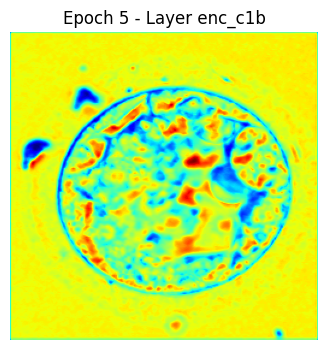

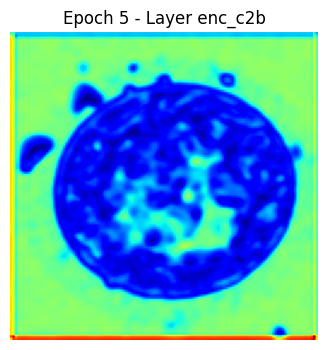

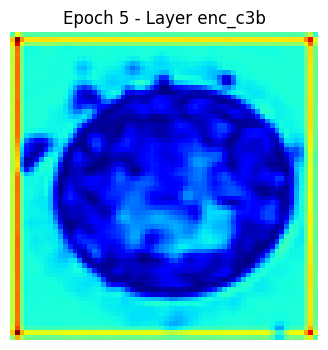

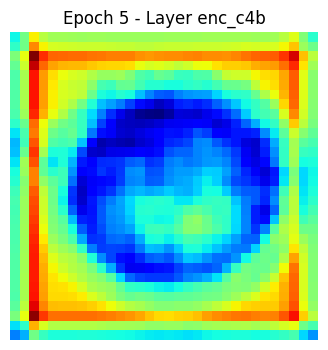

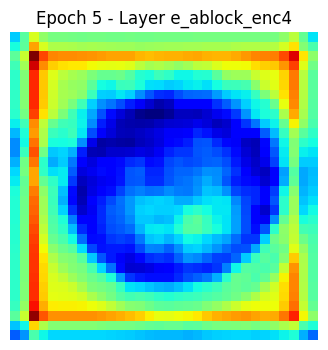

...

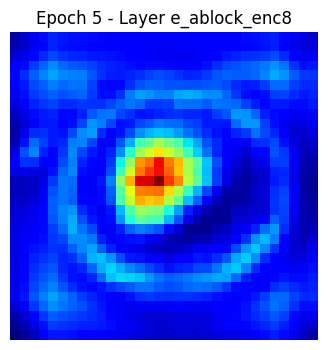

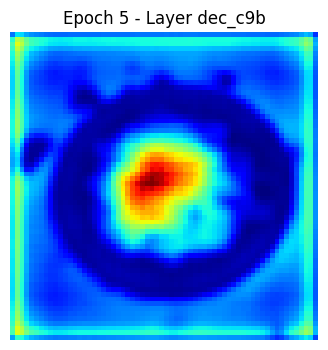

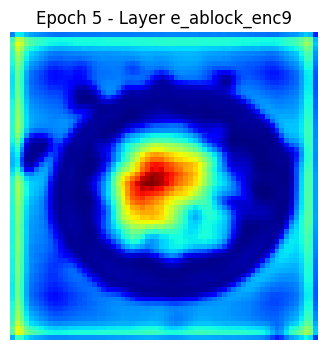

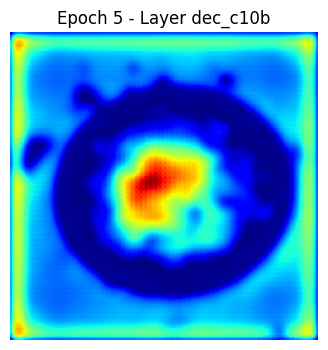

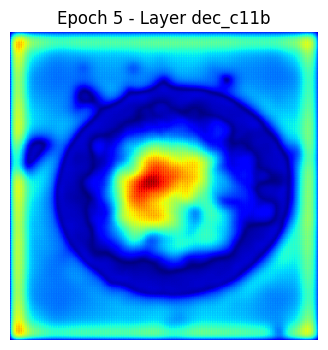

100/100 ━━━━━━━━━━━━━━━━━━━━ 42s 414ms/step - accuracy: 0.8415 - dice_coefficient: 0.7109 - iou_metric: 0.5524 - loss: 0.4561 - val_accuracy: 0.8522 - val_dice_coefficient: 0.6981 - val_iou_metric: 0.5406 - val_loss: 0.4538
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8429 - dice_coefficient: 0.7243 - iou_metric: 0.5687 - loss: 0.4369 - val_accuracy: 0.8507 - val_dice_coefficient: 0.6747 - val_iou_metric: 0.5129 - val_loss: 0.4713
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 404ms/step - accuracy: 0.8438 - dice_coefficient: 0.7324 - iou_metric: 0.5793 - loss: 0.4213 - val_accuracy: 0.8571 - val_dice_coefficient: 0.7395 - val_iou_metric: 0.5922 - val_loss: 0.4017
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8479 - dice_coefficient: 0.7614 - iou_metric: 0.6158 - loss: 0.3775 - val_accuracy: 0.8613 - val_dice_coefficient: 0.7154 - val_iou_metric: 0.5619 - val_loss: 0.4169
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 

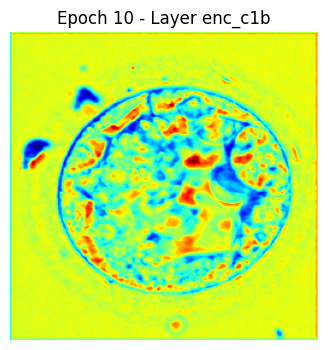

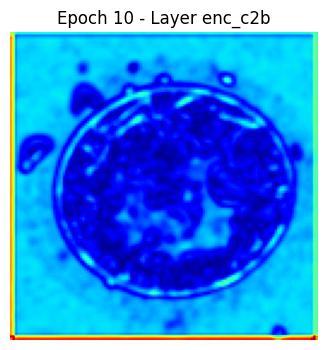

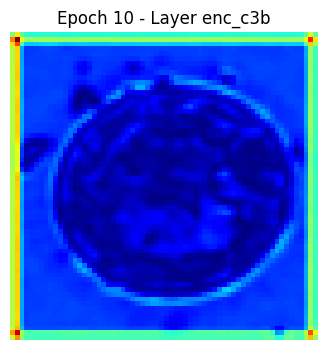

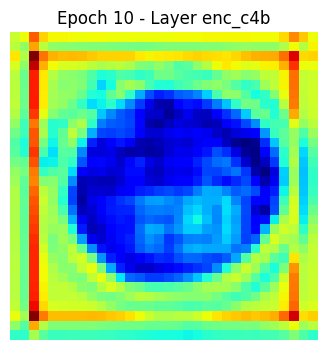

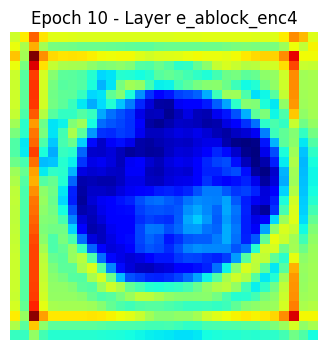

...

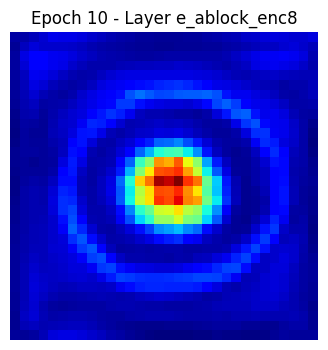

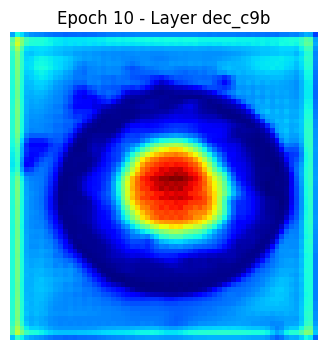

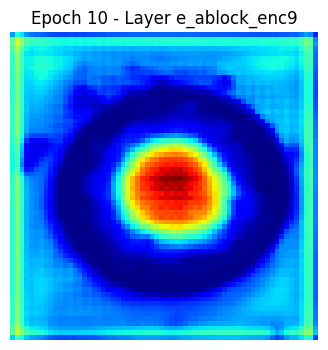

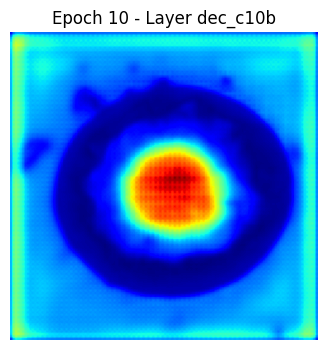

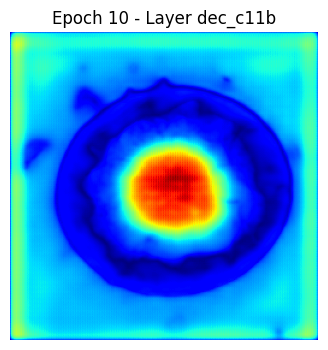

100/100 ━━━━━━━━━━━━━━━━━━━━ 42s 416ms/step - accuracy: 0.8519 - dice_coefficient: 0.7830 - iou_metric: 0.6440 - loss: 0.3434 - val_accuracy: 0.8568 - val_dice_coefficient: 0.7607 - val_iou_metric: 0.6201 - val_loss: 0.3713
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8516 - dice_coefficient: 0.7896 - iou_metric: 0.6530 - loss: 0.3338 - val_accuracy: 0.8579 - val_dice_coefficient: 0.7571 - val_iou_metric: 0.6152 - val_loss: 0.3692
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 0.8539 - dice_coefficient: 0.7988 - iou_metric: 0.6658 - loss: 0.3196 - val_accuracy: 0.8626 - val_dice_coefficient: 0.7776 - val_iou_metric: 0.6427 - val_loss: 0.3559
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8536 - dice_coefficient: 0.7981 - iou_metric: 0.6648 - loss: 0.3225 - val_accuracy: 0.8615 - val_dice_coefficient: 0.7715 - val_iou_metric: 0.6341 - val_loss: 0.3525
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accura

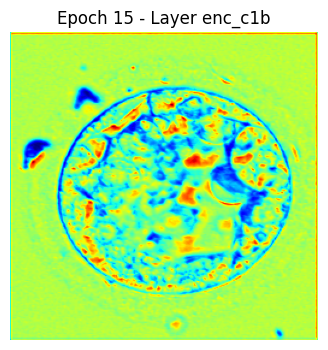

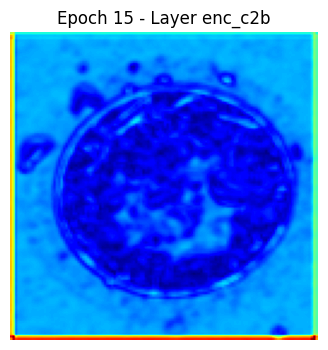

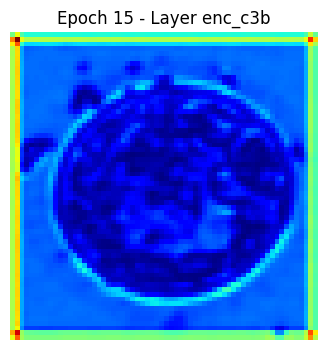

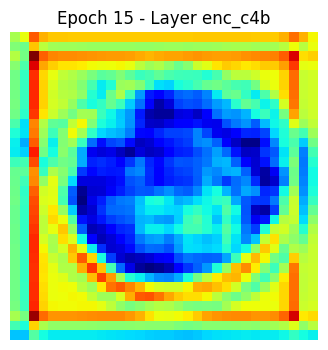

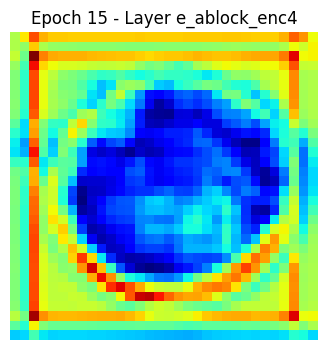

...

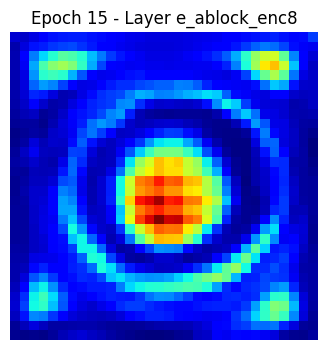

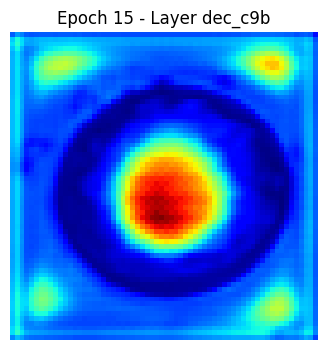

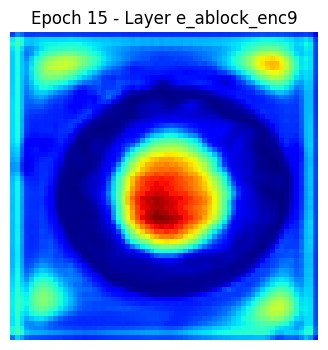

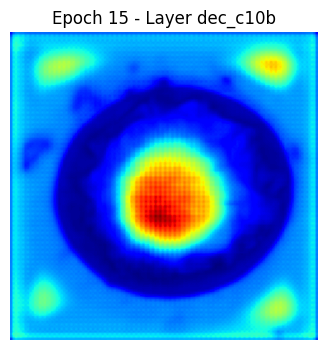

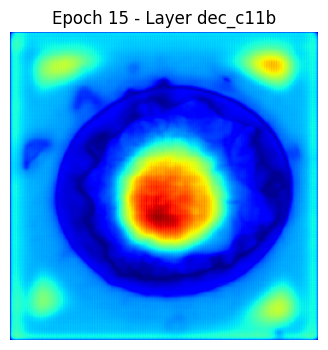

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8560 - dice_coefficient: 0.8159 - iou_metric: 0.6898 - loss: 0.2948 - val_accuracy: 0.8663 - val_dice_coefficient: 0.7774 - val_iou_metric: 0.6428 - val_loss: 0.3495
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8574 - dice_coefficient: 0.8187 - iou_metric: 0.6937 - loss: 0.2895 - val_accuracy: 0.8680 - val_dice_coefficient: 0.7755 - val_iou_metric: 0.6401 - val_loss: 0.3397
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8568 - dice_coefficient: 0.8231 - iou_metric: 0.7001 - loss: 0.2817 - val_accuracy: 0.8644 - val_dice_coefficient: 0.7569 - val_iou_metric: 0.6144 - val_loss: 0.3501
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 0.8579 - dice_coefficient: 0.8276 - iou_metric: 0.7068 - loss: 0.2745 - val_accuracy: 0.8601 - val_dice_coefficient: 0.7989 - val_iou_metric: 0.6714 - val_loss: 0.3241
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accura

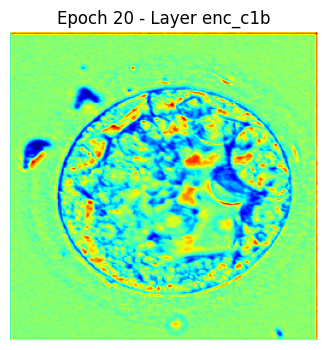

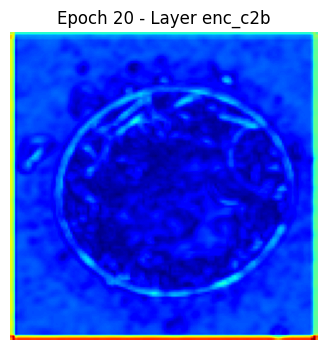

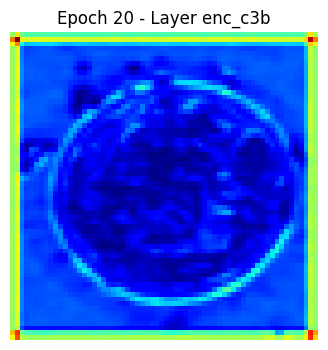

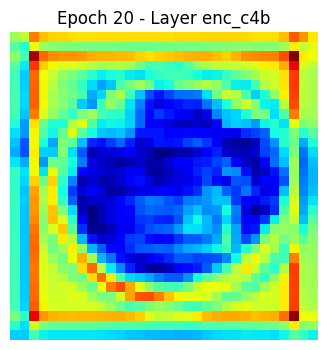

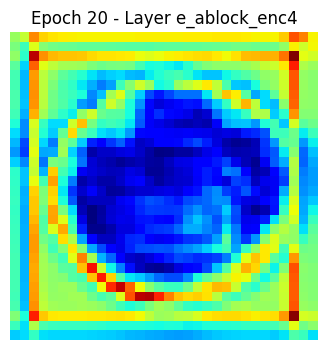

...

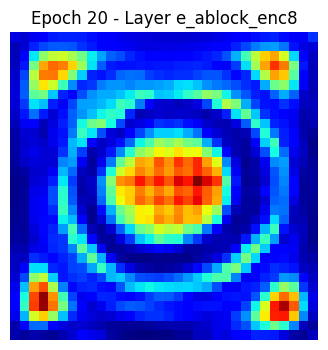

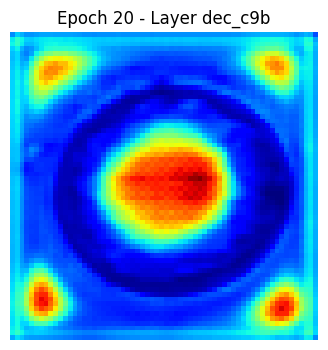

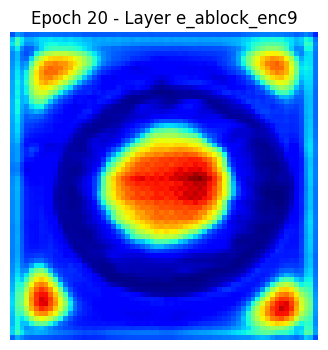

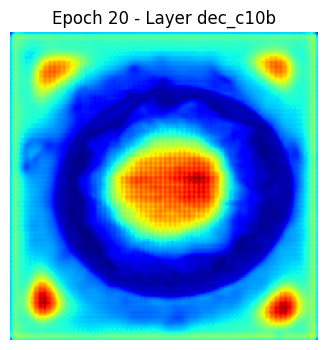

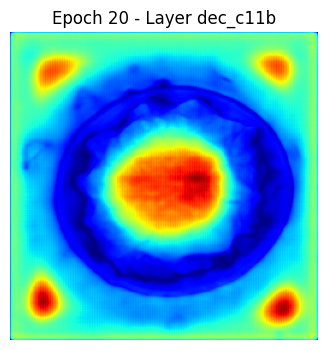

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8608 - dice_coefficient: 0.8366 - iou_metric: 0.7202 - loss: 0.2580 - val_accuracy: 0.8641 - val_dice_coefficient: 0.7894 - val_iou_metric: 0.6583 - val_loss: 0.3256
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 0.8605 - dice_coefficient: 0.8439 - iou_metric: 0.7306 - loss: 0.2496 - val_accuracy: 0.8621 - val_dice_coefficient: 0.8037 - val_iou_metric: 0.6780 - val_loss: 0.3121
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8614 - dice_coefficient: 0.8520 - iou_metric: 0.7428 - loss: 0.2363 - val_accuracy: 0.8580 - val_dice_coefficient: 0.7934 - val_iou_metric: 0.6636 - val_loss: 0.3261
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8610 - dice_coefficient: 0.8556 - iou_metric: 0.7482 - loss: 0.2305 - val_accuracy: 0.8666 - val_dice_coefficient: 0.7951 - val_iou_metric: 0.6665 - val_loss: 0.3273
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accura

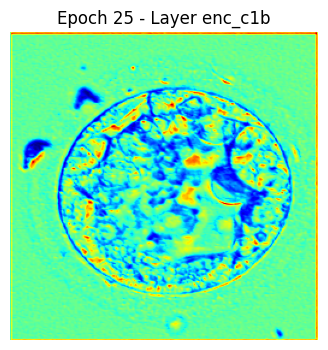

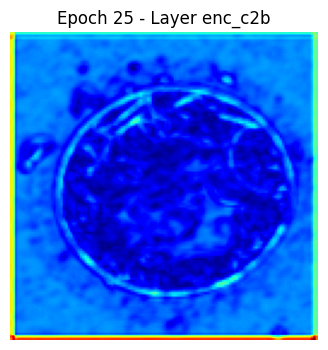

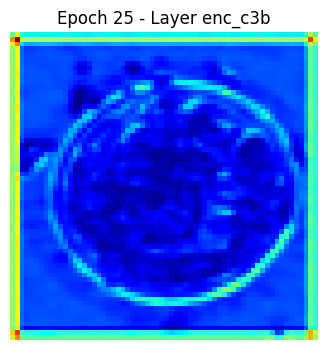

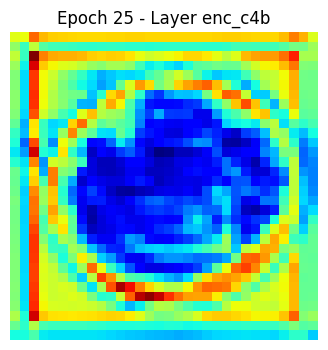

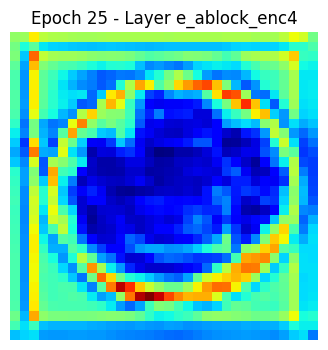

...

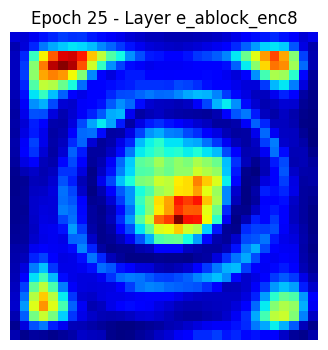

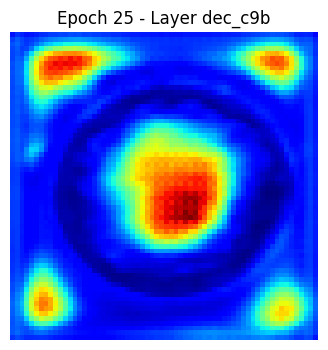

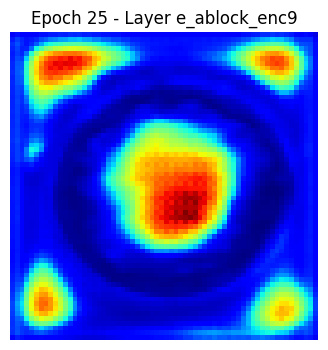

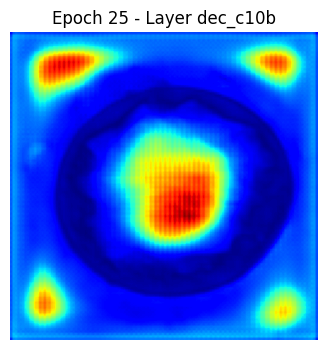

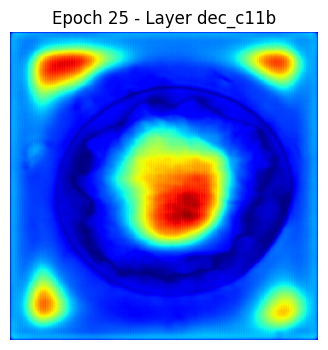

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8626 - dice_coefficient: 0.8673 - iou_metric: 0.7662 - loss: 0.2138 - val_accuracy: 0.8665 - val_dice_coefficient: 0.7970 - val_iou_metric: 0.6692 - val_loss: 0.3307
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8629 - dice_coefficient: 0.8652 - iou_metric: 0.7631 - loss: 0.2163 - val_accuracy: 0.8694 - val_dice_coefficient: 0.7980 - val_iou_metric: 0.6711 - val_loss: 0.3357
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8644 - dice_coefficient: 0.8709 - iou_metric: 0.7719 - loss: 0.2080 - val_accuracy: 0.8630 - val_dice_coefficient: 0.7686 - val_iou_metric: 0.6302 - val_loss: 0.3901
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8632 - dice_coefficient: 0.8645 - iou_metric: 0.7623 - loss: 0.2167 - val_accuracy: 0.8650 - val_dice_coefficient: 0.8003 - val_iou_metric: 0.6728 - val_loss: 0.3221
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accura

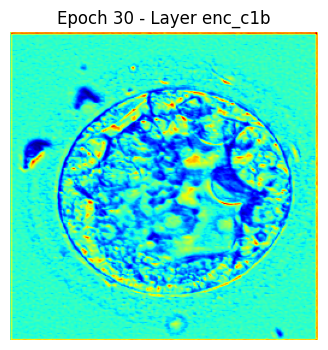

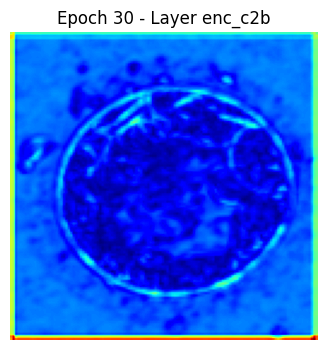

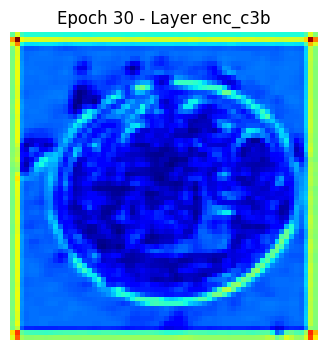

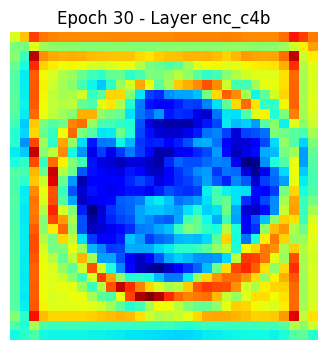

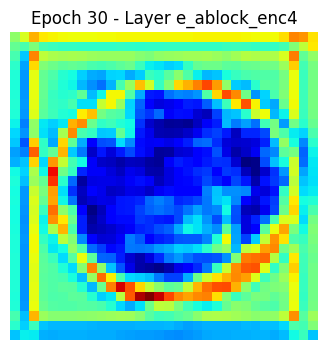

...

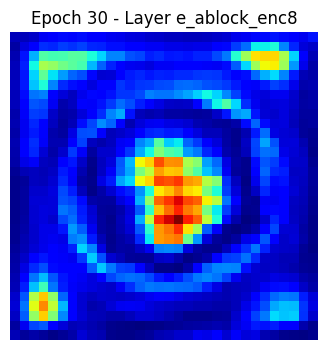

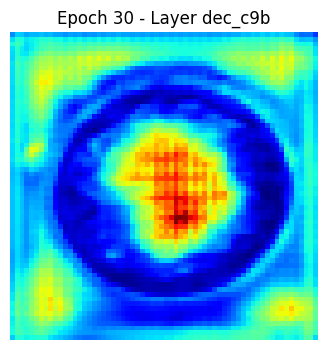

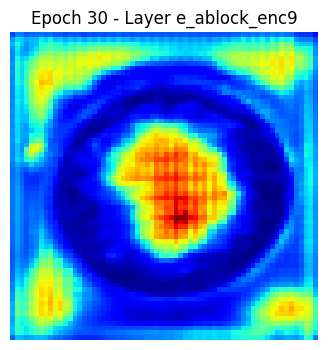

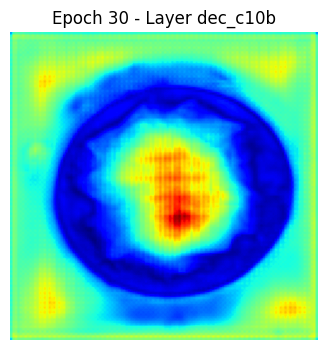

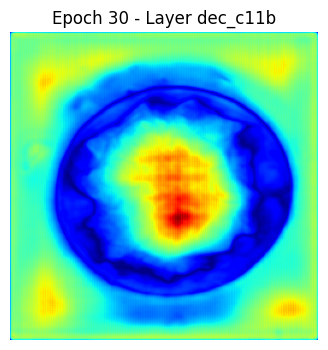

100/100 ━━━━━━━━━━━━━━━━━━━━ 42s 416ms/step - accuracy: 0.8660 - dice_coefficient: 0.8811 - iou_metric: 0.7882 - loss: 0.1900 - val_accuracy: 0.8694 - val_dice_coefficient: 0.8093 - val_iou_metric: 0.6867 - val_loss: 0.3209
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8663 - dice_coefficient: 0.8902 - iou_metric: 0.8026 - loss: 0.1768 - val_accuracy: 0.8647 - val_dice_coefficient: 0.8063 - val_iou_metric: 0.6815 - val_loss: 0.3157
Epoch 32/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8673 - dice_coefficient: 0.8935 - iou_metric: 0.8079 - loss: 0.1685 - val_accuracy: 0.8627 - val_dice_coefficient: 0.7915 - val_iou_metric: 0.6612 - val_loss: 0.3663
Epoch 33/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8667 - dice_coefficient: 0.8934 - iou_metric: 0.8077 - loss: 0.1715 - val_accuracy: 0.8681 - val_dice_coefficient: 0.8033 - val_iou_metric: 0.6777 - val_loss: 0.3261
Epoch 34/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accura

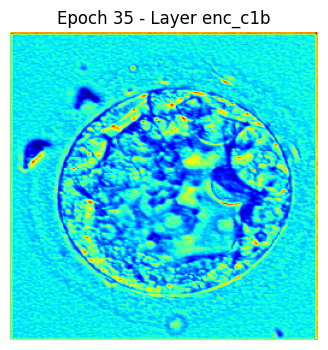

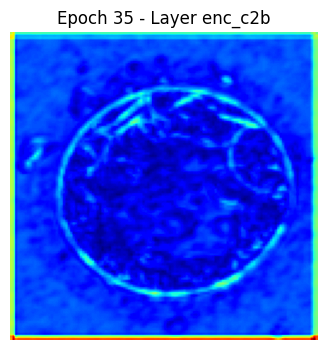

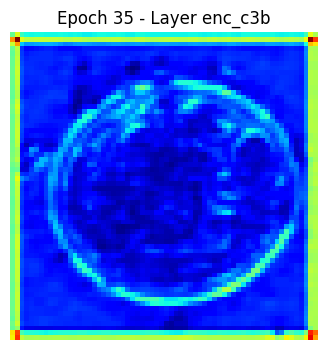

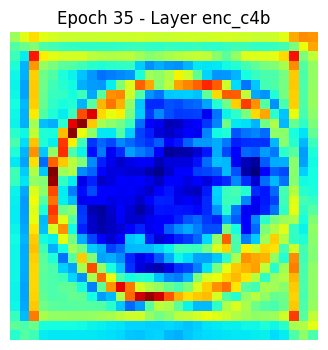

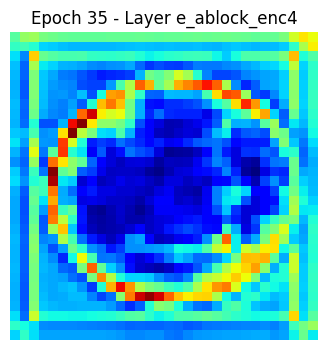

...

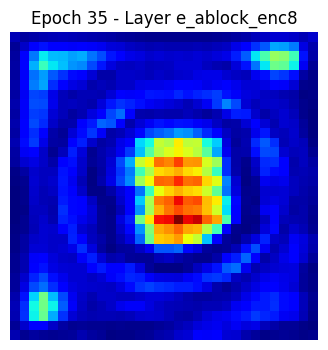

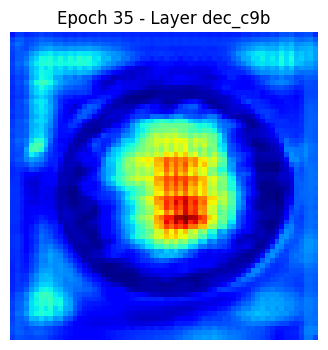

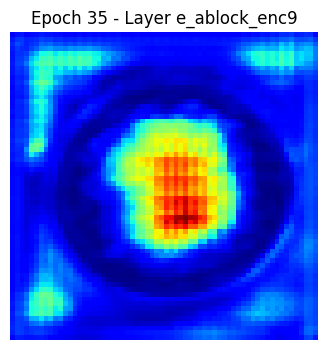

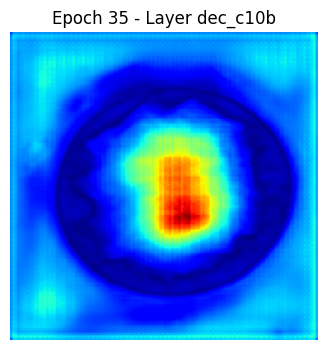

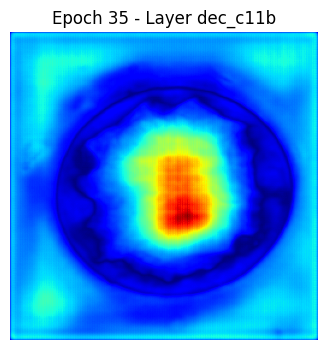

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8674 - dice_coefficient: 0.9002 - iou_metric: 0.8190 - loss: 0.1595 - val_accuracy: 0.8703 - val_dice_coefficient: 0.8032 - val_iou_metric: 0.6785 - val_loss: 0.3422
Epoch 36/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 45s 445ms/step - accuracy: 0.8682 - dice_coefficient: 0.9037 - iou_metric: 0.8247 - loss: 0.1534 - val_accuracy: 0.8653 - val_dice_coefficient: 0.8215 - val_iou_metric: 0.7046 - val_loss: 0.3203
Epoch 37/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8682 - dice_coefficient: 0.9097 - iou_metric: 0.8346 - loss: 0.1445 - val_accuracy: 0.8642 - val_dice_coefficient: 0.7968 - val_iou_metric: 0.6688 - val_loss: 0.3594
Epoch 38/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8694 - dice_coefficient: 0.9082 - iou_metric: 0.8323 - loss: 0.1456 - val_accuracy: 0.8652 - val_dice_coefficient: 0.8133 - val_iou_metric: 0.6931 - val_loss: 0.3392
Epoch 39/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 440ms/step - accura

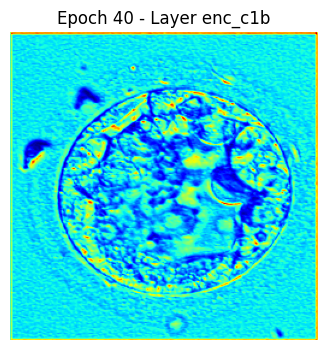

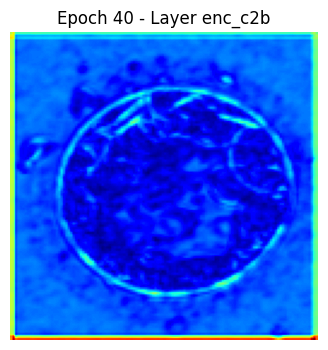

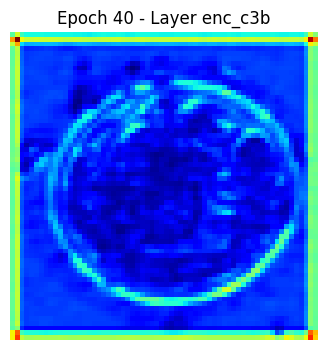

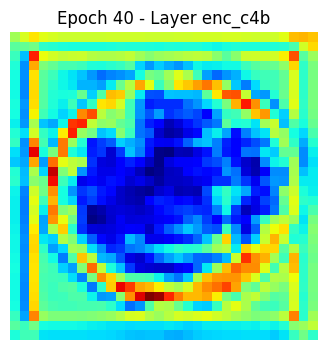

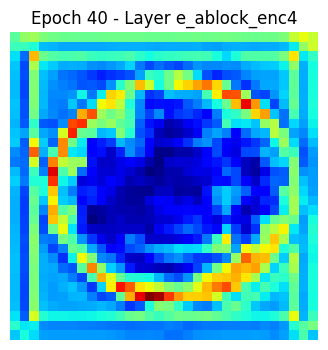

...

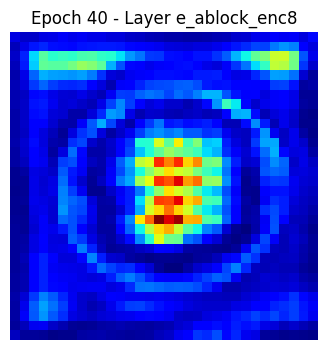

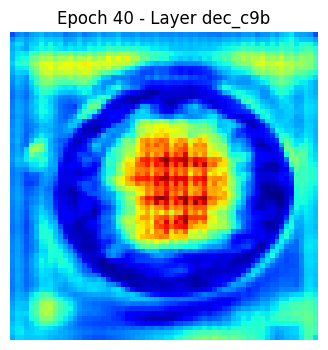

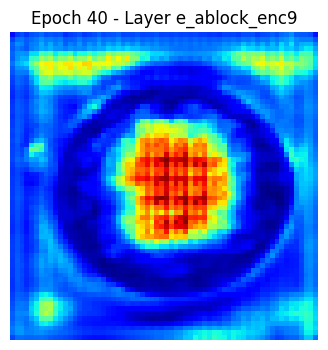

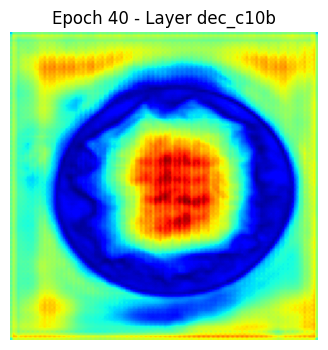

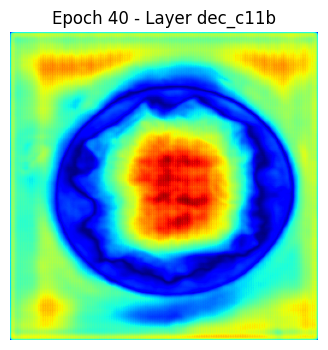

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8696 - dice_coefficient: 0.9158 - iou_metric: 0.8449 - loss: 0.1344 - val_accuracy: 0.8677 - val_dice_coefficient: 0.8209 - val_iou_metric: 0.7043 - val_loss: 0.3357
Epoch 41/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8701 - dice_coefficient: 0.9211 - iou_metric: 0.8540 - loss: 0.1253 - val_accuracy: 0.8671 - val_dice_coefficient: 0.8209 - val_iou_metric: 0.7041 - val_loss: 0.3440
Epoch 42/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8704 - dice_coefficient: 0.9222 - iou_metric: 0.8557 - loss: 0.1227 - val_accuracy: 0.8692 - val_dice_coefficient: 0.8231 - val_iou_metric: 0.7074 - val_loss: 0.3396
Epoch 43/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 399ms/step - accuracy: 0.8708 - dice_coefficient: 0.9260 - iou_metric: 0.8623 - loss: 0.1177 - val_accuracy: 0.8684 - val_dice_coefficient: 0.8198 - val_iou_metric: 0.7029 - val_loss: 0.3515
Epoch 44/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 441ms/step - accura

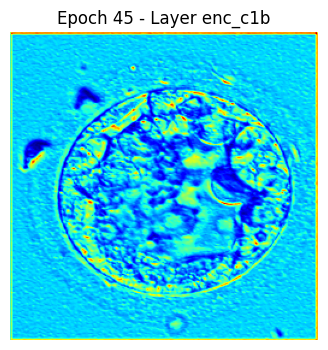

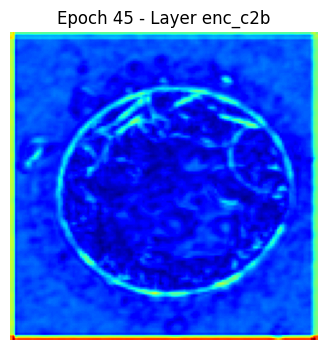

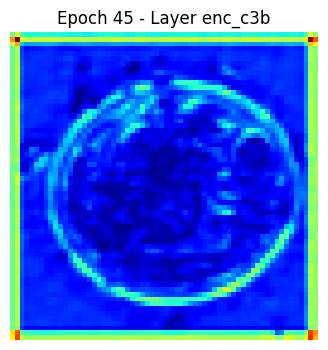

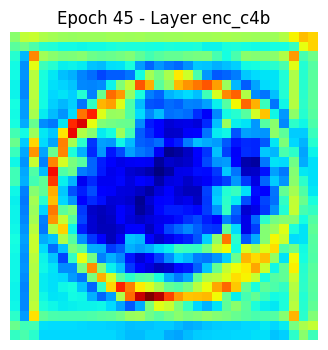

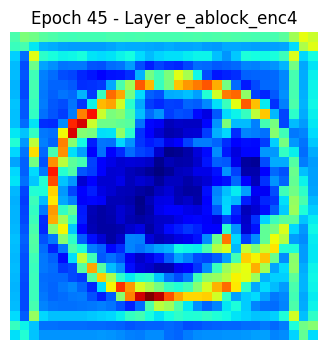

...

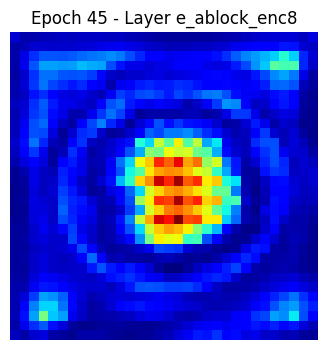

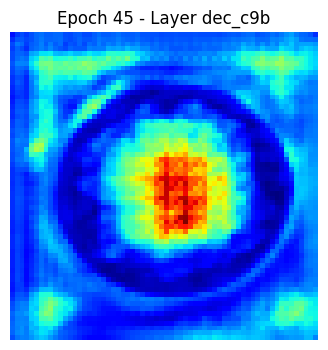

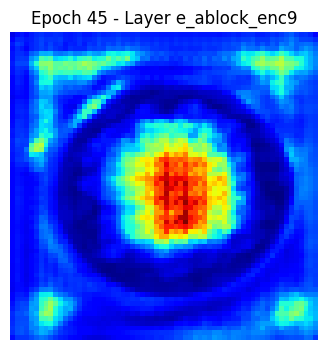

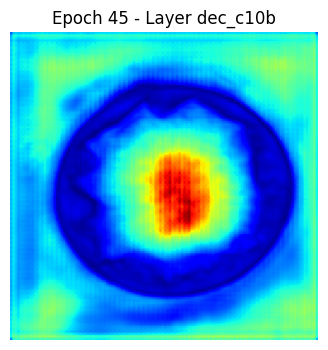

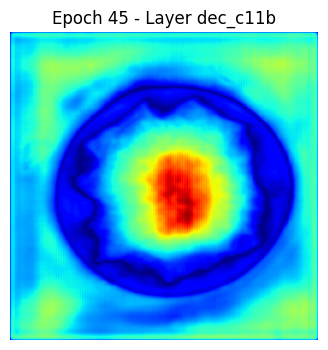

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8711 - dice_coefficient: 0.9311 - iou_metric: 0.8712 - loss: 0.1099 - val_accuracy: 0.8674 - val_dice_coefficient: 0.8231 - val_iou_metric: 0.7071 - val_loss: 0.3690
Epoch 46/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 438ms/step - accuracy: 0.8715 - dice_coefficient: 0.9306 - iou_metric: 0.8705 - loss: 0.1100 - val_accuracy: 0.8679 - val_dice_coefficient: 0.8279 - val_iou_metric: 0.7139 - val_loss: 0.3565
Epoch 47/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8708 - dice_coefficient: 0.9372 - iou_metric: 0.8819 - loss: 0.1000 - val_accuracy: 0.8692 - val_dice_coefficient: 0.8220 - val_iou_metric: 0.7065 - val_loss: 0.3830
Epoch 48/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accuracy: 0.8720 - dice_coefficient: 0.9397 - iou_metric: 0.8863 - loss: 0.0958 - val_accuracy: 0.8686 - val_dice_coefficient: 0.8263 - val_iou_metric: 0.7121 - val_loss: 0.3668
Epoch 49/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accura

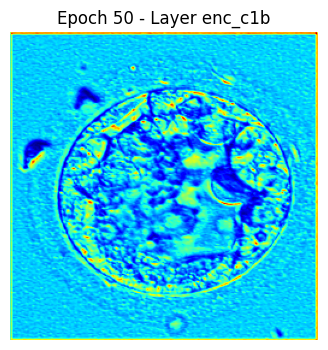

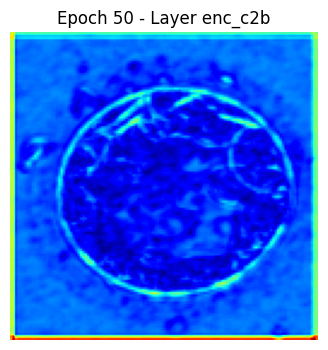

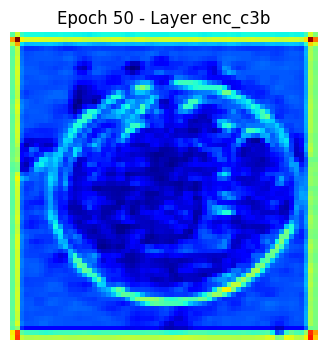

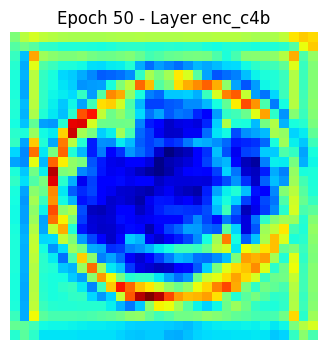

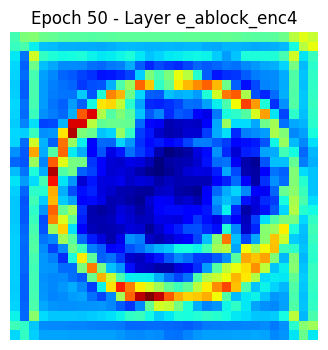

...

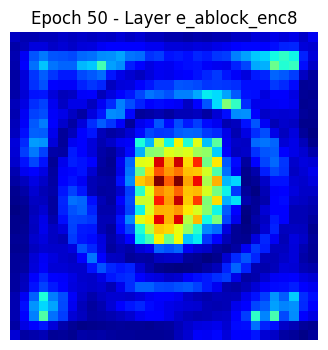

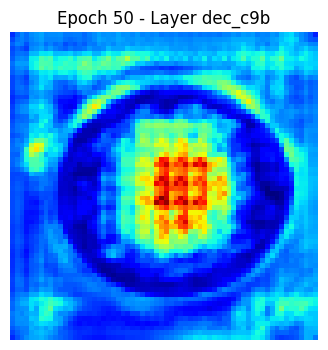

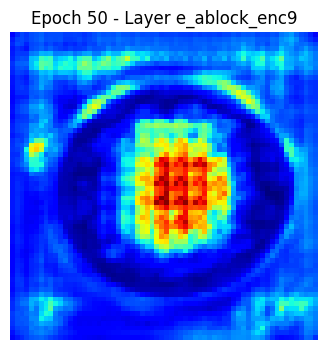

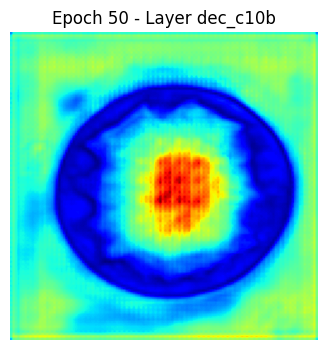

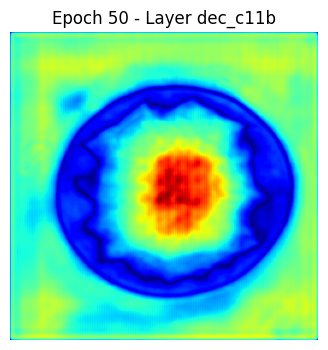

100/100 ━━━━━━━━━━━━━━━━━━━━ 46s 454ms/step - accuracy: 0.8721 - dice_coefficient: 0.9450 - iou_metric: 0.8958 - loss: 0.0870 - val_accuracy: 0.8675 - val_dice_coefficient: 0.8287 - val_iou_metric: 0.7155 - val_loss: 0.3815
Epoch 51/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8724 - dice_coefficient: 0.9478 - iou_metric: 0.9008 - loss: 0.0822 - val_accuracy: 0.8689 - val_dice_coefficient: 0.8285 - val_iou_metric: 0.7152 - val_loss: 0.3938
Epoch 52/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 442ms/step - accuracy: 0.8726 - dice_coefficient: 0.9478 - iou_metric: 0.9009 - loss: 0.0823 - val_accuracy: 0.8683 - val_dice_coefficient: 0.8321 - val_iou_metric: 0.7207 - val_loss: 0.3801
Epoch 53/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8737 - dice_coefficient: 0.9501 - iou_metric: 0.9050 - loss: 0.0786 - val_accuracy: 0.8691 - val_dice_coefficient: 0.8268 - val_iou_metric: 0.7129 - val_loss: 0.3941
Epoch 54/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 440ms/step - accura

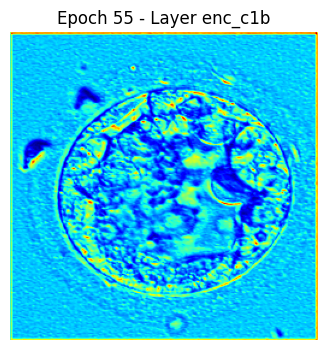

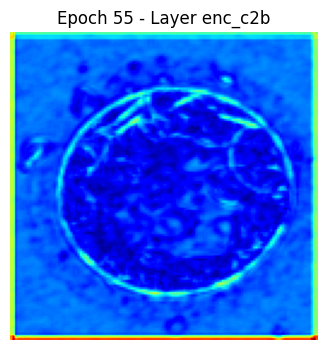

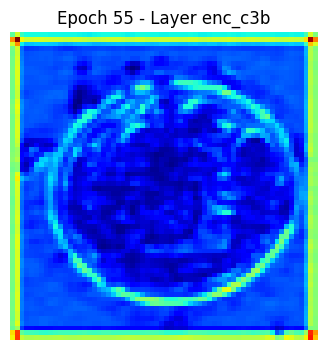

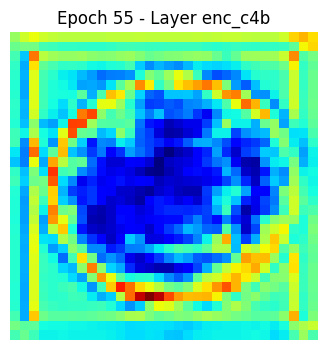

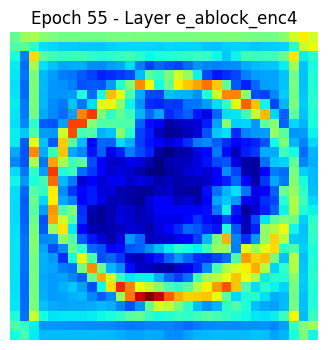

...

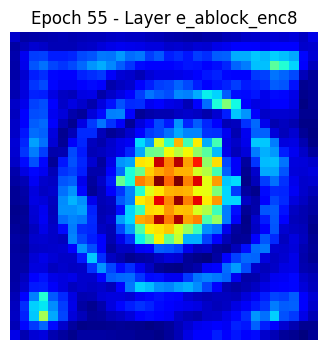

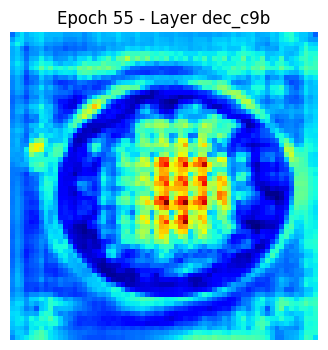

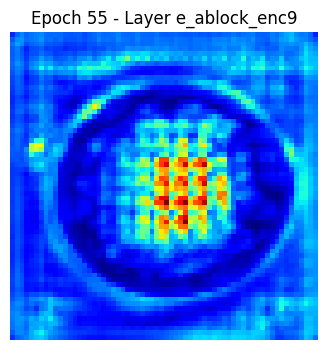

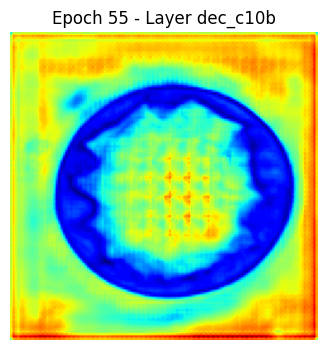

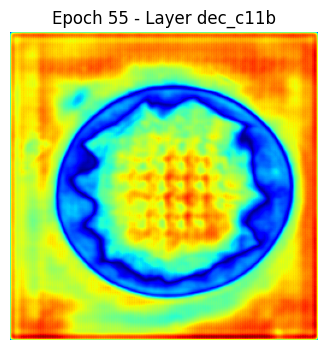

100/100 ━━━━━━━━━━━━━━━━━━━━ 45s 449ms/step - accuracy: 0.8738 - dice_coefficient: 0.9542 - iou_metric: 0.9124 - loss: 0.0718 - val_accuracy: 0.8680 - val_dice_coefficient: 0.8342 - val_iou_metric: 0.7237 - val_loss: 0.3930
Epoch 56/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8745 - dice_coefficient: 0.9576 - iou_metric: 0.9186 - loss: 0.0664 - val_accuracy: 0.8687 - val_dice_coefficient: 0.8331 - val_iou_metric: 0.7221 - val_loss: 0.3966
Epoch 57/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 440ms/step - accuracy: 0.8745 - dice_coefficient: 0.9592 - iou_metric: 0.9217 - loss: 0.0639 - val_accuracy: 0.8685 - val_dice_coefficient: 0.8352 - val_iou_metric: 0.7253 - val_loss: 0.4065
Epoch 58/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 439ms/step - accuracy: 0.8740 - dice_coefficient: 0.9620 - iou_metric: 0.9268 - loss: 0.0597 - val_accuracy: 0.8682 - val_dice_coefficient: 0.8357 - val_iou_metric: 0.7260 - val_loss: 0.4030
Epoch 59/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accura

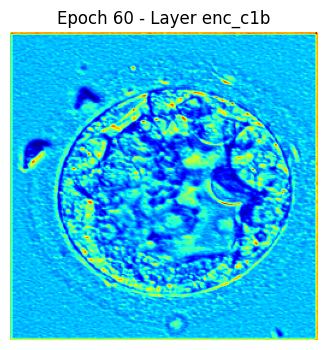

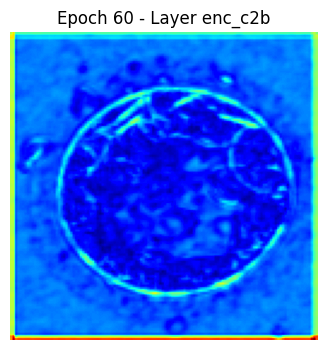

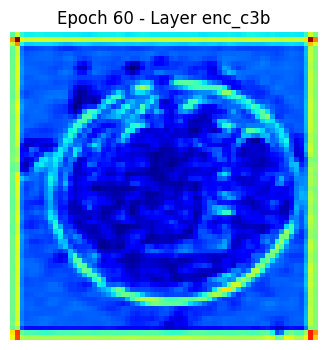

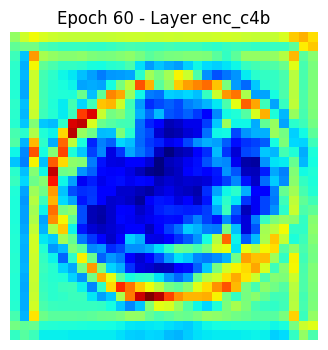

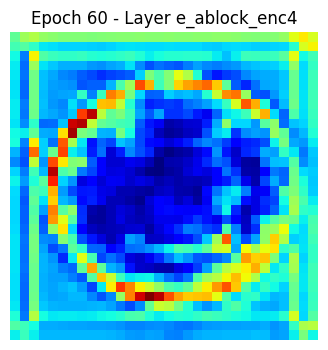

...

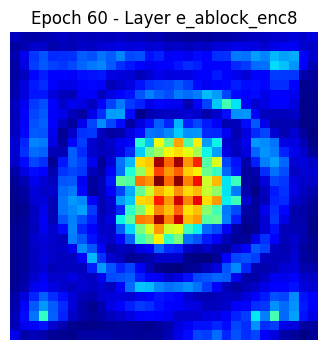

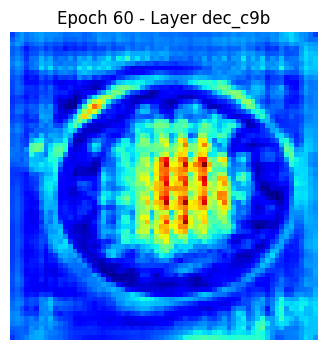

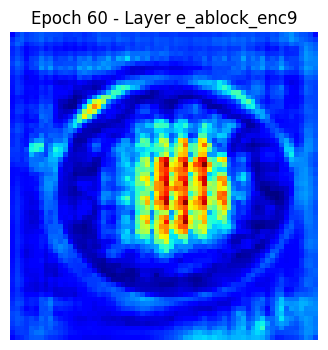

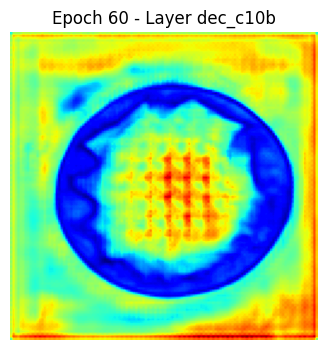

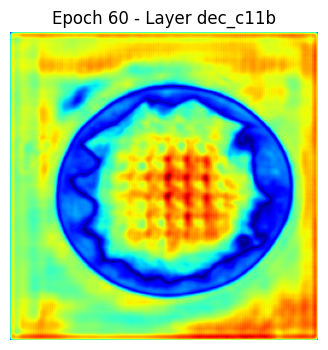

100/100 ━━━━━━━━━━━━━━━━━━━━ 46s 455ms/step - accuracy: 0.8745 - dice_coefficient: 0.9628 - iou_metric: 0.9283 - loss: 0.0582 - val_accuracy: 0.8670 - val_dice_coefficient: 0.8361 - val_iou_metric: 0.7266 - val_loss: 0.4053
Epoch 61/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 44s 438ms/step - accuracy: 0.8740 - dice_coefficient: 0.9645 - iou_metric: 0.9315 - loss: 0.0554 - val_accuracy: 0.8680 - val_dice_coefficient: 0.8385 - val_iou_metric: 0.7302 - val_loss: 0.4192
Epoch 62/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8732 - dice_coefficient: 0.9658 - iou_metric: 0.9339 - loss: 0.0539 - val_accuracy: 0.8682 - val_dice_coefficient: 0.8342 - val_iou_metric: 0.7240 - val_loss: 0.4306
Epoch 63/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8743 - dice_coefficient: 0.9660 - iou_metric: 0.9342 - loss: 0.0534 - val_accuracy: 0.8690 - val_dice_coefficient: 0.8372 - val_iou_metric: 0.7285 - val_loss: 0.4267
Epoch 64/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accura

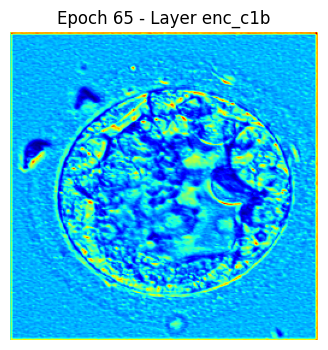

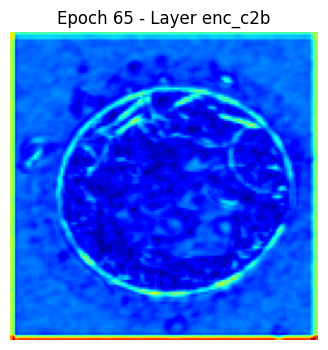

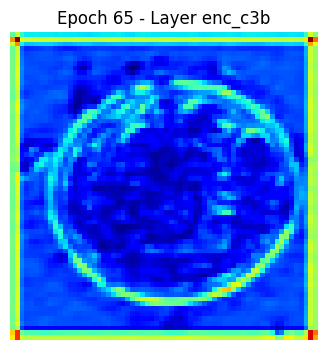

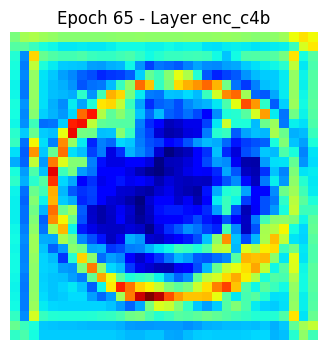

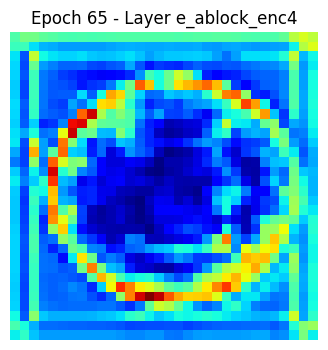

...

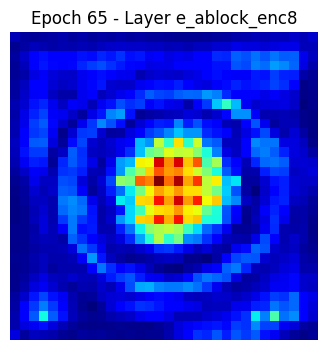

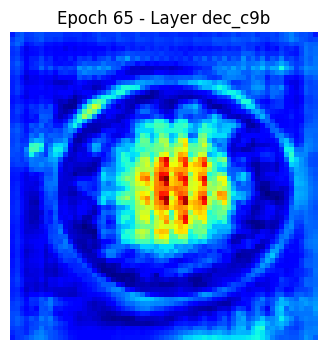

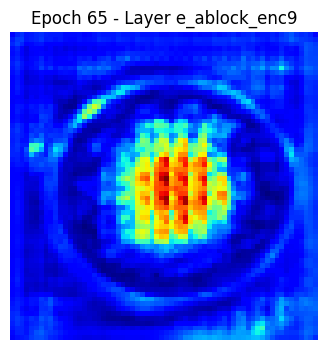

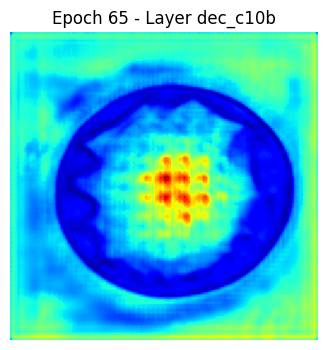

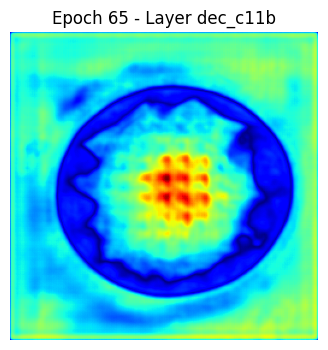

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 413ms/step - accuracy: 0.8745 - dice_coefficient: 0.9687 - iou_metric: 0.9393 - loss: 0.0491 - val_accuracy: 0.8686 - val_dice_coefficient: 0.8371 - val_iou_metric: 0.7285 - val_loss: 0.4432
Epoch 66/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8739 - dice_coefficient: 0.9698 - iou_metric: 0.9415 - loss: 0.0473 - val_accuracy: 0.8675 - val_dice_coefficient: 0.8370 - val_iou_metric: 0.7280 - val_loss: 0.4285
Epoch 67/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8749 - dice_coefficient: 0.9705 - iou_metric: 0.9427 - loss: 0.0459 - val_accuracy: 0.8681 - val_dice_coefficient: 0.8363 - val_iou_metric: 0.7270 - val_loss: 0.4412
Epoch 68/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8747 - dice_coefficient: 0.9711 - iou_metric: 0.9438 - loss: 0.0452 - val_accuracy: 0.8692 - val_dice_coefficient: 0.8342 - val_iou_metric: 0.7242 - val_loss: 0.4553
Epoch 69/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accura

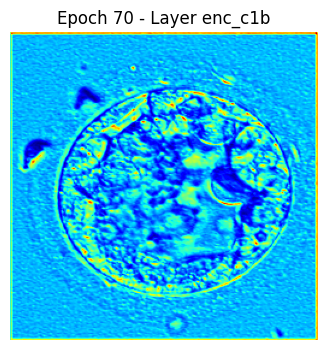

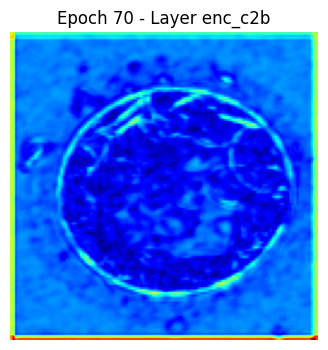

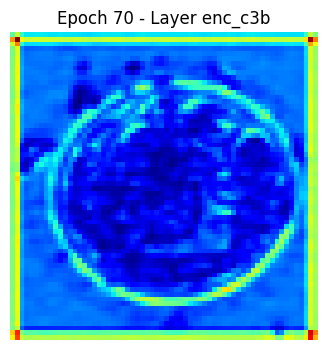

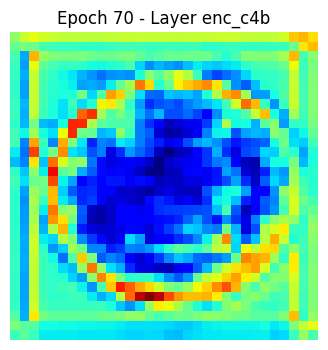

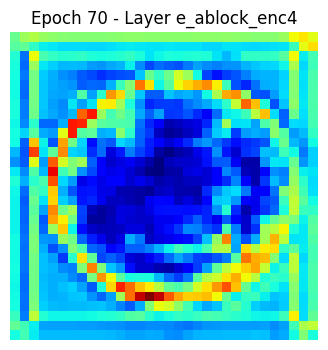

...

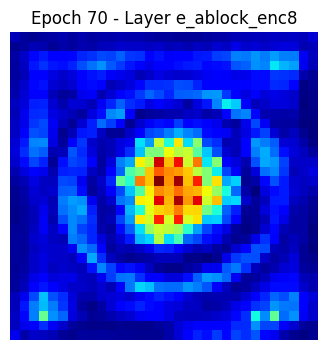

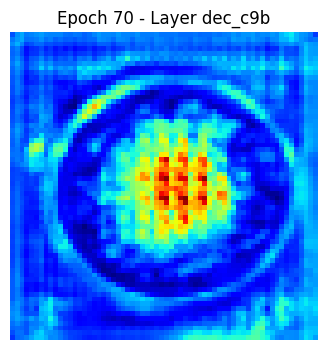

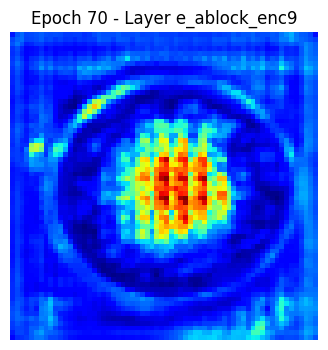

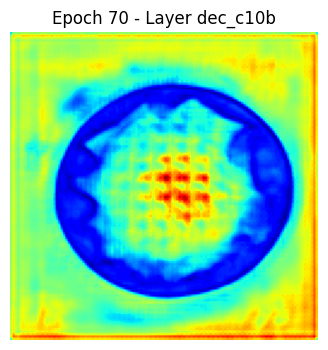

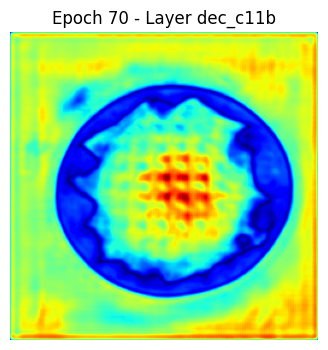

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8739 - dice_coefficient: 0.9719 - iou_metric: 0.9453 - loss: 0.0440 - val_accuracy: 0.8692 - val_dice_coefficient: 0.8364 - val_iou_metric: 0.7273 - val_loss: 0.4405
Epoch 71/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8747 - dice_coefficient: 0.9717 - iou_metric: 0.9449 - loss: 0.0443 - val_accuracy: 0.8692 - val_dice_coefficient: 0.8365 - val_iou_metric: 0.7271 - val_loss: 0.4370


Model: "UNet_with_IEA"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ e_ablock_enc4       │ (None, 32, 32,    │  2,623,488 │ enc_c4b[0][0]     │
│ (EAblock)           │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ e_ablock_enc4[0]… │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c5a (Conv2D)    │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c5b (Conv2D)    │ (None, 16, 16,    │  9,438,208 │ enc_c5a[0][0]     │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ e_ablock_enc5       │ (None, 16, 16,    │ 10,489,856 │ enc_c5b[0][0]   

 Total params: 359,366,597 (1.34 GB)

 Trainable params: 119,788,865 (456.96 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 239,577,732 (913.92 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 4: 2965.16s

--- Fold 5 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 91s 567ms/step - accuracy: 0.8134 - dice_coefficient: 0.1826 - iou_metric: 0.1012 - loss: 1.3094 - val_accuracy: 0.7910 - val_dice_coefficient: 0.3877 - val_iou_metric: 0.2408 - val_loss: 0.8485
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 402ms/step - accuracy: 0.8080 - dice_coefficient: 0.5097 - iou_metric: 0.3455 - loss: 0.7185 - val_accuracy: 0.8613 - val_dice_coefficient: 0.5245 - val_iou_metric: 0.3582 - val_loss: 0.6870
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 0.8229 - dice_coefficient: 0.5992 - iou_metric: 0.4297 - loss: 0.6199 - val_accuracy: 0.8439 - val_dice_coefficient: 0.6398 - val_iou_metric: 0.4715 - val_loss: 0.5324
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 0.8349 - dice_coefficient: 0.6878 - iou_metric: 0.5251 - loss: 0.4954 - val_accuracy: 0.8446

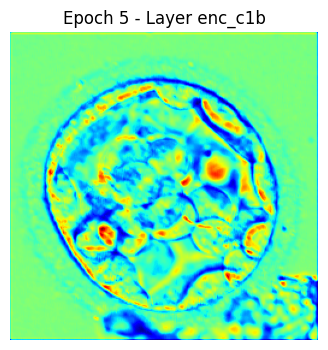

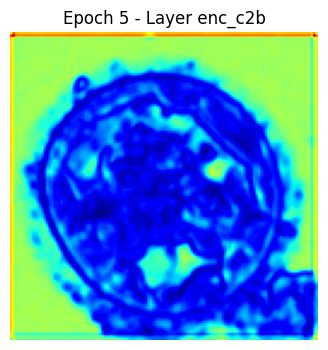

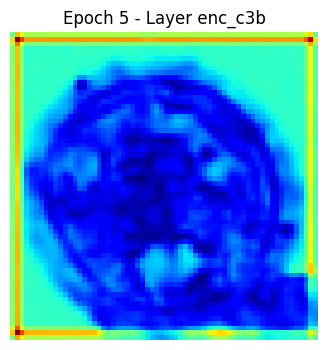

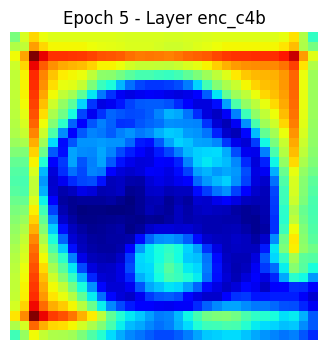

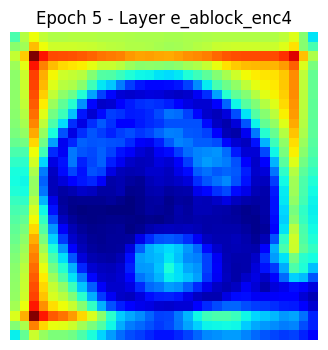

...

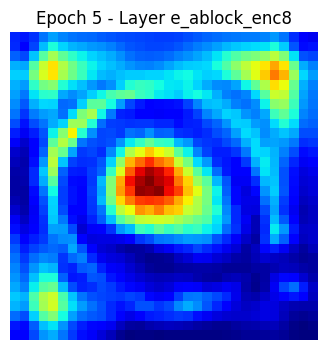

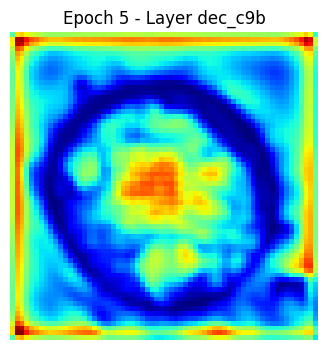

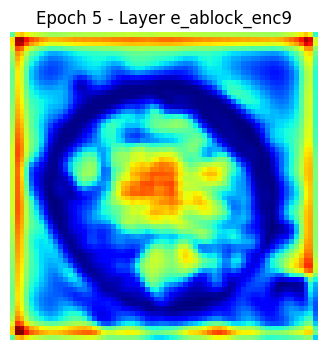

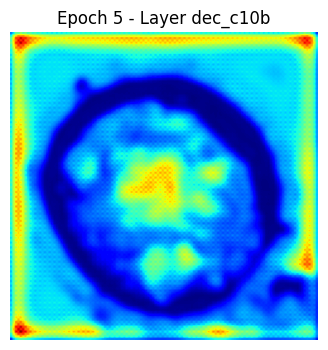

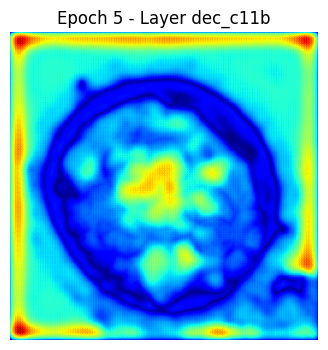

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 412ms/step - accuracy: 0.8405 - dice_coefficient: 0.7083 - iou_metric: 0.5490 - loss: 0.4598 - val_accuracy: 0.8569 - val_dice_coefficient: 0.6464 - val_iou_metric: 0.4785 - val_loss: 0.4979
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accuracy: 0.8428 - dice_coefficient: 0.7186 - iou_metric: 0.5620 - loss: 0.4403 - val_accuracy: 0.8520 - val_dice_coefficient: 0.7098 - val_iou_metric: 0.5514 - val_loss: 0.4239
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 0.8441 - dice_coefficient: 0.7421 - iou_metric: 0.5909 - loss: 0.4086 - val_accuracy: 0.8580 - val_dice_coefficient: 0.7302 - val_iou_metric: 0.5768 - val_loss: 0.4071
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8467 - dice_coefficient: 0.7564 - iou_metric: 0.6090 - loss: 0.3854 - val_accuracy: 0.8557 - val_dice_coefficient: 0.7285 - val_iou_metric: 0.5745 - val_loss: 0.3990
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 

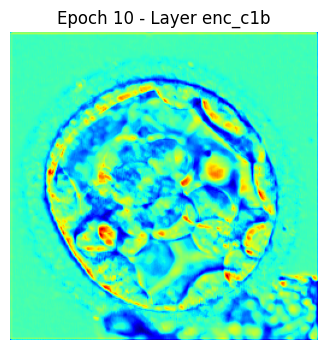

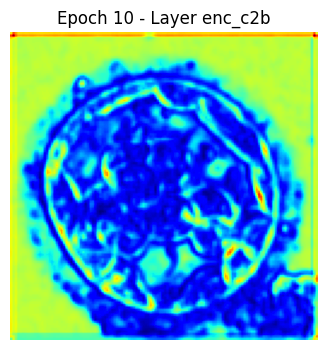

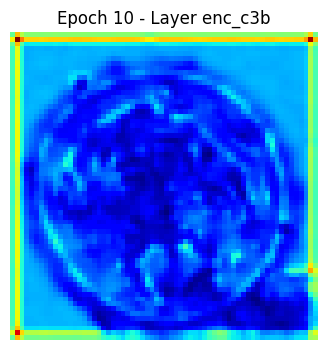

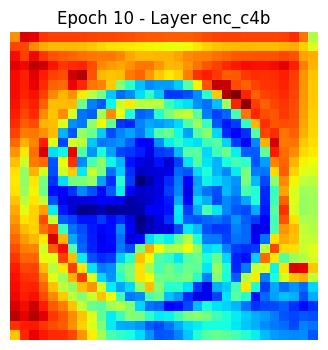

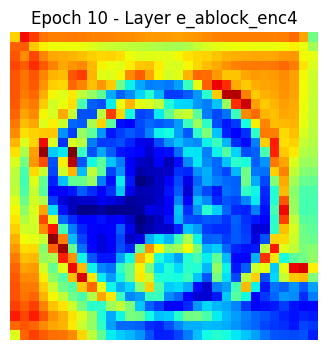

...

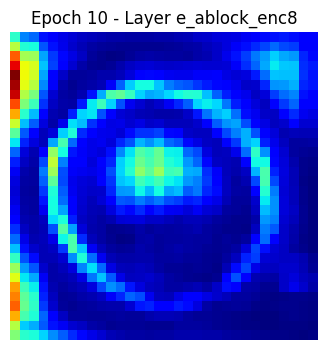

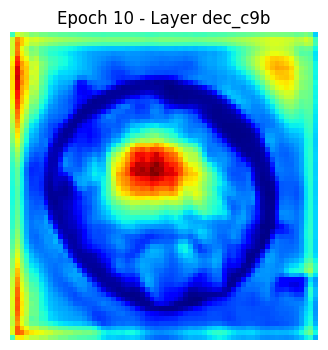

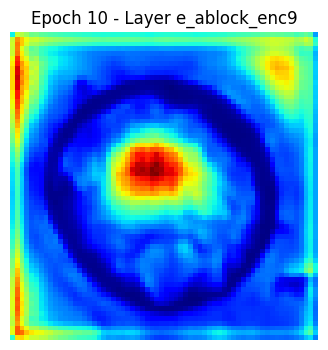

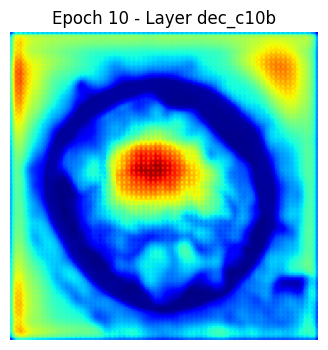

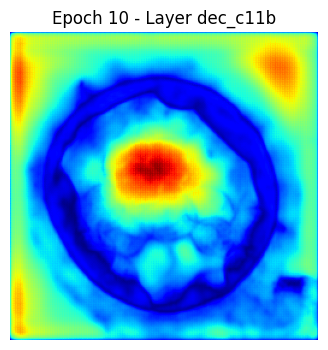

100/100 ━━━━━━━━━━━━━━━━━━━━ 42s 416ms/step - accuracy: 0.8509 - dice_coefficient: 0.7757 - iou_metric: 0.6342 - loss: 0.3533 - val_accuracy: 0.8550 - val_dice_coefficient: 0.7567 - val_iou_metric: 0.6104 - val_loss: 0.3744
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8508 - dice_coefficient: 0.7831 - iou_metric: 0.6443 - loss: 0.3417 - val_accuracy: 0.8593 - val_dice_coefficient: 0.7497 - val_iou_metric: 0.6016 - val_loss: 0.3737
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8529 - dice_coefficient: 0.7896 - iou_metric: 0.6532 - loss: 0.3339 - val_accuracy: 0.8585 - val_dice_coefficient: 0.7509 - val_iou_metric: 0.6031 - val_loss: 0.3725
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 0.8526 - dice_coefficient: 0.7960 - iou_metric: 0.6619 - loss: 0.3243 - val_accuracy: 0.8622 - val_dice_coefficient: 0.7587 - val_iou_metric: 0.6134 - val_loss: 0.3701
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accura

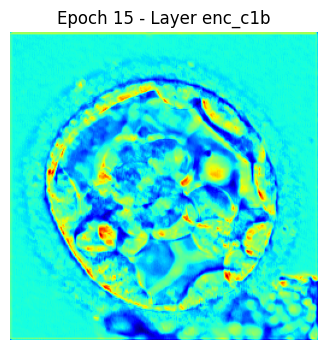

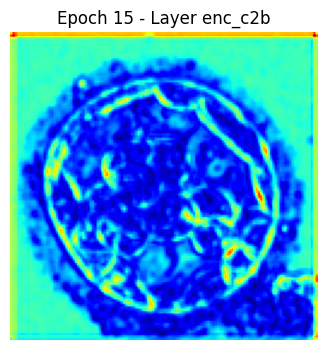

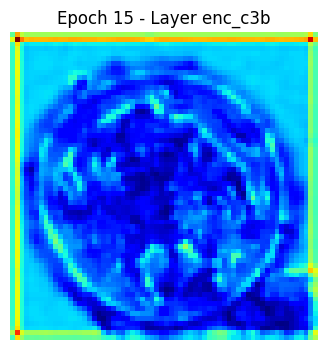

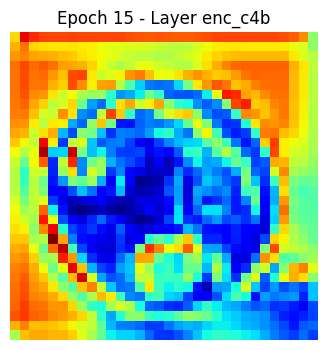

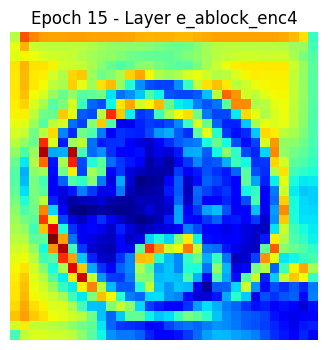

...

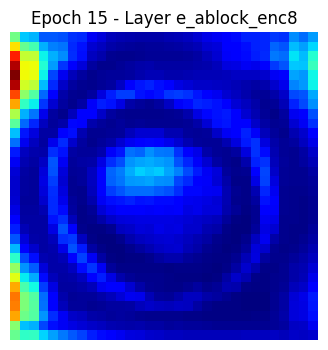

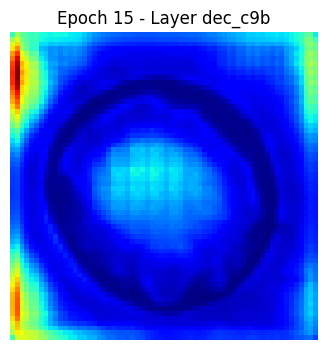

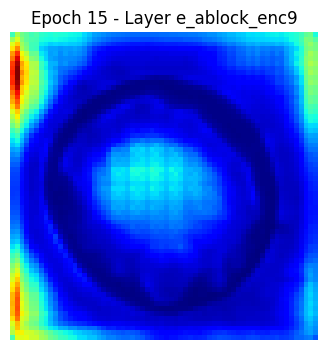

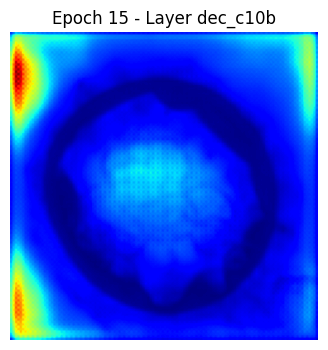

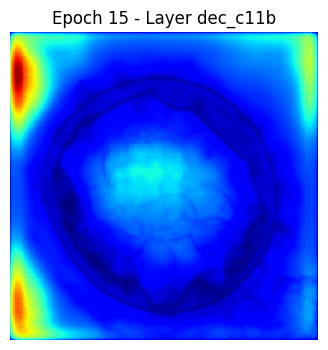

100/100 ━━━━━━━━━━━━━━━━━━━━ 42s 416ms/step - accuracy: 0.8558 - dice_coefficient: 0.8083 - iou_metric: 0.6791 - loss: 0.3037 - val_accuracy: 0.8618 - val_dice_coefficient: 0.7785 - val_iou_metric: 0.6398 - val_loss: 0.3508
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8551 - dice_coefficient: 0.8144 - iou_metric: 0.6877 - loss: 0.2993 - val_accuracy: 0.8600 - val_dice_coefficient: 0.7778 - val_iou_metric: 0.6385 - val_loss: 0.3429
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8562 - dice_coefficient: 0.8208 - iou_metric: 0.6970 - loss: 0.2875 - val_accuracy: 0.8635 - val_dice_coefficient: 0.7758 - val_iou_metric: 0.6361 - val_loss: 0.3631
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 0.8574 - dice_coefficient: 0.8273 - iou_metric: 0.7061 - loss: 0.2766 - val_accuracy: 0.8600 - val_dice_coefficient: 0.7827 - val_iou_metric: 0.6452 - val_loss: 0.3526
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accura

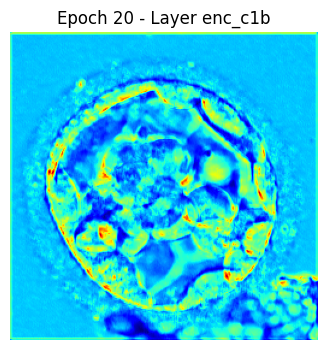

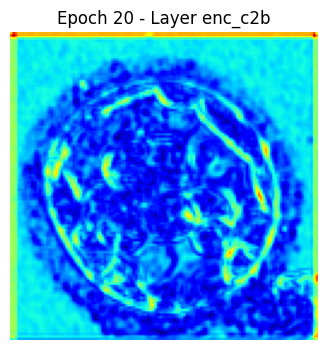

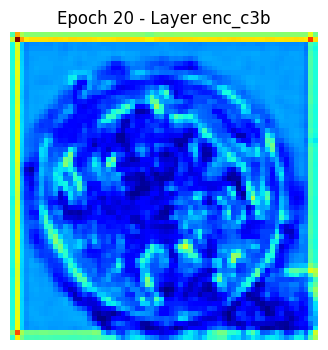

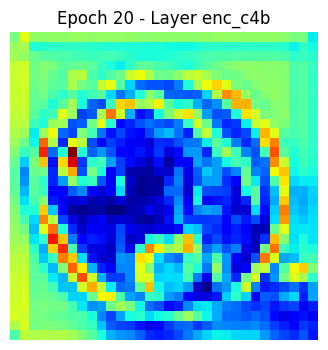

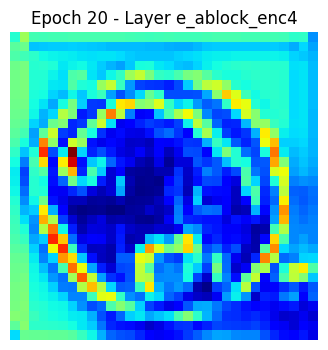

...

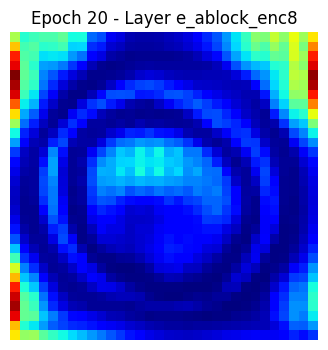

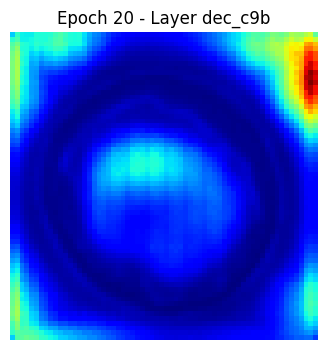

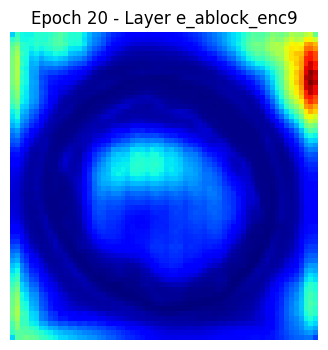

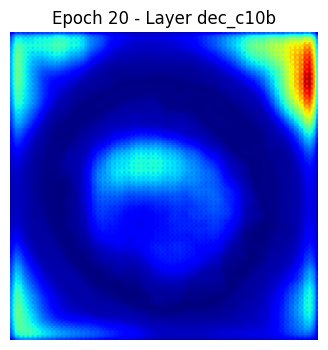

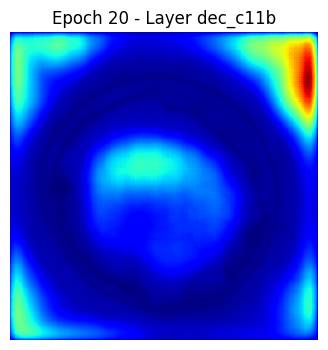

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 414ms/step - accuracy: 0.8582 - dice_coefficient: 0.8283 - iou_metric: 0.7079 - loss: 0.2730 - val_accuracy: 0.8617 - val_dice_coefficient: 0.7734 - val_iou_metric: 0.6335 - val_loss: 0.3900
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 404ms/step - accuracy: 0.8584 - dice_coefficient: 0.8375 - iou_metric: 0.7209 - loss: 0.2615 - val_accuracy: 0.8624 - val_dice_coefficient: 0.7884 - val_iou_metric: 0.6533 - val_loss: 0.3496
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8588 - dice_coefficient: 0.8457 - iou_metric: 0.7335 - loss: 0.2486 - val_accuracy: 0.8656 - val_dice_coefficient: 0.7336 - val_iou_metric: 0.5821 - val_loss: 0.4523
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8608 - dice_coefficient: 0.8453 - iou_metric: 0.7329 - loss: 0.2476 - val_accuracy: 0.8611 - val_dice_coefficient: 0.7706 - val_iou_metric: 0.6291 - val_loss: 0.3596
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accura

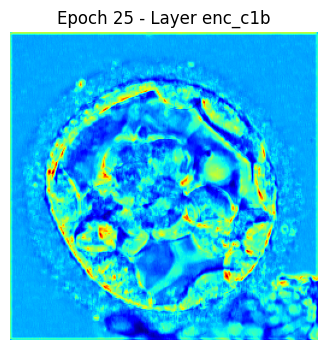

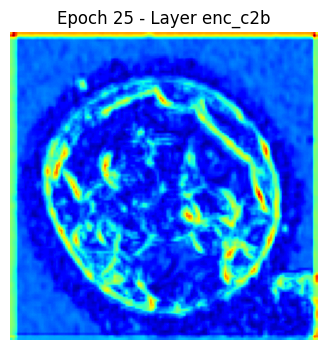

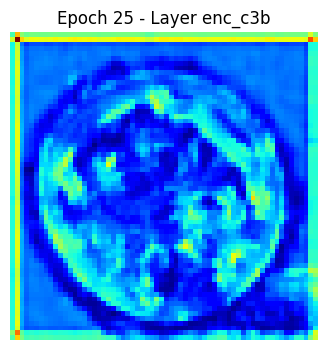

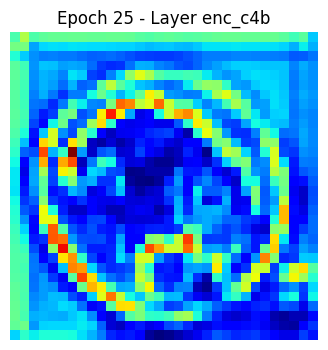

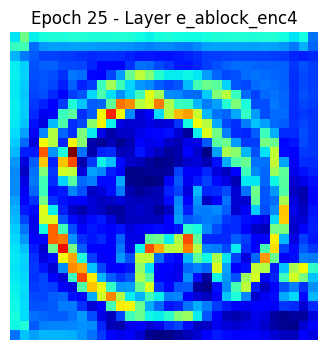

...

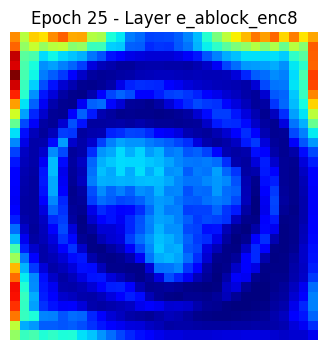

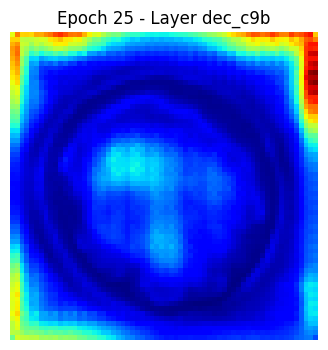

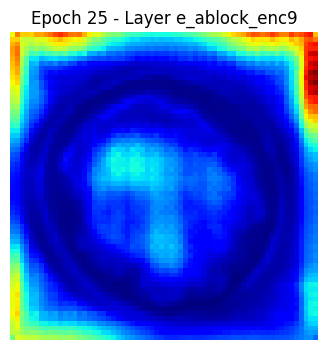

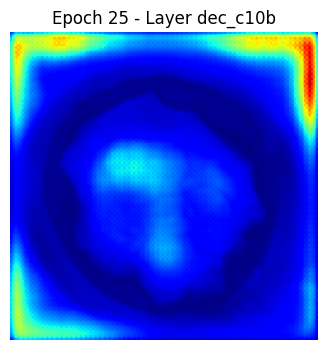

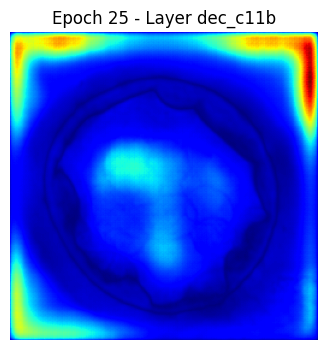

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 413ms/step - accuracy: 0.8610 - dice_coefficient: 0.8599 - iou_metric: 0.7549 - loss: 0.2246 - val_accuracy: 0.8611 - val_dice_coefficient: 0.7703 - val_iou_metric: 0.6292 - val_loss: 0.3892
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 400ms/step - accuracy: 0.8626 - dice_coefficient: 0.8603 - iou_metric: 0.7556 - loss: 0.2246 - val_accuracy: 0.8612 - val_dice_coefficient: 0.7778 - val_iou_metric: 0.6397 - val_loss: 0.3807
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accuracy: 0.8648 - dice_coefficient: 0.8690 - iou_metric: 0.7689 - loss: 0.2083 - val_accuracy: 0.8624 - val_dice_coefficient: 0.7643 - val_iou_metric: 0.6209 - val_loss: 0.3923
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 403ms/step - accuracy: 0.8623 - dice_coefficient: 0.8689 - iou_metric: 0.7688 - loss: 0.2090 - val_accuracy: 0.8617 - val_dice_coefficient: 0.7940 - val_iou_metric: 0.6609 - val_loss: 0.3503
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accura

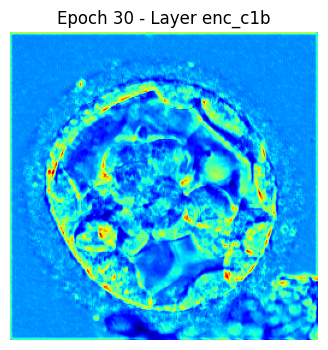

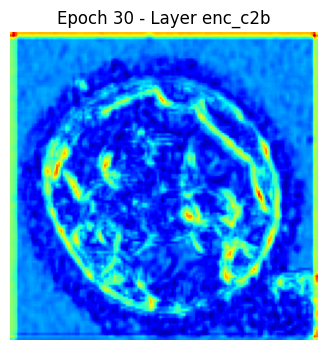

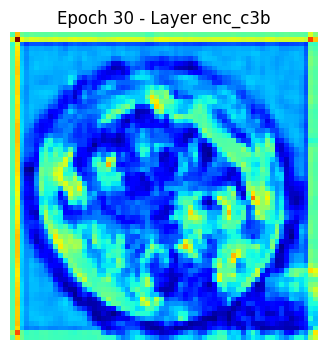

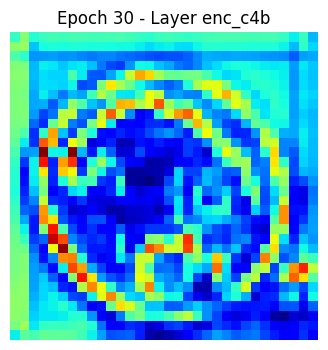

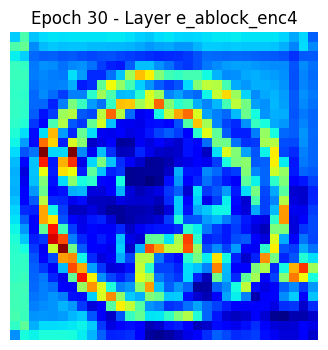

...

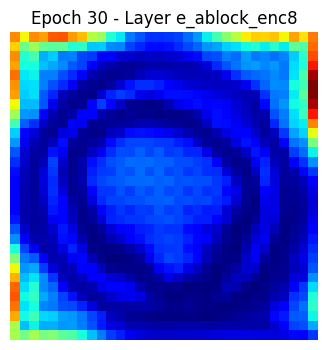

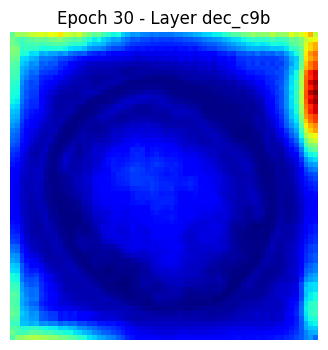

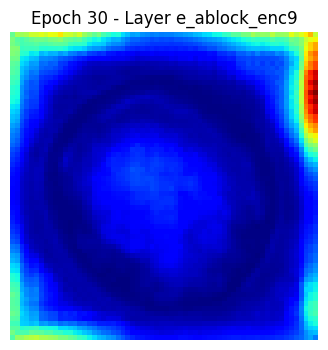

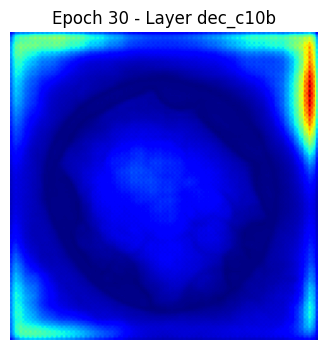

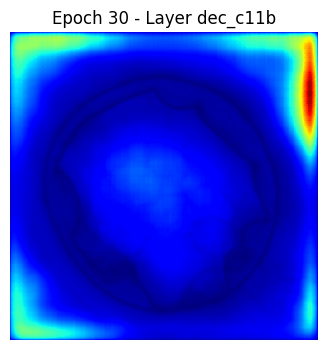

100/100 ━━━━━━━━━━━━━━━━━━━━ 42s 416ms/step - accuracy: 0.8647 - dice_coefficient: 0.8848 - iou_metric: 0.7939 - loss: 0.1862 - val_accuracy: 0.8623 - val_dice_coefficient: 0.8045 - val_iou_metric: 0.6760 - val_loss: 0.3453
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accuracy: 0.8664 - dice_coefficient: 0.8920 - iou_metric: 0.8056 - loss: 0.1727 - val_accuracy: 0.8650 - val_dice_coefficient: 0.7901 - val_iou_metric: 0.6556 - val_loss: 0.3741
Epoch 32/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 400ms/step - accuracy: 0.8667 - dice_coefficient: 0.8963 - iou_metric: 0.8126 - loss: 0.1659 - val_accuracy: 0.8671 - val_dice_coefficient: 0.7956 - val_iou_metric: 0.6642 - val_loss: 0.3820
Epoch 33/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accuracy: 0.8669 - dice_coefficient: 0.9014 - iou_metric: 0.8211 - loss: 0.1588 - val_accuracy: 0.8604 - val_dice_coefficient: 0.7954 - val_iou_metric: 0.6631 - val_loss: 0.3693
Epoch 34/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accura

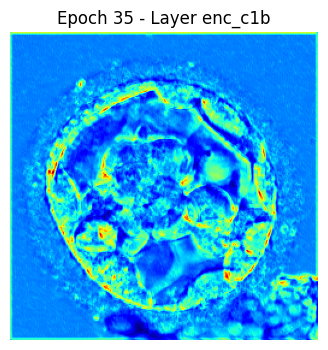

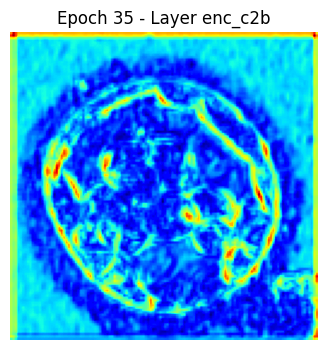

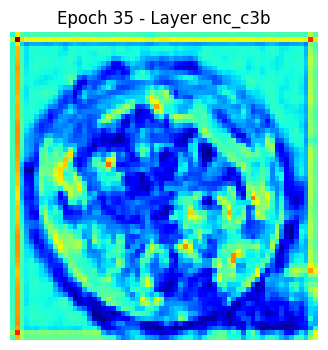

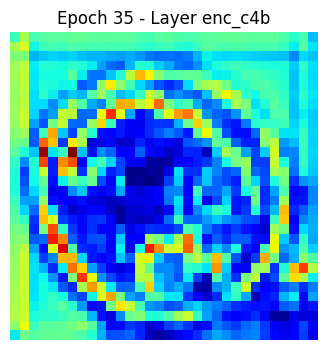

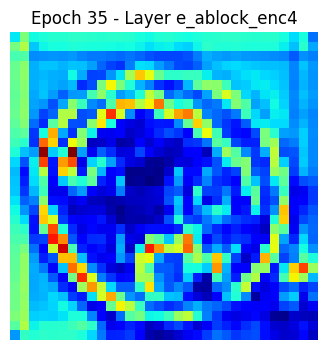

...

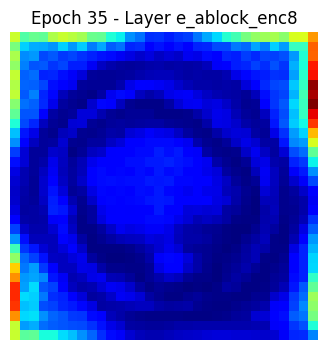

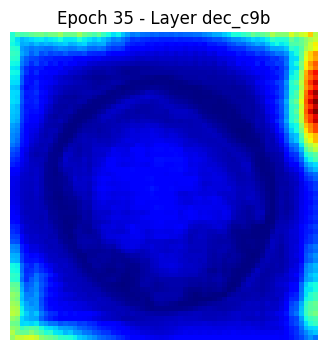

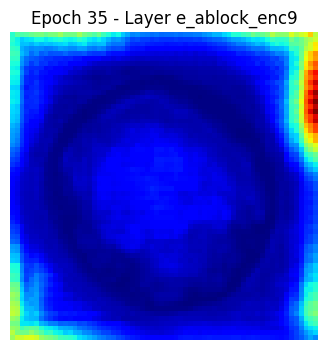

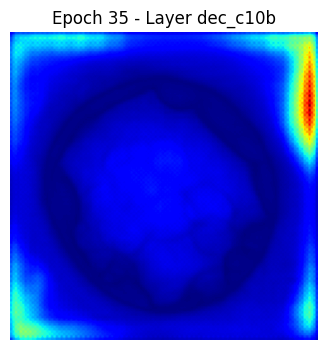

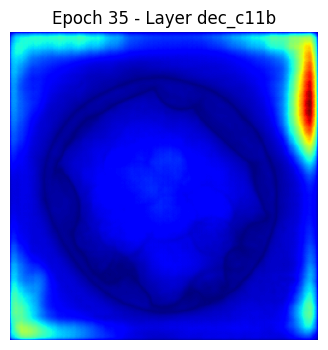

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 413ms/step - accuracy: 0.8669 - dice_coefficient: 0.9069 - iou_metric: 0.8301 - loss: 0.1490 - val_accuracy: 0.8648 - val_dice_coefficient: 0.8002 - val_iou_metric: 0.6698 - val_loss: 0.3645
Epoch 36/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 0.8681 - dice_coefficient: 0.9076 - iou_metric: 0.8312 - loss: 0.1478 - val_accuracy: 0.8637 - val_dice_coefficient: 0.8055 - val_iou_metric: 0.6774 - val_loss: 0.3589
Epoch 37/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 404ms/step - accuracy: 0.8687 - dice_coefficient: 0.9114 - iou_metric: 0.8374 - loss: 0.1415 - val_accuracy: 0.8607 - val_dice_coefficient: 0.8150 - val_iou_metric: 0.6905 - val_loss: 0.3518
Epoch 38/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accuracy: 0.8687 - dice_coefficient: 0.9164 - iou_metric: 0.8460 - loss: 0.1340 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8012 - val_iou_metric: 0.6714 - val_loss: 0.3738
Epoch 39/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accura

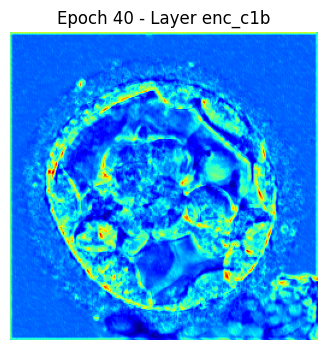

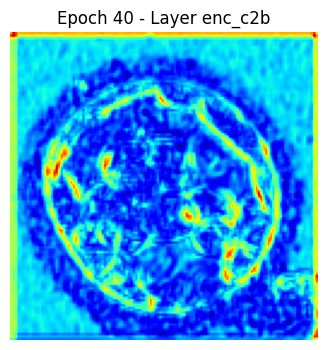

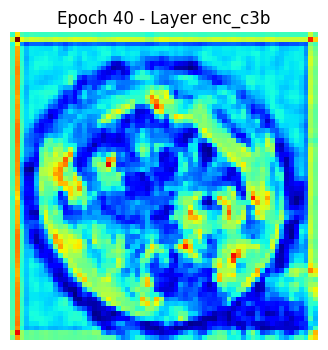

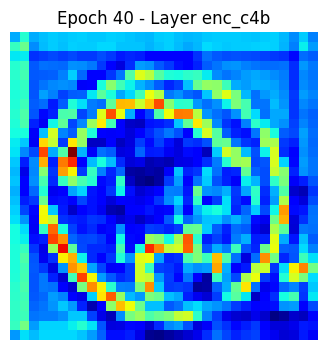

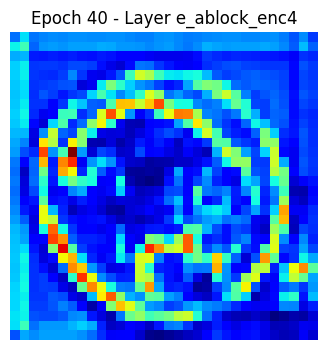

...

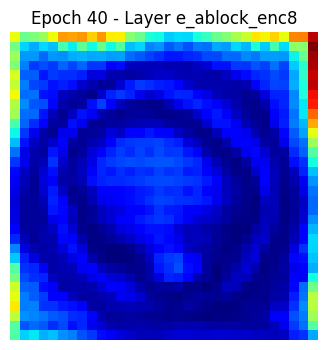

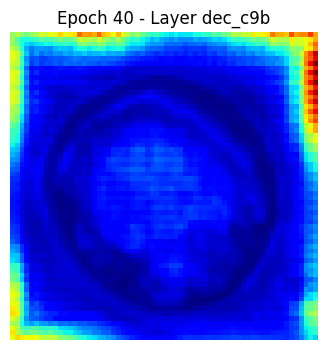

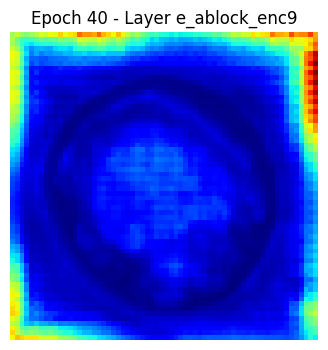

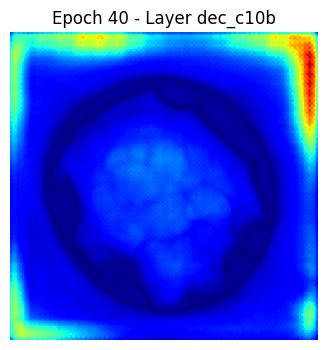

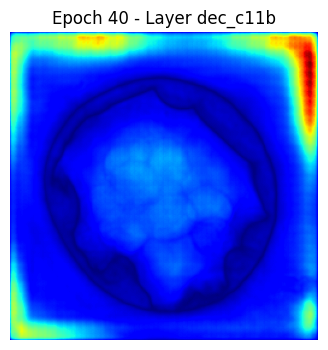

100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 414ms/step - accuracy: 0.8694 - dice_coefficient: 0.9227 - iou_metric: 0.8567 - loss: 0.1230 - val_accuracy: 0.8661 - val_dice_coefficient: 0.8013 - val_iou_metric: 0.6717 - val_loss: 0.3772
Epoch 41/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accuracy: 0.8699 - dice_coefficient: 0.9223 - iou_metric: 0.8560 - loss: 0.1242 - val_accuracy: 0.8611 - val_dice_coefficient: 0.8122 - val_iou_metric: 0.6867 - val_loss: 0.3640
Epoch 42/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accuracy: 0.8687 - dice_coefficient: 0.9257 - iou_metric: 0.8619 - loss: 0.1179 - val_accuracy: 0.8643 - val_dice_coefficient: 0.8090 - val_iou_metric: 0.6819 - val_loss: 0.3803
Epoch 43/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 402ms/step - accuracy: 0.8704 - dice_coefficient: 0.9283 - iou_metric: 0.8665 - loss: 0.1136 - val_accuracy: 0.8669 - val_dice_coefficient: 0.8010 - val_iou_metric: 0.6708 - val_loss: 0.3993
Epoch 44/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accura

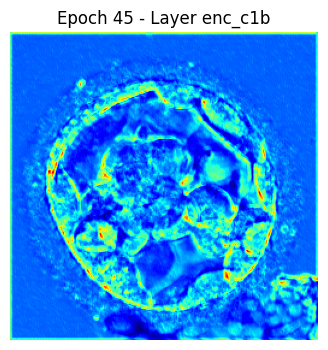

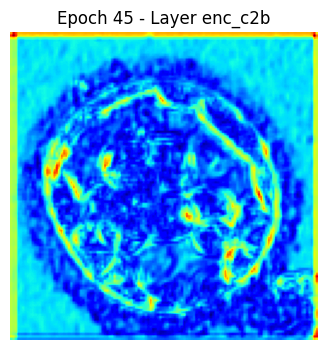

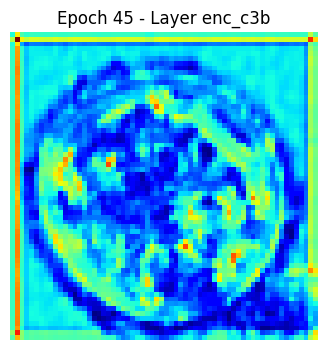

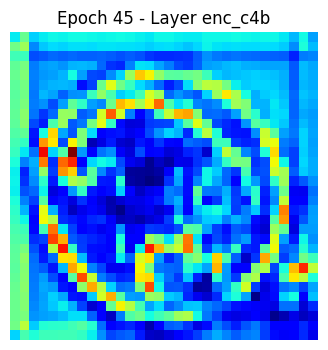

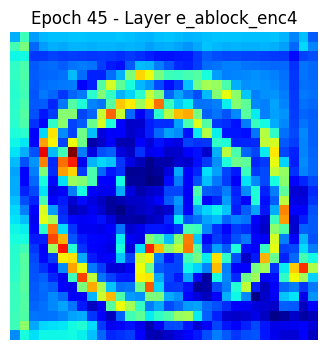

...

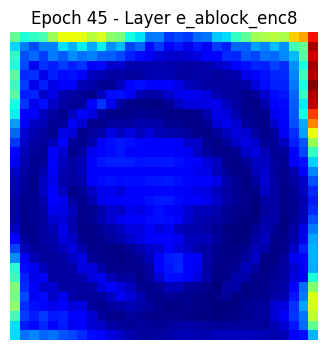

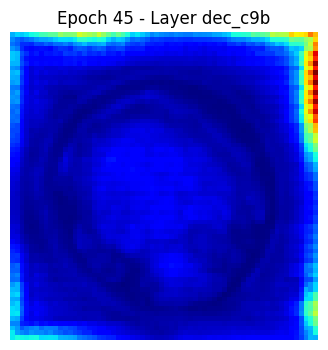

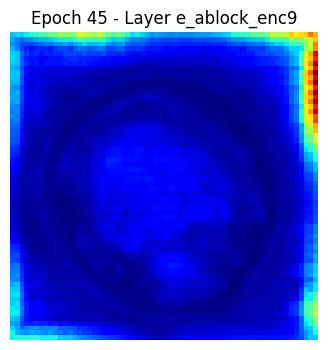

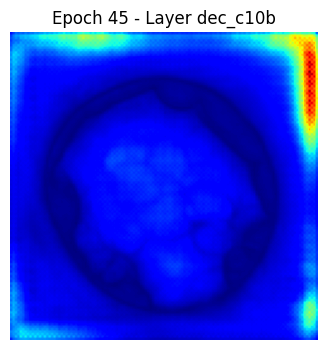

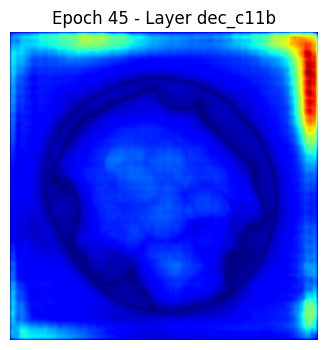

100/100 ━━━━━━━━━━━━━━━━━━━━ 42s 414ms/step - accuracy: 0.8701 - dice_coefficient: 0.9357 - iou_metric: 0.8792 - loss: 0.1023 - val_accuracy: 0.8668 - val_dice_coefficient: 0.8109 - val_iou_metric: 0.6852 - val_loss: 0.3817
Epoch 46/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accuracy: 0.8716 - dice_coefficient: 0.9343 - iou_metric: 0.8768 - loss: 0.1039 - val_accuracy: 0.8672 - val_dice_coefficient: 0.7993 - val_iou_metric: 0.6686 - val_loss: 0.4078
Epoch 47/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 40s 401ms/step - accuracy: 0.8713 - dice_coefficient: 0.9337 - iou_metric: 0.8758 - loss: 0.1047 - val_accuracy: 0.8661 - val_dice_coefficient: 0.8140 - val_iou_metric: 0.6892 - val_loss: 0.3965


Model: "UNet_with_IEA"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ e_ablock_enc4       │ (None, 32, 32,    │  2,623,488 │ enc_c4b[0][0]     │
│ (EAblock)           │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ e_ablock_enc4[0]… │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c5a (Conv2D)    │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c5b (Conv2D)    │ (None, 16, 16,    │  9,438,208 │ enc_c5a[0][0]     │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ e_ablock_enc5       │ (None, 16, 16,    │ 10,489,856 │ enc_c5b[0][0]   

 Total params: 359,366,597 (1.34 GB)

 Trainable params: 119,788,865 (456.96 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 239,577,732 (913.92 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 5: 1954.41s


In [15]:
# -------------------------
# Training loop with K-Fold
# -------------------------
EPOCHS = 300
BATCH_SIZE = 8

early_stopping = EarlyStopping(
    monitor='val_dice_coefficient',
    patience=10,
    mode='max',
    restore_best_weights=True
)

checkpoint = ModelCheckpoint(
    "best_model.h5",
    monitor='val_dice_coefficient',
    save_best_only=True,
    mode='max'
)

image_paths = np.array(sorted(glob.glob(os.path.join(TRAIN_IMAGES_DIR, "*.bmp"))))
mask_paths  = np.array(sorted(glob.glob(os.path.join(TRAIN_MASKS_DIR, "*.bmp"))))

kfold = KFold(n_splits=5, shuffle=True, random_state=42)
fold_num = 1

for train_idx, val_idx in kfold.split(image_paths):
    print(f"\n--- Fold {fold_num} ---")

    train_images, train_masks = image_paths[train_idx], mask_paths[train_idx]
    val_images, val_masks = image_paths[val_idx], mask_paths[val_idx]

    # -------------------------
    # Dataset creation
    # -------------------------
    def dataset_from_paths(images, masks, shuffle=True):
        dataset = tf.data.Dataset.from_tensor_slices((images, masks))
        dataset = dataset.map(load_image, num_parallel_calls=tf.data.AUTOTUNE)
        if shuffle:
            dataset = dataset.shuffle(100)
        return dataset.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

    train_dataset = dataset_from_paths(train_images, train_masks)
    val_dataset = dataset_from_paths(val_images, val_masks, shuffle=False)

    # -------------------------
    # Build model
    # -------------------------
    model = unet_with_iea(input_shape=(256,256,1))
    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
        loss=bce_dice_loss,
        metrics=['accuracy', dice_coefficient, iou_metric]
    )

    # -------------------------
    # Feature extractor for attention visualization
    # -------------------------

    layer_names = [
        'enc_c1b',
        'enc_c2b',
        'enc_c3b',
        'enc_c4b',
        'e_ablock_enc4',
        'enc_c5b',
        'e_ablock_enc5',
        'enc_c6b',
        'e_ablock_enc6',
        'dec_c7b',
        'e_ablock_enc7',
        'dec_c8b',
        'e_ablock_enc8',
        'dec_c9b',
        'e_ablock_enc9',
        'dec_c10b',
        'dec_c11b'
    ]


    intermediate_outputs = [model.get_layer(name).output for name in layer_names]
    feature_model = tf.keras.Model(inputs=model.input, outputs=intermediate_outputs)

    # Sample image for attention visualization
    sample_image = load_only_image(val_images[0])
    sample_image = tf.expand_dims(sample_image, axis=0)  # Add batch dimension

    # -------------------------
    # Custom callback for attention maps
    # -------------------------
    class AttentionMapLogger(tf.keras.callbacks.Callback):
        def __init__(self, sample_image, every_n_epochs=5):
            super().__init__()
            self.sample_image = sample_image
            self.every_n_epochs = every_n_epochs

        def on_epoch_end(self, epoch, logs=None):
            if (epoch + 1) % self.every_n_epochs == 0:
                attention_features = feature_model(self.sample_image, training=False)
                for i, fmap in enumerate(attention_features):
                    fmap_mean = tf.reduce_mean(fmap, axis=-1)  # average over channels
                    fmap_img = tf.squeeze(fmap_mean).numpy()
                    plt.figure(figsize=(4,4))
                    plt.imshow(fmap_img, cmap='jet')
                    plt.title(f"Epoch {epoch+1} - Layer {layer_names[i]}")
                    plt.axis('off')
                    plt.show()

    attention_logger = AttentionMapLogger(sample_image, every_n_epochs=5)

    # -------------------------
    # Train
    # -------------------------
    start_time = time.time()
    history = model.fit(
        train_dataset,
        validation_data=val_dataset,
        epochs=EPOCHS,
        callbacks=[early_stopping, checkpoint, attention_logger]
    )
    end_time = time.time()

    # -------------------------
    # Model summary, GFLOPs, training time
    # -------------------------
    model.summary()
    try:
        from tensorflow.python.profiler import model_analyzer
        from tensorflow.python.profiler.option_builder import ProfileOptionBuilder
        profile = model_analyzer.profile(
            model, options=ProfileOptionBuilder.float_operation()
        )
        print(f"GFLOPs: {profile.total_float_ops / 1e9}")
    except:
        print("GFLOPs calculation not available, use tensorflow profiler for exact computation.")

    print(f"Training time for fold {fold_num}: {end_time - start_time:.2f}s")
    fold_num += 1


In [16]:
# -------------------------
# Load best model
# -------------------------
model = unet_with_iea(input_shape=(256, 256, 1))
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
              loss=bce_dice_loss,
              metrics=['accuracy', dice_coefficient, iou_metric])

model.load_weights("best_model.h5")


# -------------------------
# Evaluate on test set
# -------------------------
results = model.evaluate(test_dataset)
print("\nTest Results:")
for name, value in zip(model.metrics_names, results):
    print(f"{name}: {value:.4f}")

25/25 ━━━━━━━━━━━━━━━━━━━━ 9s 27ms/step - accuracy: 0.9627 - dice_coefficient: 0.8429 - iou_metric: 0.7322 - loss: 0.4203

Test Results:
loss: 0.3756
compile_metrics: 0.9664


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


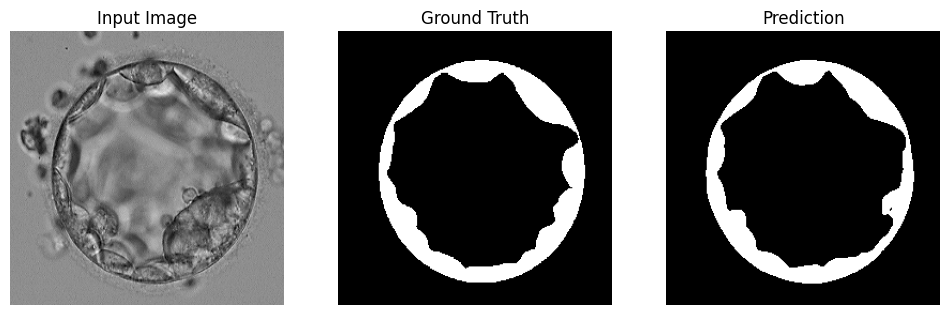

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


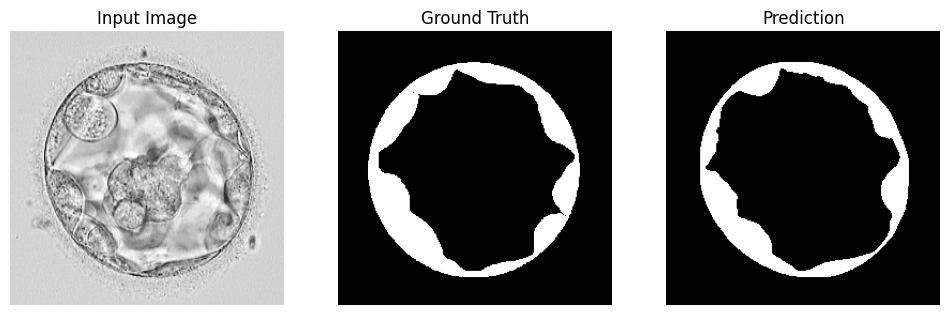

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


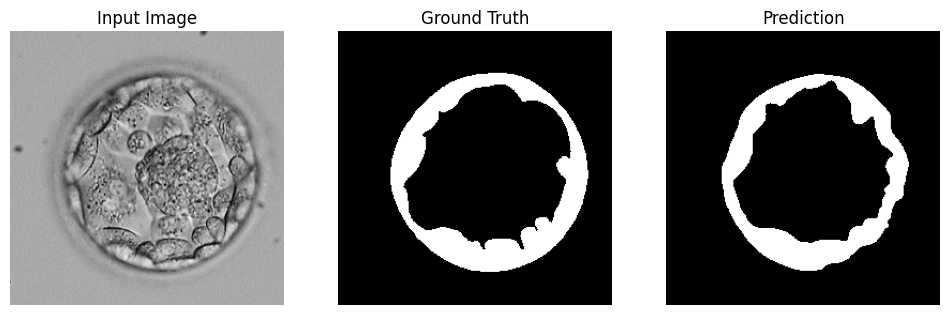

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


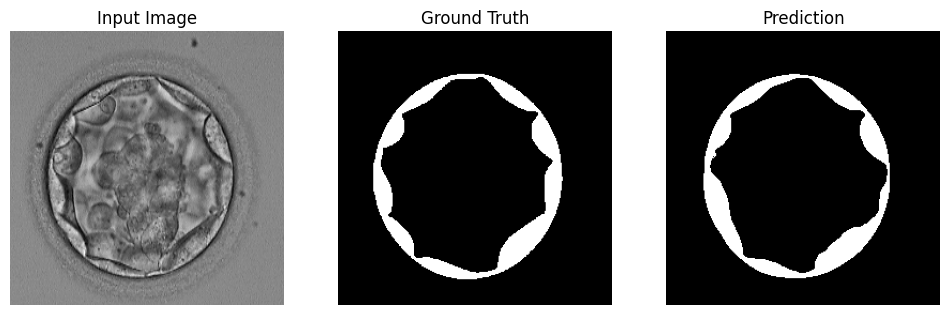

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


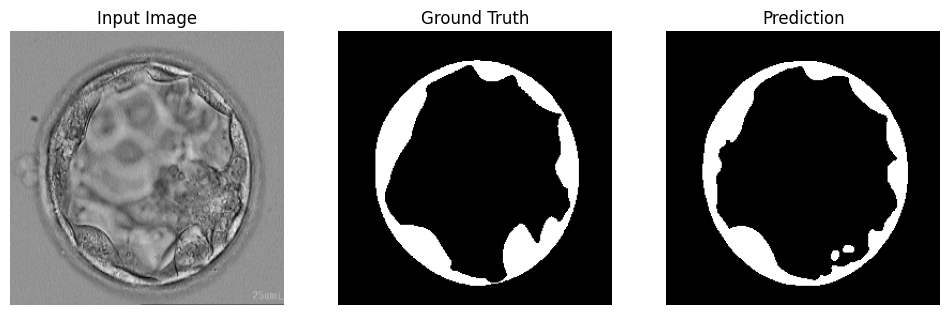

In [17]:
def display_predictions(model, dataset, num_samples=5):
    for batch_idx, (images, masks) in enumerate(dataset.take(num_samples)):
        preds = model.predict(images)
        preds = (preds > 0.5).astype("float32")  # Binarize predictions

        for i in range(len(images)):
            plt.figure(figsize=(12, 4))

            plt.subplot(1, 3, 1)
            plt.title("Input Image")
            plt.imshow(images[i].numpy().squeeze(), cmap="gray")
            plt.axis("off")

            plt.subplot(1, 3, 2)
            plt.title("Ground Truth")
            plt.imshow(masks[i].numpy().squeeze(), cmap="gray")
            plt.axis("off")

            plt.subplot(1, 3, 3)
            plt.title("Prediction")
            plt.imshow(preds[i].squeeze(), cmap="gray")
            plt.axis("off")

            plt.show()


display_predictions(model, test_dataset, num_samples=5)